In [18]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import scanpy as sc
import squidpy as sq
import anndata as ad
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from tqdm.notebook import tqdm
from natsort import natsorted

from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score

In [2]:
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42

In [3]:
import warnings
warnings.filterwarnings('ignore')

## Input

In [4]:
base_path = 'Z:/Data/Analyzed/2024-02-23-Hongyu-Covid_Spleen_replicate_2/'
output_path = os.path.join(base_path, 'output')
expr_path = os.path.join(base_path, 'expr')
fig_path = os.path.join(base_path, "figures")
if not os.path.exists(fig_path):
    os.mkdir(fig_path)

In [5]:
sc.settings.figdir = fig_path
sc.set_figure_params(format='tif', dpi=150)

In [6]:
cdata = sc.read_h5ad(os.path.join(expr_path, f'2024-03-13-combined-APC-bk.h5ad'))
rdata = sc.read_h5ad(os.path.join(expr_path, f'2024-03-13-combined-APC-region123-bk.h5ad'))

In [7]:
raw_cdata = sc.read_h5ad(os.path.join(expr_path, f'combined-raw.h5ad'))

In [8]:
sc.pp.calculate_qc_metrics(raw_cdata, inplace=True, percent_top=None)

In [9]:
raw_cdata = raw_cdata[rdata.obs.index, ]
raw_cdata

View of AnnData object with n_obs × n_vars = 4054102 × 61
    obs: 'sample', 'fov_id', 'volume', 'fov_x', 'fov_y', 'fov_z', 'seg_label', 'global_x', 'global_y', 'global_z', 'condition', 'replicate', 'unique_index', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [10]:
raw_cdata.layers['raw'] = raw_cdata.X.copy()

## Colors

In [56]:
plt.style.use('default')

In [13]:
level_1_order = ['T cells', 'B cells', 'Macrophages', 'Dendritic cells', 'NA']
cdata.obs['level_1'] = cdata.obs['level_1'].astype('category')
cdata.obs['level_1'] = cdata.obs['level_1'].cat.reorder_categories(level_1_order)

rdata.obs['level_1'] = rdata.obs['level_1'].astype('category')
rdata.obs['level_1'] = rdata.obs['level_1'].cat.reorder_categories(level_1_order)

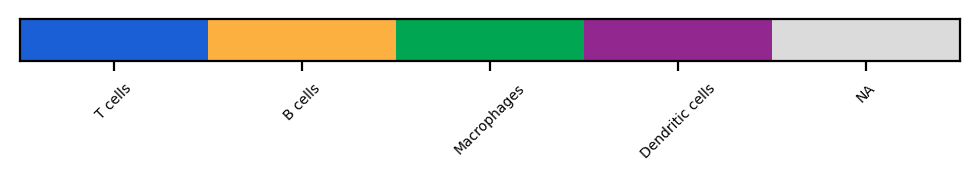

In [15]:
level_1_pl = sns.color_palette(['#1a5fd6', '#FBB040', '#00A651', '#92278F', '#dbdbdb'])
b_cells_pl = sns.color_palette(['#FBB040'])
level_1_cmap = ListedColormap(level_1_pl.as_hex())
sns.palplot(level_1_pl)
plt.xticks(range(len(level_1_order)), level_1_order, size=5, rotation=45)
plt.tight_layout()
plt.savefig(os.path.join(fig_path, 'level_1_palette.pdf'))
plt.show()

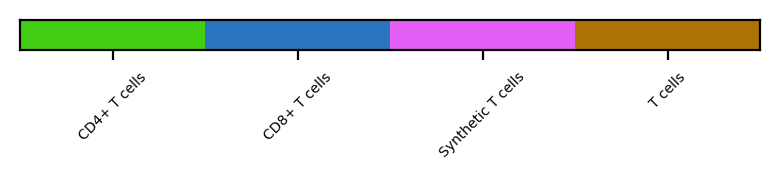

In [18]:
level_2_t_cells_order = ['CD4+ T cells', 'CD8+ T cells', 'Synthetic T cells', 'T cells']
level_2_t_cells_pl = sns.color_palette(['#42cf13', '#2a73bd', '#e45ff5', '#ad7307'])
level_2_t_cells_cmap = ListedColormap(level_2_t_cells_pl.as_hex())
sns.palplot(level_2_t_cells_pl)
plt.xticks(range(len(level_2_t_cells_order)), level_2_t_cells_order, size=5, rotation=45)
plt.tight_layout()
plt.savefig(os.path.join(fig_path, 'level_2_t_cells_palette.pdf'))
plt.show()

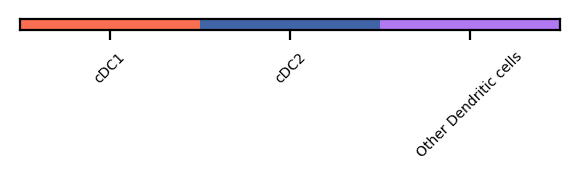

In [20]:
level_2_dc_order = ['cDC1', 'cDC2', 'Other Dendritic cells', ]
level_2_dc_pl = sns.color_palette(['#fa6e52', '#4164a6', '#b079f2'])
level_2_dc_cmap = ListedColormap(level_2_dc_pl.as_hex())
sns.palplot(level_2_dc_pl)
plt.xticks(range(len(level_2_dc_order)), level_2_dc_order, size=5, rotation=45)
plt.tight_layout()
plt.savefig(os.path.join(fig_path, 'level_2_dc_palette.pdf'))
plt.show()

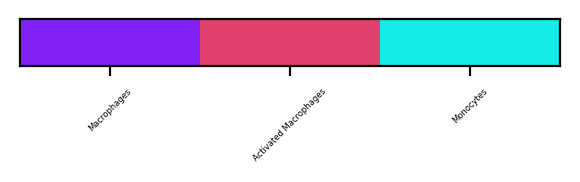

In [21]:
level_2_mc_order = ['Macrophages', 'Activated Macrophages', 'Monocytes']
level_2_mc_pl = sns.color_palette(['#8120f5', '#e0416c', '#13ede6'])
level_2_mc_cmap = ListedColormap(level_2_mc_pl.as_hex())
sns.palplot(level_2_mc_pl)
plt.xticks(range(len(level_2_mc_order)), level_2_mc_order, size=3, rotation=45)
plt.tight_layout()
plt.savefig(os.path.join(fig_path, 'level_2_mc_palette.pdf'))
plt.show()

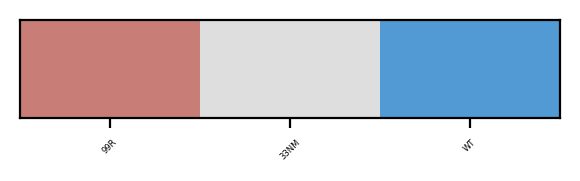

In [22]:
condition_order = ['99R', '33NM', 'WT']
condition_pl = sns.color_palette(['#C87E77', '#DFDEDE', '#519AD4'])
condition_cmap = ListedColormap(condition_pl.as_hex())
sns.palplot(condition_pl)
plt.xticks(range(len(condition_order)), condition_order, size=3, rotation=45)
plt.tight_layout()
plt.savefig(os.path.join(fig_path, 'condition_palette.pdf'))
plt.show()

In [23]:
region_pl = sns.color_palette('tab10', 4)[2:]

## Spatial map

In [24]:
def plot_regional_sct(cdata, rdata, sample, reigon_bd, base_level, type_list, palette, file_name):
    sample_cdata = cdata[cdata.obs['sample'] == sample, ]
    sample_rdata = rdata[rdata.obs['sample'] == sample, ]

    spot_size = 15
    sample_c_pdata = sample_cdata[sample_cdata.obs['global_x'].isin(range(reigon_bd[0], reigon_bd[1])) & sample_cdata.obs['global_y'].isin(range(reigon_bd[2], reigon_bd[3])), ]
    sample_r_pdata = sample_rdata[sample_rdata.obs['global_x'].isin(range(reigon_bd[0], reigon_bd[1])) & sample_rdata.obs['global_y'].isin(range(reigon_bd[2], reigon_bd[3])), ]

    current_complete_obs = sample_c_pdata.obs.copy()
    current_region_obs = sample_r_pdata.obs.copy()
    if type_list:
        current_region_obs = current_region_obs.loc[current_region_obs[base_level].isin(type_list), :]
        current_region_obs[base_level] = current_region_obs[base_level].astype(object)
        current_region_obs[base_level] = current_region_obs[base_level].astype('category')
        # print(current_region_obs[base_level].unique())
        current_region_obs[base_level] = current_region_obs[base_level].cat.reorder_categories(type_list)
    
    fig, ax = plt.subplots(figsize=(5,5))
    sns.scatterplot(x='global_x', y='global_y', data=current_complete_obs, color='#dbdbdb', s=spot_size, linewidth=0, ax=ax, rasterized=True)
    sns.scatterplot(x='global_x', y='global_y', hue=base_level, data=current_region_obs, palette=palette, s=spot_size, linewidth=0, legend=False, ax=ax, rasterized=False, alpha=.8)
    plt.gca().set_aspect('equal')
    plt.axis('off')
    plt.tight_layout()
    plt.savefig(os.path.join(fig_path, file_name), dpi=300)
    plt.show()

In [25]:
sample1_bd = [8000, 12000, 9500, 13750]
sample3_bd = [23500, 27500, 15000, 19000]
sample6_bd = [16250, 19500, 4500, 8400]

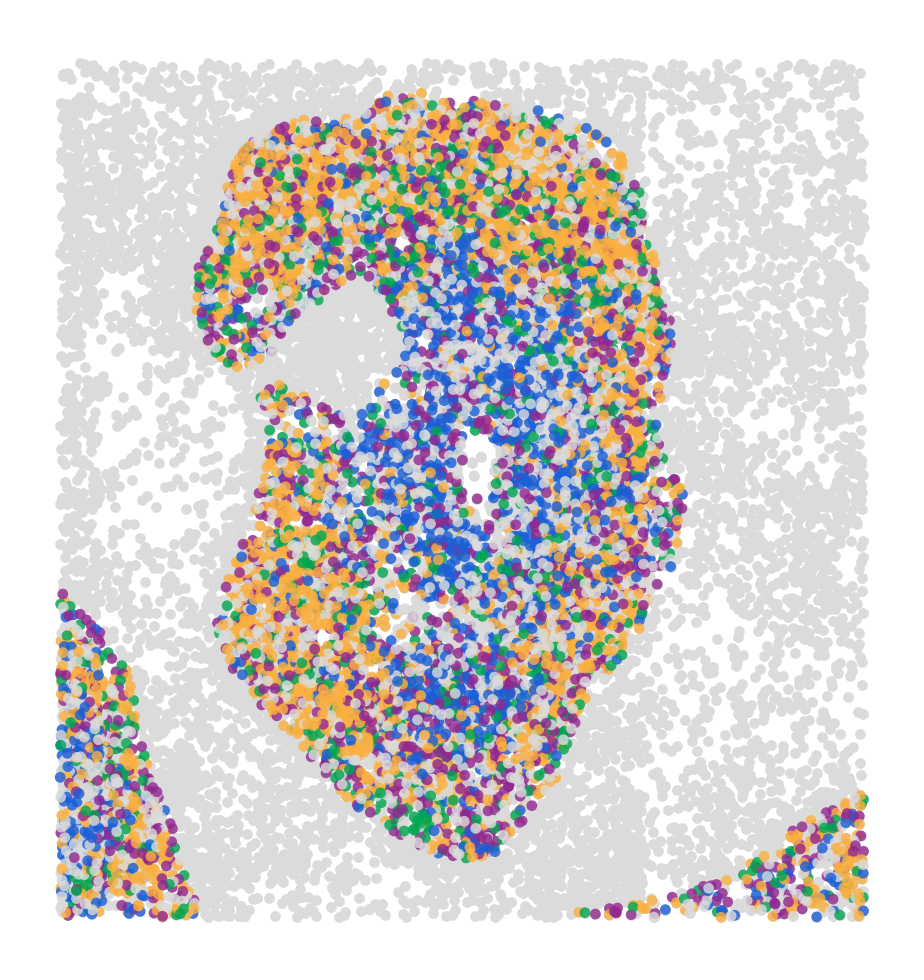

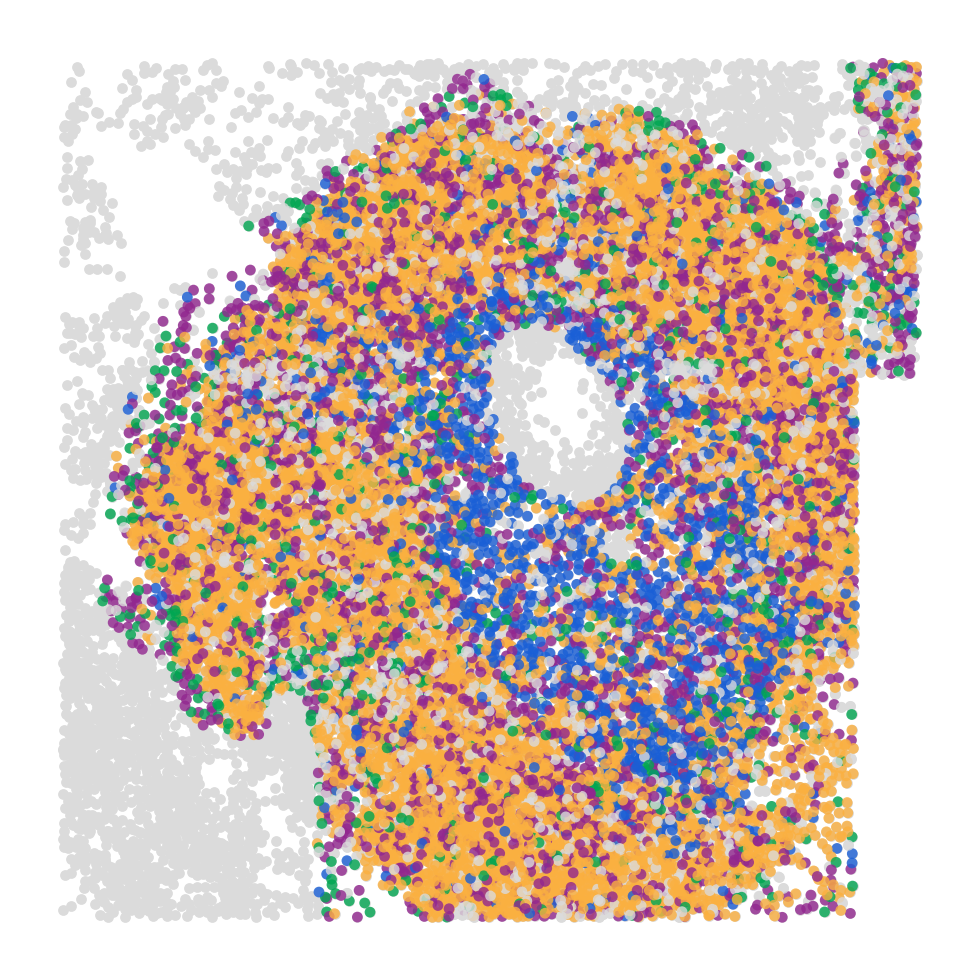

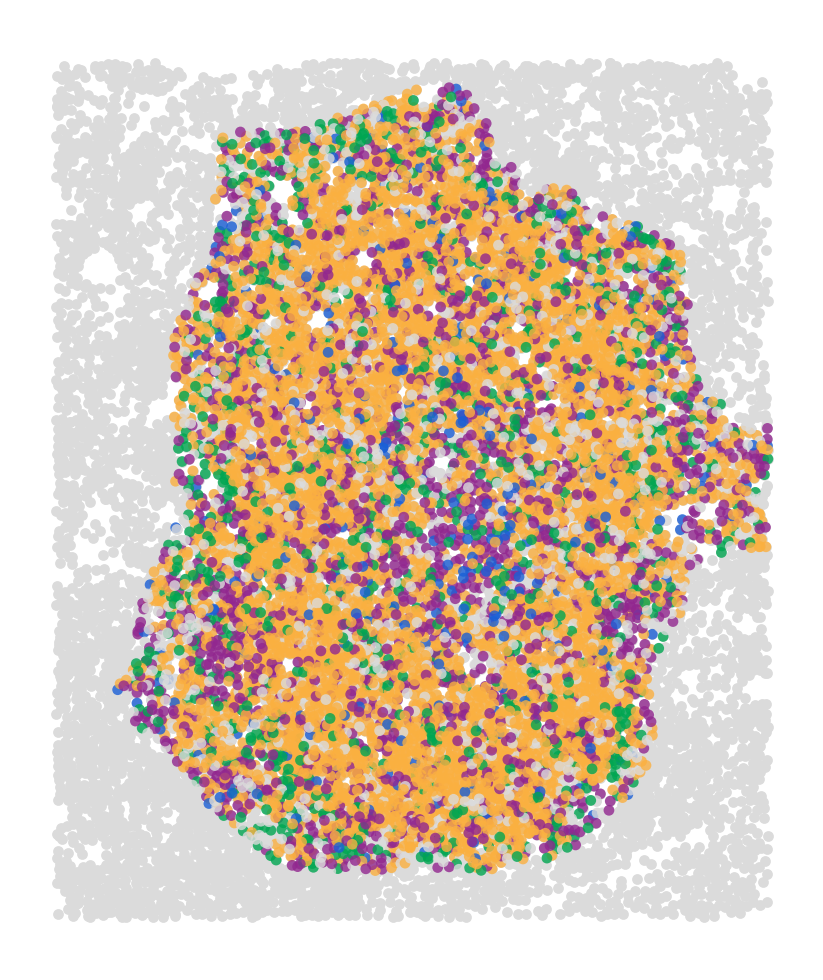

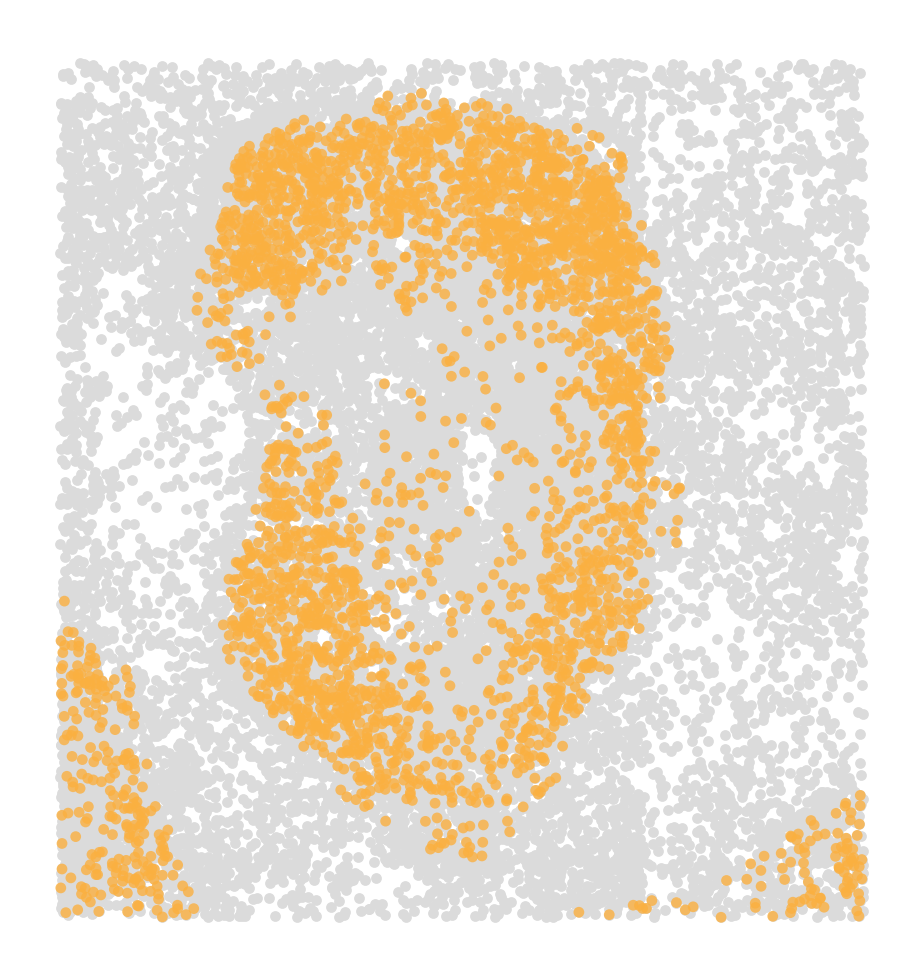

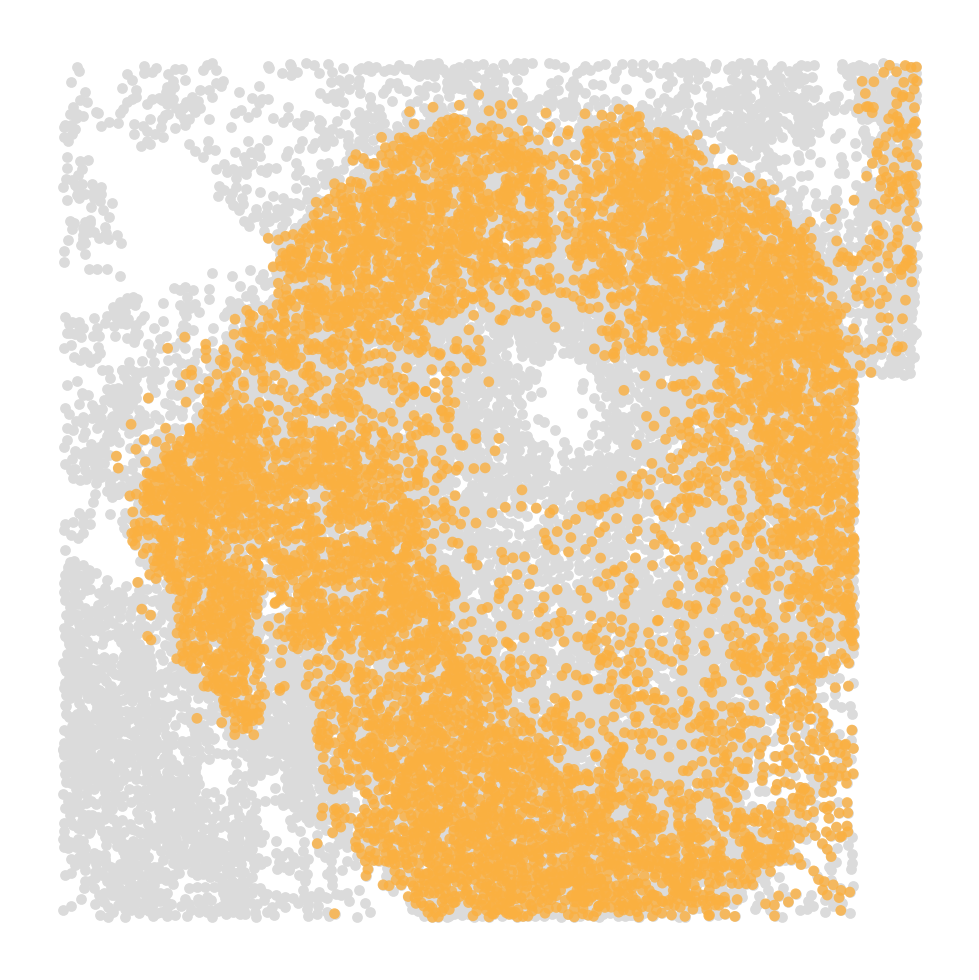

...

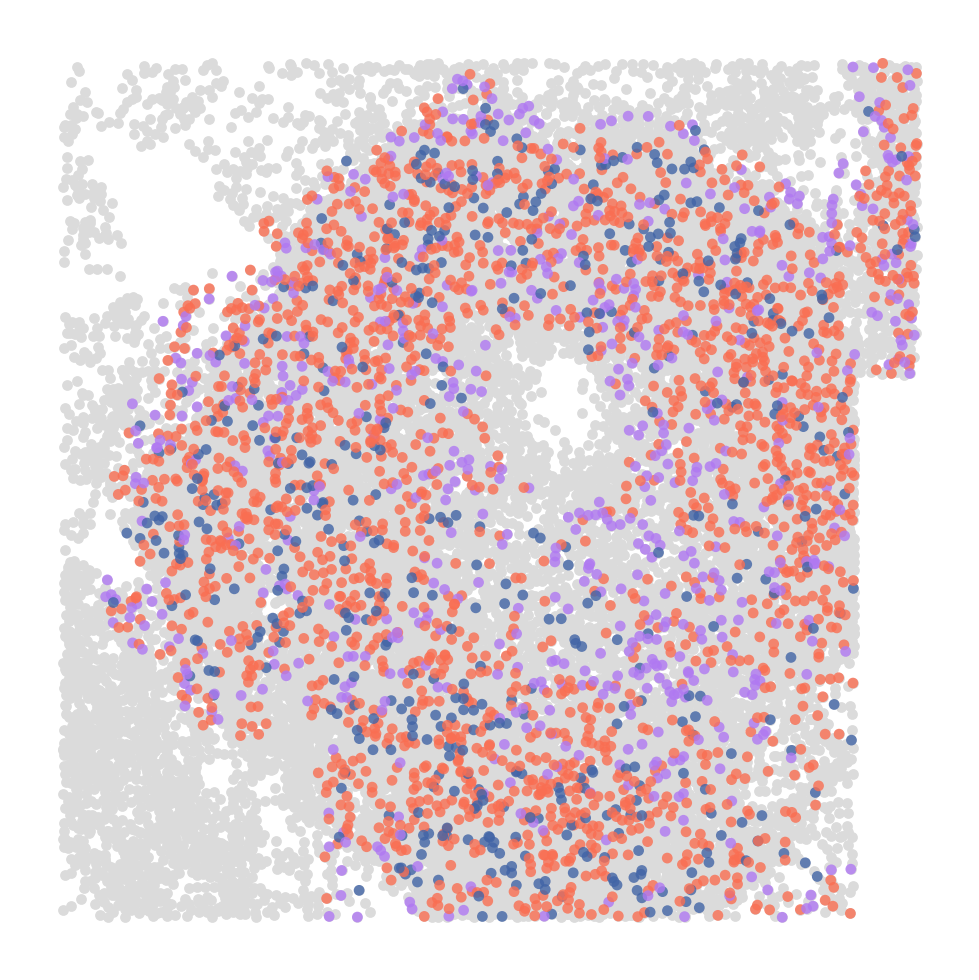

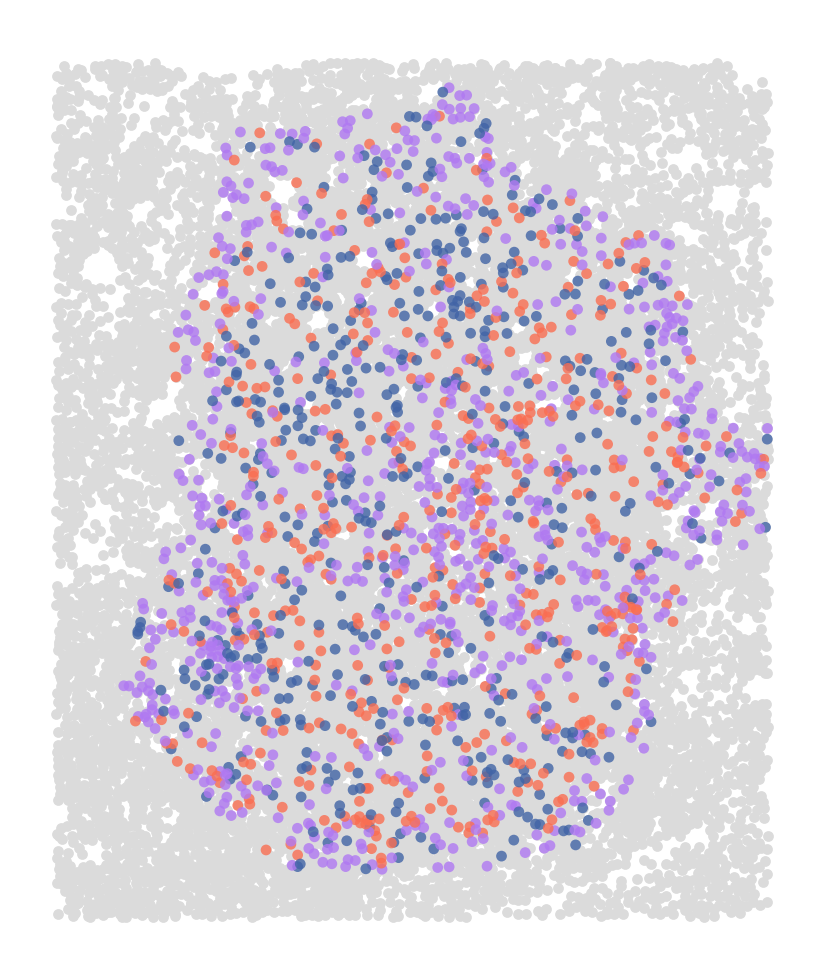

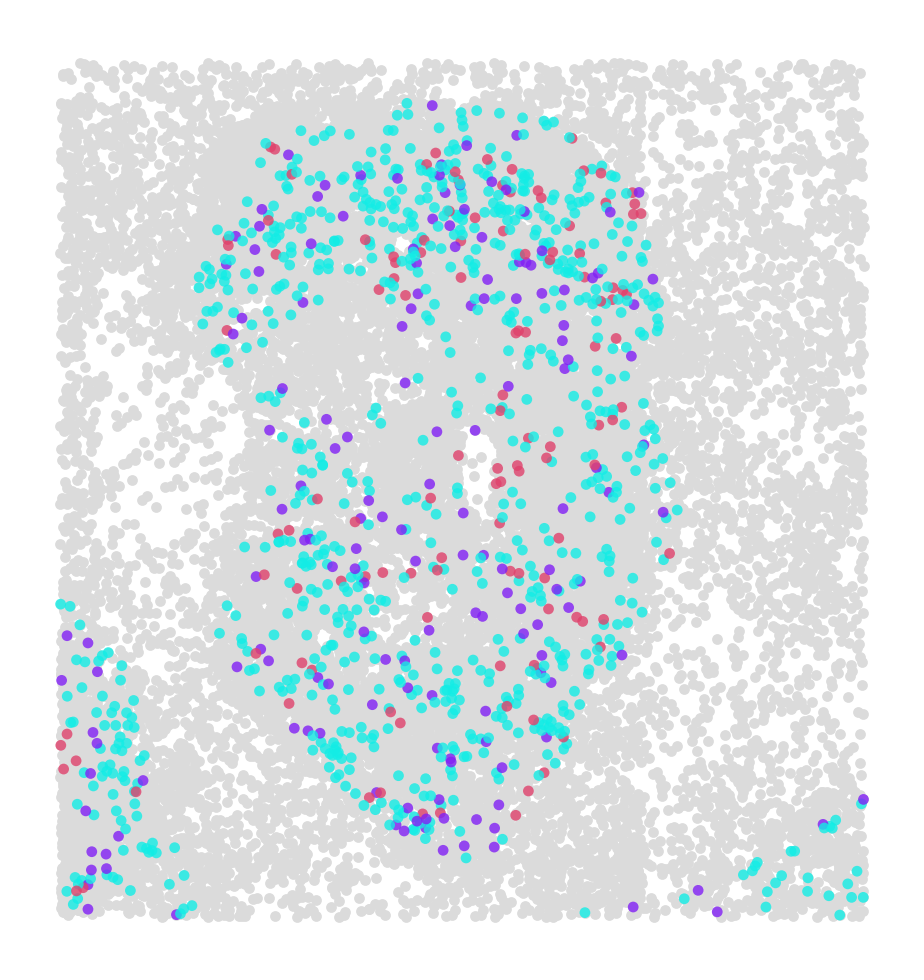

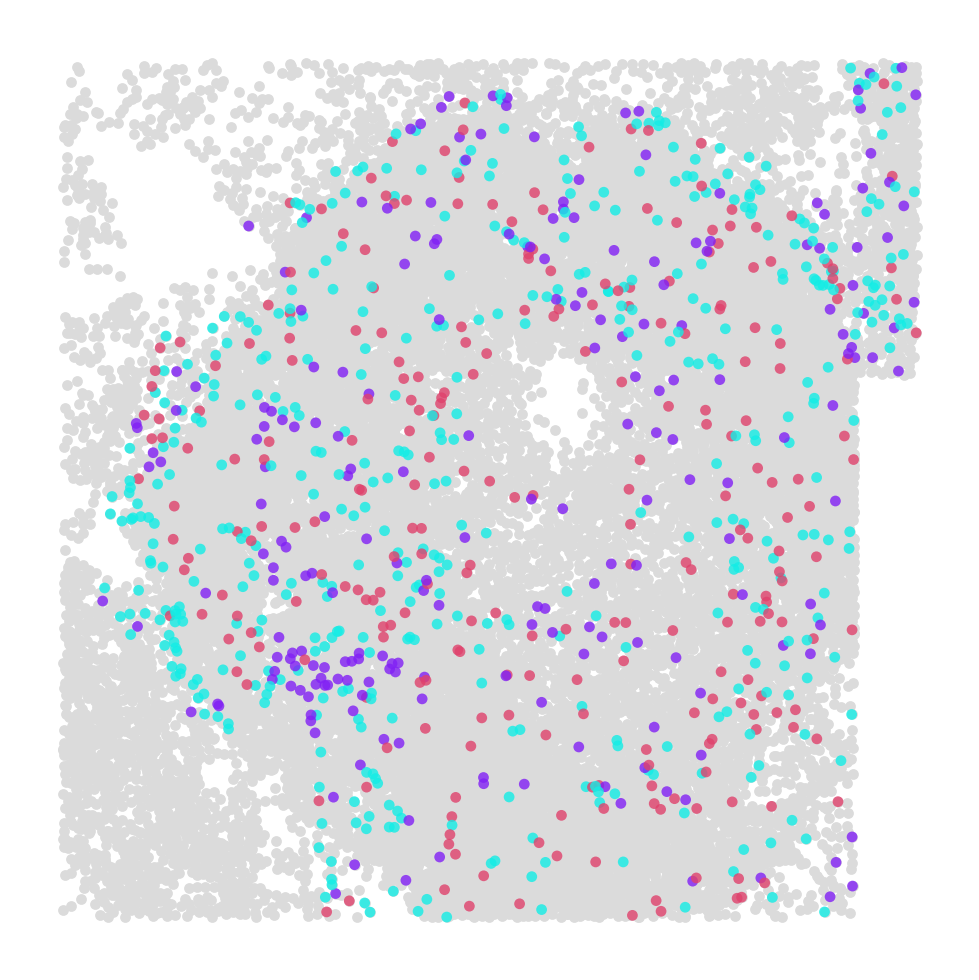

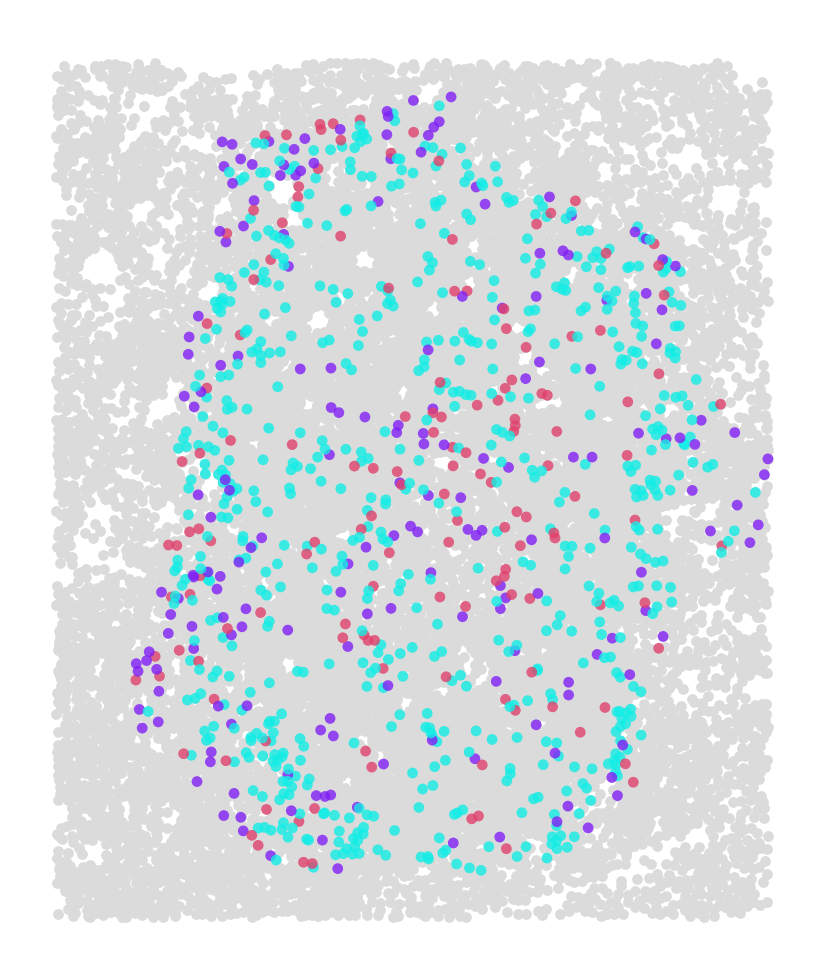

In [28]:
# level1 
plot_regional_sct(cdata, rdata, 'sample1', sample1_bd, 'level_1', [], level_1_pl, 'sct_smaple1_level_1.svg')
plot_regional_sct(cdata, rdata, 'sample3', sample3_bd, 'level_1', [], level_1_pl, 'sct_smaple3_level_1.svg')
plot_regional_sct(cdata, rdata, 'sample6', sample6_bd, 'level_1', [], level_1_pl, 'sct_smaple6_level_1.svg')

# B cells
plot_regional_sct(cdata, rdata, 'sample1', sample1_bd, 'level_1', ['B cells'], b_cells_pl, 'sct_smaple1_b_cells.svg')
plot_regional_sct(cdata, rdata, 'sample3', sample3_bd, 'level_1', ['B cells'], b_cells_pl, 'sct_smaple3_b_cells.svg')
plot_regional_sct(cdata, rdata, 'sample6', sample6_bd, 'level_1', ['B cells'], b_cells_pl, 'sct_smaple6_b_cells.svg')

# T cells 
plot_regional_sct(cdata, rdata, 'sample1', sample1_bd, 'level_2', level_2_t_cells_order, level_2_t_cells_pl, 'sct_smaple1_t_cells.svg')
plot_regional_sct(cdata, rdata, 'sample3', sample3_bd, 'level_2', level_2_t_cells_order, level_2_t_cells_pl, 'sct_smaple3_t_cells.svg')
plot_regional_sct(cdata, rdata, 'sample6', sample6_bd, 'level_2', level_2_t_cells_order, level_2_t_cells_pl, 'sct_smaple6_t_cells.svg')

# DC 
plot_regional_sct(cdata, rdata, 'sample1', sample1_bd, 'level_2', level_2_dc_order, level_2_dc_pl, 'sct_smaple1_dc.svg')
plot_regional_sct(cdata, rdata, 'sample3', sample3_bd, 'level_2', level_2_dc_order, level_2_dc_pl, 'sct_smaple3_dc.svg')
plot_regional_sct(cdata, rdata, 'sample6', sample6_bd, 'level_2', level_2_dc_order, level_2_dc_pl, 'sct_smaple6_dc.svg')

# MC
plot_regional_sct(cdata, rdata, 'sample1', sample1_bd, 'level_2', level_2_mc_order, level_2_mc_pl, 'sct_smaple1_mc.svg')
plot_regional_sct(cdata, rdata, 'sample3', sample3_bd, 'level_2', level_2_mc_order, level_2_mc_pl, 'sct_smaple3_mc.svg')
plot_regional_sct(cdata, rdata, 'sample6', sample6_bd, 'level_2', level_2_mc_order, level_2_mc_pl, 'sct_smaple6_mc.svg')

In [ ]:
for current_sample in cdata.obs['sample'].unique():
    print(current_sample)
    current_complete_obs = cdata.obs.loc[cdata.obs['sample'] == current_sample, :]

    fig_size = np.array([current_complete_obs['global_x'].max(), current_complete_obs['global_y'].max()]) / 1000
    fig, ax = plt.subplots(figsize=fig_size)
    sns.scatterplot(x='global_x', y='global_y', hue='region', data=current_complete_obs, palette='tab10', s=1, linewidth=0, ax=ax)
    plt.gca().set_aspect('equal')
    plt.axis('off')
    plt.tight_layout()
    plt.savefig(os.path.join(fig_path, f"sct_{current_sample}_region.png"), dpi=300)
    plt.show()

In [ ]:
# MC
plot_regional_sct(cdata, rdata, 'sample1', sample1_bd, 'region', [], region_pl, 'sct_smaple1_region_crop.png')
plot_regional_sct(cdata, rdata, 'sample3', sample3_bd, 'region', [], region_pl, 'sct_smaple3_region_crop.png')
plot_regional_sct(cdata, rdata, 'sample6', sample6_bd, 'region', [], region_pl, 'sct_smaple6_region_crop.png')

## Cluster Frequency

In [29]:
def change_width(ax, new_value) :
    for patch in ax.patches :
        current_width = patch.get_width()
        diff = current_width - new_value

        # we change the bar width
        patch.set_width(new_value)

        # we recenter the bar
        patch.set_x(patch.get_x() + diff * .5)

### level 1

In [30]:
pdata = rdata[rdata.obs['level_1'] != 'NA', ]
plot_order = ['T cells', 'B cells', 'Macrophages', 'Dendritic cells']

In [31]:
n_cat = pdata.obs['level_1'].cat.categories.shape[0]
n_fov = pdata.obs['fov_id'].cat.categories.shape[0]
count_df = pd.DataFrame(np.zeros([n_fov, n_cat]), columns=pdata.obs['level_1'].cat.categories)
count_df_index_list = []
cell_dist_list = []
for i, fov in enumerate(pdata.obs['fov_id'].unique()):
    # print(fov)
    curr_cells = (pdata.obs['fov_id'] == fov)
    temp = pdata[curr_cells, :]

    cell_dist = pd.DataFrame(temp.obs['level_1'].value_counts())
    cell_dist['level_1'] = cell_dist.index
    cell_dist['level_1'] = cell_dist['level_1'].astype(object)
    cell_dist = cell_dist.reset_index(drop=True)

    for j in plot_order:
        if j not in cell_dist['level_1'].unique():
            # cell_dist = cell_dist.append({'level_1': j, 'count': 0}, ignore_index=True)
            cell_dist = pd.concat([cell_dist, pd.DataFrame({'level_1': j, 'count': 0}, index=[0])], ignore_index=True)

    cell_dist['level_1'] = cell_dist['level_1'].astype('category')
    cell_dist['level_1'] = cell_dist['level_1'].cat.reorder_categories(plot_order)
    cell_dist['fov_id'] = temp.obs.loc[temp.obs['fov_id'] == fov, 'fov_id'].unique()[0]
    cell_dist['condition'] = temp.obs.loc[temp.obs['fov_id'] == fov, 'condition'].unique()[0]
    cell_dist = cell_dist.reset_index(drop=True)

    # # print(cell_dist.shape)
    cell_dist_list.append(cell_dist)
    
    count_df_index_list.append(temp.obs['condition'].cat.categories[0])
    for j in cell_dist['level_1'].cat.categories:
        count_df.loc[i, j] = cell_dist.loc[cell_dist['level_1'] == j, 'count'].values

count_df['condition'] = count_df_index_list

test_df = pd.concat(cell_dist_list)
test_df = test_df.reset_index(drop=True)
test_df['condition'] = test_df['condition'].astype('category')
test_df['condition'] = test_df['condition'].cat.reorder_categories(condition_order)
test_df['type-group'] = test_df['level_1'].astype(str) + '-' + test_df['condition'].astype(str)
test_df['type-group'] = test_df['type-group'].astype('category')

level_1_condition_order = []

for i in plot_order:
    for j in condition_order:
        level_1_condition_order.append(f"{i}-{j}")

test_df['type-group'] = test_df['type-group'].astype('category')
test_df['type-group'] = test_df['type-group'].cat.reorder_categories(level_1_condition_order)
test_df.to_csv(os.path.join(fig_path, "cluster_frequency_level_1.csv"))

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\seaborn\categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\seaborn\categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\seaborn\categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default 

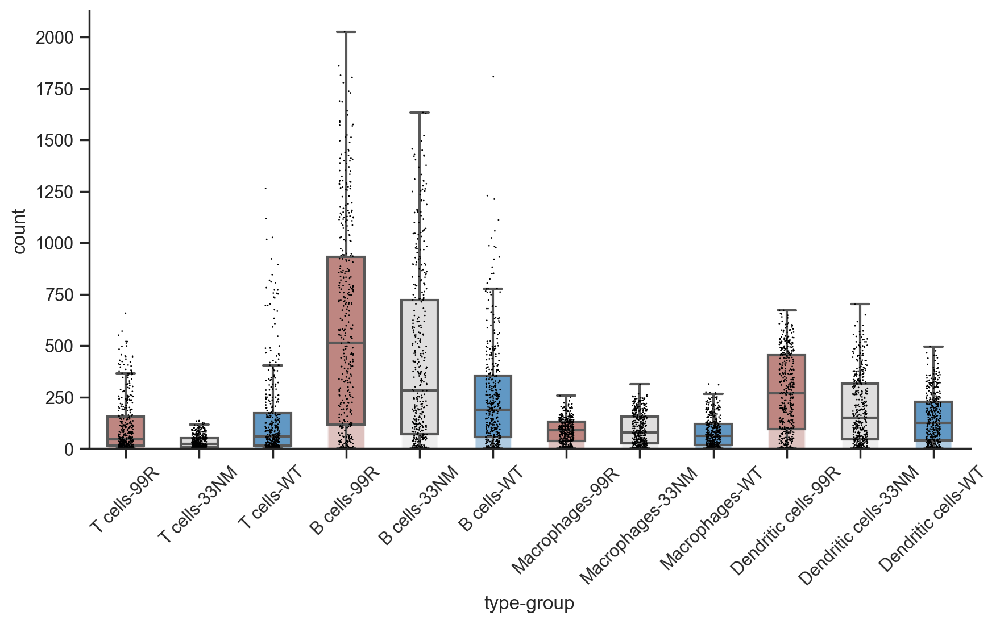

In [35]:
width = .5
sns.set_theme(style="ticks")
f, ax = plt.subplots(figsize=(10, 5))

sns.barplot(y="count", x="type-group", data=test_df, palette=condition_pl, ci=None, alpha=.5, ax=ax, zorder=0,)
change_width(ax, width)
sns.boxplot(y="count", x="type-group", data=test_df, width=width, palette=condition_pl, fliersize=0, ax=ax, zorder=1,)
sns.stripplot(y="count", x="type-group", data=test_df, ax=ax, s=1, color='black', zorder=2)
sns.despine()
plt.legend([],[], frameon=False)
plt.xticks(rotation=45)
plt.savefig(os.path.join(fig_path, "cluster_frequency_level_1.pdf"), dpi=300)
plt.show()

### B cells

In [36]:
pdata = rdata[rdata.obs['level_1'] == 'B cells', ]
plot_order = ['B cells']

In [37]:
n_cat = pdata.obs['level_1'].cat.categories.shape[0]
n_fov = pdata.obs['fov_id'].cat.categories.shape[0]
count_df = pd.DataFrame(np.zeros([n_fov, n_cat]), columns=pdata.obs['level_1'].cat.categories)
count_df_index_list = []
cell_dist_list = []
for i, fov in enumerate(pdata.obs['fov_id'].unique()):
    # print(fov)
    curr_cells = (pdata.obs['fov_id'] == fov)
    temp = pdata[curr_cells, :]

    cell_dist = pd.DataFrame(temp.obs['level_1'].value_counts())
    cell_dist['level_1'] = cell_dist.index
    cell_dist['level_1'] = cell_dist['level_1'].astype(object)
    cell_dist = cell_dist.reset_index(drop=True)

    for j in plot_order:
        if j not in cell_dist['level_1'].unique():
            # cell_dist = cell_dist.append({'level_1': j, 'count': 0}, ignore_index=True)
            cell_dist = pd.concat([cell_dist, pd.DataFrame({'level_1': j, 'count': 0}, index=[0])], ignore_index=True)

    cell_dist['level_1'] = cell_dist['level_1'].astype('category')
    cell_dist['level_1'] = cell_dist['level_1'].cat.reorder_categories(plot_order)
    cell_dist['fov_id'] = temp.obs.loc[temp.obs['fov_id'] == fov, 'fov_id'].unique()[0]
    cell_dist['condition'] = temp.obs.loc[temp.obs['fov_id'] == fov, 'condition'].unique()[0]
    cell_dist = cell_dist.reset_index(drop=True)

    # # print(cell_dist.shape)
    cell_dist_list.append(cell_dist)
    
    count_df_index_list.append(temp.obs['condition'].cat.categories[0])
    for j in cell_dist['level_1'].cat.categories:
        count_df.loc[i, j] = cell_dist.loc[cell_dist['level_1'] == j, 'count'].values

count_df['condition'] = count_df_index_list

test_df = pd.concat(cell_dist_list)
test_df = test_df.reset_index(drop=True)
test_df['condition'] = test_df['condition'].astype('category')
test_df['condition'] = test_df['condition'].cat.reorder_categories(condition_order)
test_df['type-group'] = test_df['level_1'].astype(str) + '-' + test_df['condition'].astype(str)
test_df['type-group'] = test_df['type-group'].astype('category')

level_1_condition_order = []

for i in plot_order:
    for j in condition_order:
        level_1_condition_order.append(f"{i}-{j}")

test_df['type-group'] = test_df['type-group'].astype('category')
test_df['type-group'] = test_df['type-group'].cat.reorder_categories(level_1_condition_order)
test_df.to_csv(os.path.join(fig_path, "cluster_frequency_b_cells.csv"))

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\seaborn\categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\seaborn\categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\seaborn\categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default 

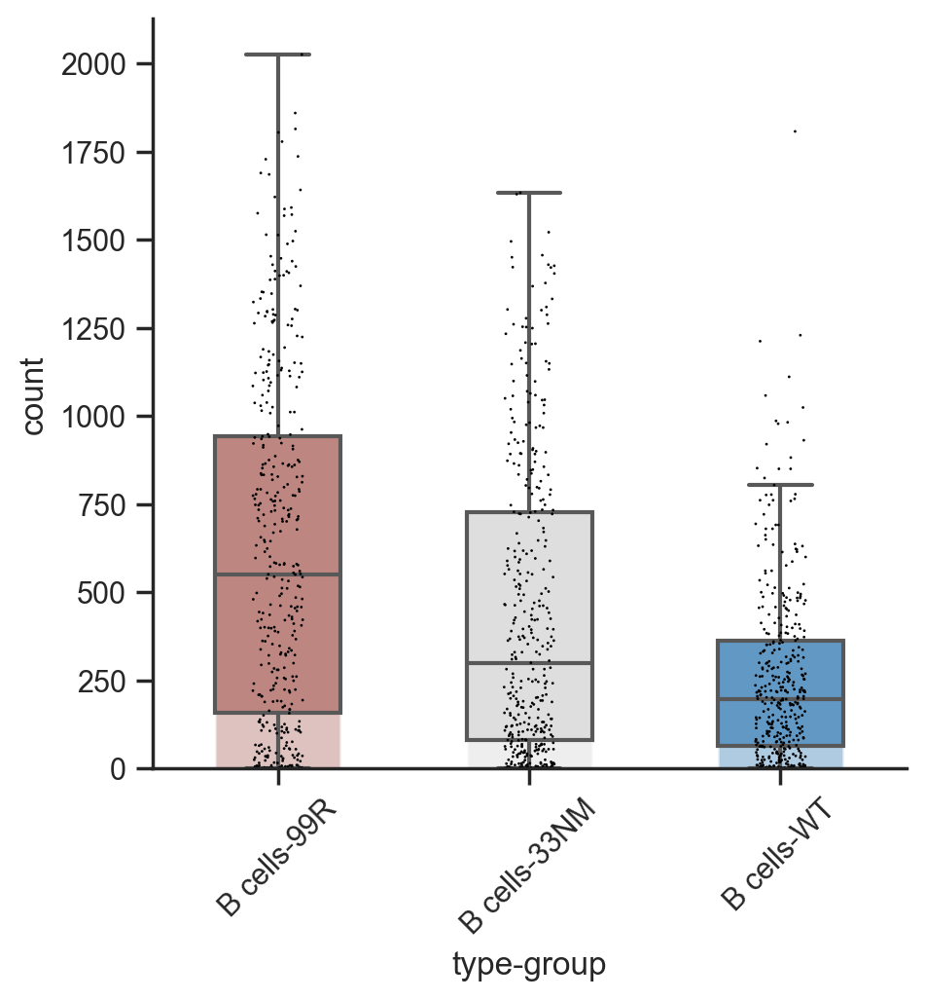

In [38]:
width = .5
sns.set_theme(style="ticks")
f, ax = plt.subplots(figsize=(5, 5))

sns.barplot(y="count", x="type-group", data=test_df, palette=condition_pl, ci=None, alpha=.5, ax=ax, zorder=0,)
change_width(ax, width)
sns.boxplot(y="count", x="type-group", data=test_df, width=width, palette=condition_pl, fliersize=0, ax=ax, zorder=1,)
sns.stripplot(y="count", x="type-group", data=test_df, ax=ax, s=1, color='black', zorder=2)
sns.despine()
plt.legend([],[], frameon=False)
plt.xticks(rotation=45)
plt.savefig(os.path.join(fig_path, "cluster_frequency_b_cells.pdf"), dpi=300)
plt.show()

### T cells

In [39]:
pdata = rdata[rdata.obs['level_2'].isin(level_2_t_cells_order), ]
plot_order = level_2_t_cells_order

In [40]:
n_cat = pdata.obs['level_2'].cat.categories.shape[0]
n_fov = pdata.obs['fov_id'].cat.categories.shape[0]
count_df = pd.DataFrame(np.zeros([n_fov, n_cat]), columns=pdata.obs['level_2'].cat.categories)
count_df_index_list = []
cell_dist_list = []
for i, fov in enumerate(pdata.obs['fov_id'].unique()):
    # print(fov)
    curr_cells = (pdata.obs['fov_id'] == fov)
    temp = pdata[curr_cells, :]

    cell_dist = pd.DataFrame(temp.obs['level_2'].value_counts())
    cell_dist['level_2'] = cell_dist.index
    cell_dist['level_2'] = cell_dist['level_2'].astype(object)
    cell_dist = cell_dist.reset_index(drop=True)

    for j in plot_order:
        if j not in cell_dist['level_2'].unique():
            # cell_dist = cell_dist.append({'level_1': j, 'count': 0}, ignore_index=True)
            cell_dist = pd.concat([cell_dist, pd.DataFrame({'level_2': j, 'count': 0}, index=[0])], ignore_index=True)

    cell_dist['level_2'] = cell_dist['level_2'].astype('category')
    cell_dist['level_2'] = cell_dist['level_2'].cat.reorder_categories(plot_order)
    cell_dist['fov_id'] = temp.obs.loc[temp.obs['fov_id'] == fov, 'fov_id'].unique()[0]
    cell_dist['condition'] = temp.obs.loc[temp.obs['fov_id'] == fov, 'condition'].unique()[0]
    cell_dist = cell_dist.reset_index(drop=True)

    # # print(cell_dist.shape)
    cell_dist_list.append(cell_dist)
    
    count_df_index_list.append(temp.obs['condition'].cat.categories[0])
    for j in cell_dist['level_2'].cat.categories:
        count_df.loc[i, j] = cell_dist.loc[cell_dist['level_2'] == j, 'count'].values

count_df['condition'] = count_df_index_list

test_df = pd.concat(cell_dist_list)
test_df = test_df.reset_index(drop=True)
test_df['condition'] = test_df['condition'].astype('category')
test_df['condition'] = test_df['condition'].cat.reorder_categories(condition_order)
test_df['type-group'] = test_df['level_2'].astype(str) + '-' + test_df['condition'].astype(str)
test_df['type-group'] = test_df['type-group'].astype('category')

level_1_condition_order = []

for i in plot_order:
    for j in condition_order:
        level_1_condition_order.append(f"{i}-{j}")

test_df['type-group'] = test_df['type-group'].astype('category')
test_df['type-group'] = test_df['type-group'].cat.reorder_categories(level_1_condition_order)
test_df.to_csv(os.path.join(fig_path, "cluster_frequency_t_cells.csv"))

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\seaborn\categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\seaborn\categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\seaborn\categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default 

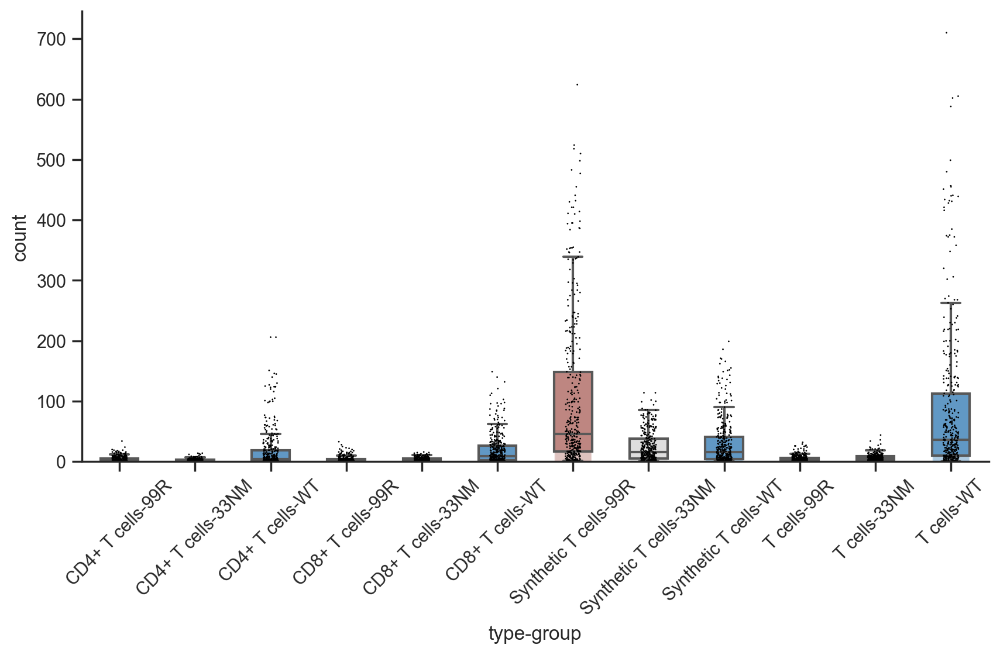

In [41]:
width = .5
sns.set_theme(style="ticks")
f, ax = plt.subplots(figsize=(10, 5))

sns.barplot(y="count", x="type-group", data=test_df, palette=condition_pl, ci=None, alpha=.5, ax=ax, zorder=0,)
change_width(ax, width)
sns.boxplot(y="count", x="type-group", data=test_df, width=width, palette=condition_pl, fliersize=0, ax=ax, zorder=1,)
sns.stripplot(y="count", x="type-group", data=test_df, ax=ax, s=1, color='black', zorder=2)
sns.despine()
# plt.ylim(0, 400)
plt.legend([],[], frameon=False)
plt.xticks(rotation=45)
plt.savefig(os.path.join(fig_path, "cluster_frequency_t_cells.pdf"), dpi=300)
plt.show()

### DC

In [42]:
pdata = rdata[rdata.obs['level_2'].isin(level_2_dc_order), ]
plot_order = level_2_dc_order

In [43]:
n_cat = pdata.obs['level_2'].cat.categories.shape[0]
n_fov = pdata.obs['fov_id'].cat.categories.shape[0]
count_df = pd.DataFrame(np.zeros([n_fov, n_cat]), columns=pdata.obs['level_2'].cat.categories)
count_df_index_list = []
cell_dist_list = []
for i, fov in enumerate(pdata.obs['fov_id'].unique()):
    # print(fov)
    curr_cells = (pdata.obs['fov_id'] == fov)
    temp = pdata[curr_cells, :]

    cell_dist = pd.DataFrame(temp.obs['level_2'].value_counts())
    cell_dist['level_2'] = cell_dist.index
    cell_dist['level_2'] = cell_dist['level_2'].astype(object)
    cell_dist = cell_dist.reset_index(drop=True)

    for j in plot_order:
        if j not in cell_dist['level_2'].unique():
            # cell_dist = cell_dist.append({'level_1': j, 'count': 0}, ignore_index=True)
            cell_dist = pd.concat([cell_dist, pd.DataFrame({'level_2': j, 'count': 0}, index=[0])], ignore_index=True)

    cell_dist['level_2'] = cell_dist['level_2'].astype('category')
    cell_dist['level_2'] = cell_dist['level_2'].cat.reorder_categories(plot_order)
    cell_dist['fov_id'] = temp.obs.loc[temp.obs['fov_id'] == fov, 'fov_id'].unique()[0]
    cell_dist['condition'] = temp.obs.loc[temp.obs['fov_id'] == fov, 'condition'].unique()[0]
    cell_dist = cell_dist.reset_index(drop=True)

    # # print(cell_dist.shape)
    cell_dist_list.append(cell_dist)
    
    count_df_index_list.append(temp.obs['condition'].cat.categories[0])
    for j in cell_dist['level_2'].cat.categories:
        count_df.loc[i, j] = cell_dist.loc[cell_dist['level_2'] == j, 'count'].values

count_df['condition'] = count_df_index_list

test_df = pd.concat(cell_dist_list)
test_df = test_df.reset_index(drop=True)
test_df['condition'] = test_df['condition'].astype('category')
test_df['condition'] = test_df['condition'].cat.reorder_categories(condition_order)
test_df['type-group'] = test_df['level_2'].astype(str) + '-' + test_df['condition'].astype(str)
test_df['type-group'] = test_df['type-group'].astype('category')

level_1_condition_order = []

for i in plot_order:
    for j in condition_order:
        level_1_condition_order.append(f"{i}-{j}")

test_df['type-group'] = test_df['type-group'].astype('category')
test_df['type-group'] = test_df['type-group'].cat.reorder_categories(level_1_condition_order)
test_df.to_csv(os.path.join(fig_path, "cluster_frequency_dc.csv"))

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\seaborn\categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\seaborn\categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\seaborn\categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default 

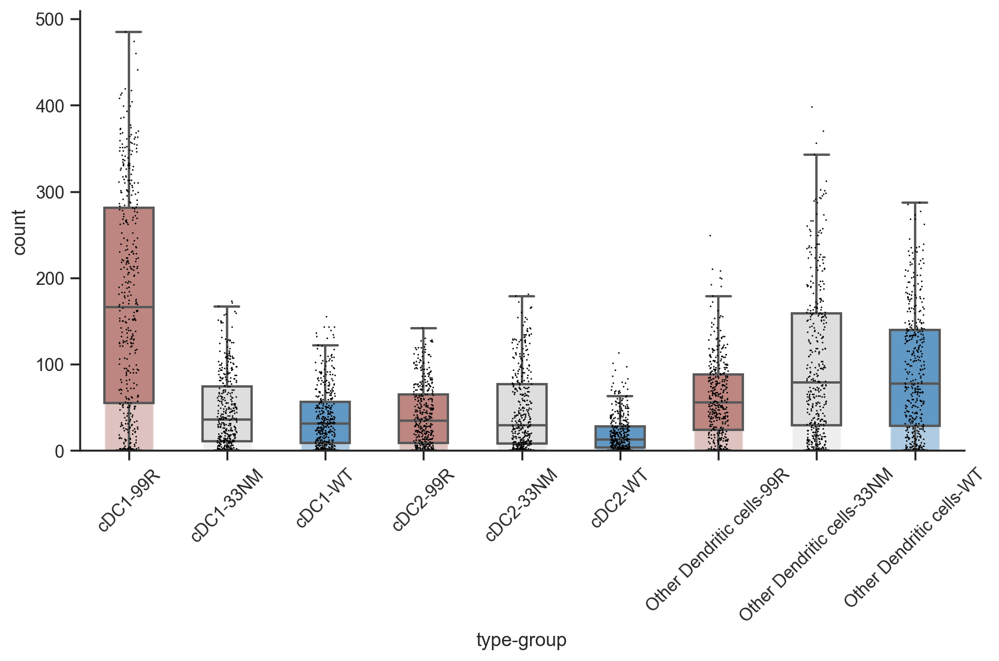

In [44]:
width = .5
sns.set_theme(style="ticks")
f, ax = plt.subplots(figsize=(10, 5))

sns.barplot(y="count", x="type-group", data=test_df, palette=condition_pl, ci=None, alpha=.5, ax=ax, zorder=0,)
change_width(ax, width)
sns.boxplot(y="count", x="type-group", data=test_df, width=width, palette=condition_pl, fliersize=0, ax=ax, zorder=1,)
sns.stripplot(y="count", x="type-group", data=test_df, ax=ax, s=1, color='black', zorder=2)
sns.despine()
# plt.ylim(0, 400)
plt.legend([],[], frameon=False)
plt.xticks(rotation=45)
plt.savefig(os.path.join(fig_path, "cluster_frequency_dc.pdf"), dpi=300)
plt.show()

### MC

In [45]:
pdata = rdata[rdata.obs['level_2'].isin(level_2_mc_order), ]
plot_order = level_2_mc_order

In [46]:
n_cat = pdata.obs['level_2'].cat.categories.shape[0]
n_fov = pdata.obs['fov_id'].cat.categories.shape[0]
count_df = pd.DataFrame(np.zeros([n_fov, n_cat]), columns=pdata.obs['level_2'].cat.categories)
count_df_index_list = []
cell_dist_list = []
for i, fov in enumerate(pdata.obs['fov_id'].unique()):
    # print(fov)
    curr_cells = (pdata.obs['fov_id'] == fov)
    temp = pdata[curr_cells, :]

    cell_dist = pd.DataFrame(temp.obs['level_2'].value_counts())
    cell_dist['level_2'] = cell_dist.index
    cell_dist['level_2'] = cell_dist['level_2'].astype(object)
    cell_dist = cell_dist.reset_index(drop=True)

    for j in plot_order:
        if j not in cell_dist['level_2'].unique():
            # cell_dist = cell_dist.append({'level_1': j, 'count': 0}, ignore_index=True)
            cell_dist = pd.concat([cell_dist, pd.DataFrame({'level_2': j, 'count': 0}, index=[0])], ignore_index=True)

    cell_dist['level_2'] = cell_dist['level_2'].astype('category')
    cell_dist['level_2'] = cell_dist['level_2'].cat.reorder_categories(plot_order)
    cell_dist['fov_id'] = temp.obs.loc[temp.obs['fov_id'] == fov, 'fov_id'].unique()[0]
    cell_dist['condition'] = temp.obs.loc[temp.obs['fov_id'] == fov, 'condition'].unique()[0]
    cell_dist = cell_dist.reset_index(drop=True)

    # # print(cell_dist.shape)
    cell_dist_list.append(cell_dist)
    
    count_df_index_list.append(temp.obs['condition'].cat.categories[0])
    for j in cell_dist['level_2'].cat.categories:
        count_df.loc[i, j] = cell_dist.loc[cell_dist['level_2'] == j, 'count'].values

count_df['condition'] = count_df_index_list

test_df = pd.concat(cell_dist_list)
test_df = test_df.reset_index(drop=True)
test_df['condition'] = test_df['condition'].astype('category')
test_df['condition'] = test_df['condition'].cat.reorder_categories(condition_order)
test_df['type-group'] = test_df['level_2'].astype(str) + '-' + test_df['condition'].astype(str)
test_df['type-group'] = test_df['type-group'].astype('category')

level_1_condition_order = []

for i in plot_order:
    for j in condition_order:
        level_1_condition_order.append(f"{i}-{j}")

test_df['type-group'] = test_df['type-group'].astype('category')
test_df['type-group'] = test_df['type-group'].cat.reorder_categories(level_1_condition_order)
test_df.to_csv(os.path.join(fig_path, "cluster_frequency_mc.csv"))

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\seaborn\categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\seaborn\categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\seaborn\categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default 

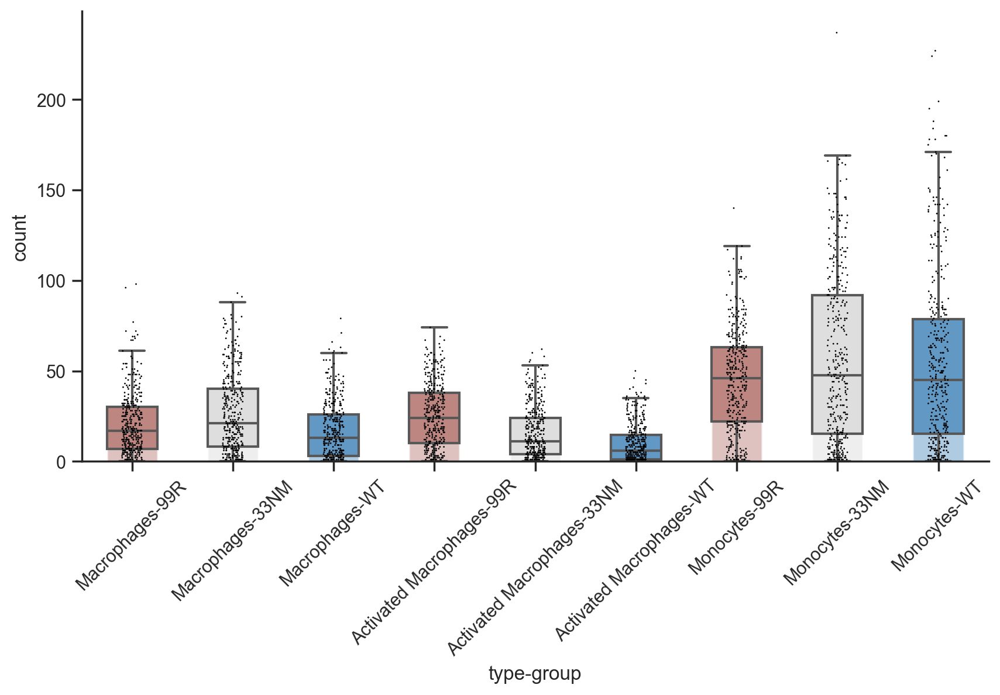

In [47]:
width = .5
sns.set_theme(style="ticks")
f, ax = plt.subplots(figsize=(10, 5))

sns.barplot(y="count", x="type-group", data=test_df, palette=condition_pl, ci=None, alpha=.5, ax=ax, zorder=0,)
change_width(ax, width)
sns.boxplot(y="count", x="type-group", data=test_df, width=width, palette=condition_pl, fliersize=0, ax=ax, zorder=1,)
sns.stripplot(y="count", x="type-group", data=test_df, ax=ax, s=1, color='black', zorder=2)
sns.despine()
# plt.ylim(0, 400)
plt.legend([],[], frameon=False)
plt.xticks(rotation=45)
plt.savefig(os.path.join(fig_path, "cluster_frequency_mc.pdf"), dpi=300)
plt.show()

### Naive T cells acorss condition

In [176]:
current_order = ['Naive CD4+ T cells', 'Naive CD8+ T cells']
pdata = rdata[rdata.obs['level_3'].isin(current_order), ]
plot_order = current_order

In [178]:
n_cat = pdata.obs['level_3'].cat.categories.shape[0]
n_fov = pdata.obs['fov_id'].cat.categories.shape[0]
count_df = pd.DataFrame(np.zeros([n_fov, n_cat]), columns=pdata.obs['level_3'].cat.categories)
count_df_index_list = []
cell_dist_list = []
for i, fov in enumerate(pdata.obs['fov_id'].unique()):
    # print(fov)
    curr_cells = (pdata.obs['fov_id'] == fov)
    temp = pdata[curr_cells, :]

    cell_dist = pd.DataFrame(temp.obs['level_3'].value_counts())
    cell_dist['level_3'] = cell_dist.index
    cell_dist['level_3'] = cell_dist['level_3'].astype(object)
    cell_dist = cell_dist.reset_index(drop=True)

    for j in plot_order:
        if j not in cell_dist['level_3'].unique():
            # cell_dist = cell_dist.append({'level_1': j, 'count': 0}, ignore_index=True)
            cell_dist = pd.concat([cell_dist, pd.DataFrame({'level_3': j, 'count': 0}, index=[0])], ignore_index=True)

    cell_dist['level_3'] = cell_dist['level_3'].astype('category')
    cell_dist['level_3'] = cell_dist['level_3'].cat.reorder_categories(plot_order)
    cell_dist['fov_id'] = temp.obs.loc[temp.obs['fov_id'] == fov, 'fov_id'].unique()[0]
    cell_dist['condition'] = temp.obs.loc[temp.obs['fov_id'] == fov, 'condition'].unique()[0]
    cell_dist = cell_dist.reset_index(drop=True)

    # # print(cell_dist.shape)
    cell_dist_list.append(cell_dist)
    
    count_df_index_list.append(temp.obs['condition'].cat.categories[0])
    for j in cell_dist['level_3'].cat.categories:
        count_df.loc[i, j] = cell_dist.loc[cell_dist['level_3'] == j, 'count'].values

count_df['condition'] = count_df_index_list

test_df = pd.concat(cell_dist_list)
test_df = test_df.reset_index(drop=True)
test_df['condition'] = test_df['condition'].astype('category')
test_df['condition'] = test_df['condition'].cat.reorder_categories(condition_order)
test_df['type-group'] = test_df['level_3'].astype(str) + '-' + test_df['condition'].astype(str)
test_df['type-group'] = test_df['type-group'].astype('category')

level_1_condition_order = []

for i in plot_order:
    for j in condition_order:
        level_1_condition_order.append(f"{i}-{j}")

test_df['type-group'] = test_df['type-group'].astype('category')
test_df['type-group'] = test_df['type-group'].cat.reorder_categories(level_1_condition_order)
test_df.to_csv(os.path.join(fig_path, "cluster_frequency_naive_t_cells.csv"))

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\seaborn\categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\seaborn\categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_vals = vals.groupby(grouper)
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\seaborn\categorical.py:253: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default 

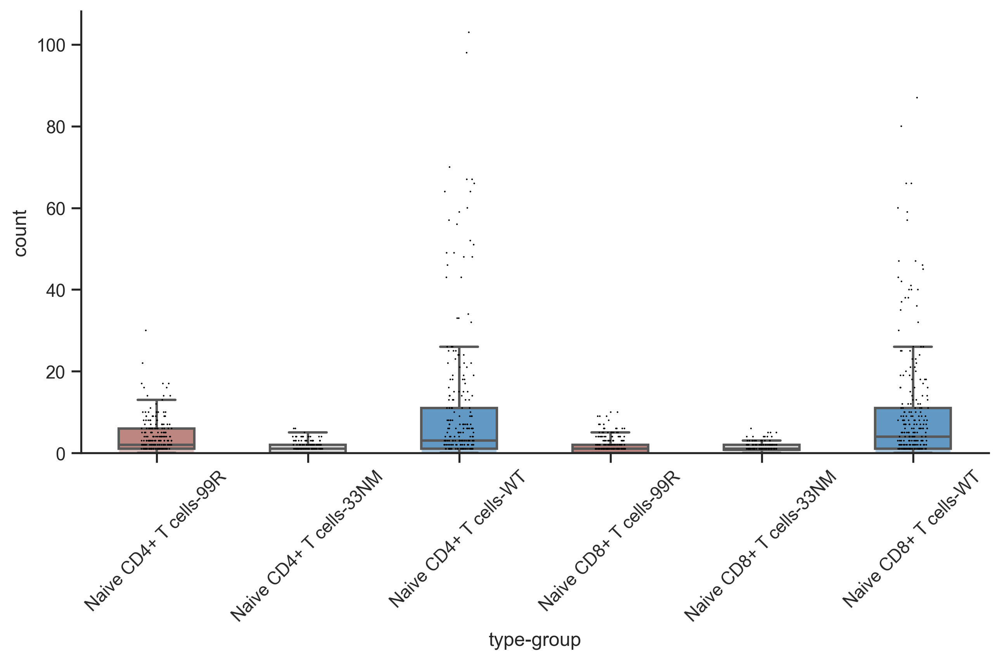

In [179]:
width = .5
sns.set_theme(style="ticks")
f, ax = plt.subplots(figsize=(10, 5))

sns.barplot(y="count", x="type-group", data=test_df, palette=condition_pl, ci=None, alpha=.5, ax=ax, zorder=0,)
change_width(ax, width)
sns.boxplot(y="count", x="type-group", data=test_df, width=width, palette=condition_pl, fliersize=0, ax=ax, zorder=1,)
sns.stripplot(y="count", x="type-group", data=test_df, ax=ax, s=1, color='black', zorder=2)
sns.despine()
# plt.ylim(0, 400)
plt.legend([],[], frameon=False)
plt.xticks(rotation=45)
plt.savefig(os.path.join(fig_path, "cluster_frequency_naive_t_cells.pdf"), dpi=300)
plt.show()

## Heatmap

In [15]:
sc.settings.figdir = fig_path
sc.set_figure_params(format='pdf', dpi=150)

### level 1

In [16]:
pdata = rdata[rdata.obs['level_1'] != 'NA', ]

In [50]:
level_1_gene_dict = {
 'T cells': ['Cd3d', 'Cd3e', 'Cd3g'],
 'B cells': ['Cd19', 'Cd22', 'Cd40', 'Cd79a', 'Ms4a1'],
 'Macrophages': ['Adgre1', 'Cd68', 'Csf1r', 'Itgam', 'Lyz2'],
 'Dendritic cells': ['Irf4', 'Irf8', 'Itgax', 'Sirpa', 'Xcr1'],
 'NK cells': ['Ccl5', 'Gzma', 'Nkg7', 'Ptprc'],
 'Endothelial cells': ['Cdh5', 'Lrg1', 'Ly6a', 'Pecam1'],
}

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


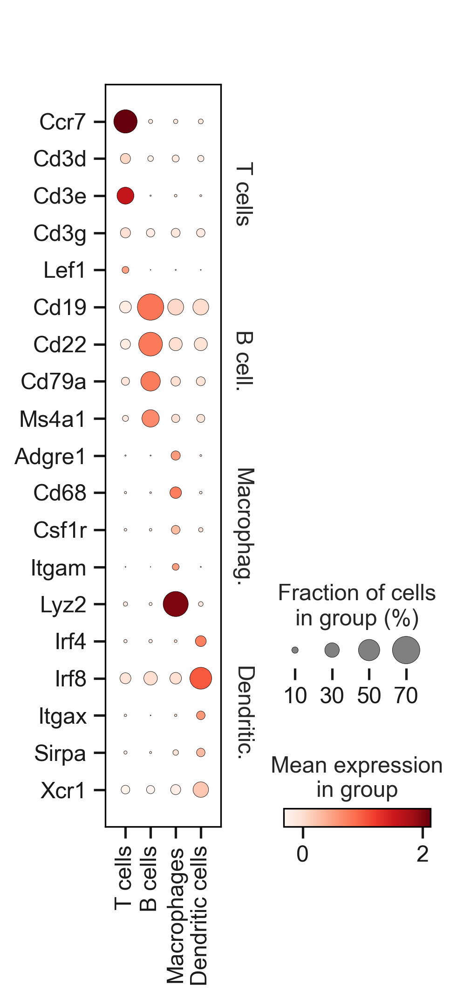

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


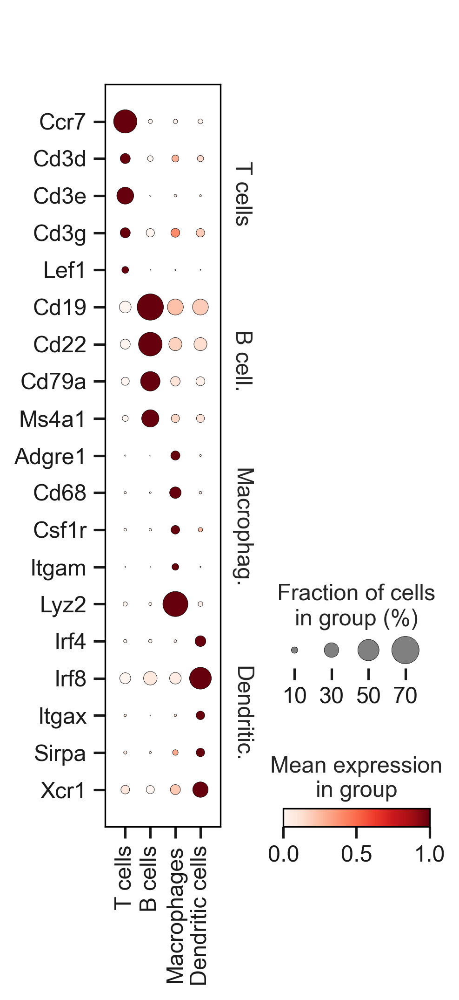

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


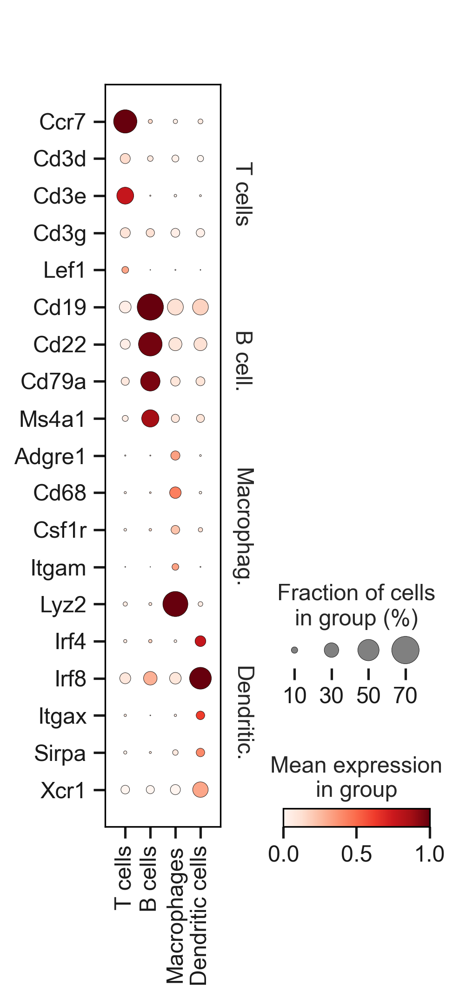

In [51]:
sc.pl.dotplot(pdata, level_1_gene_dict, groupby=f'level_1', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, save='level_1')
sc.pl.dotplot(pdata, level_1_gene_dict, groupby=f'level_1', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, standard_scale='var', save='level_1_var')
sc.pl.dotplot(pdata, level_1_gene_dict, groupby=f'level_1', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, standard_scale='group', save='level_1_group')

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


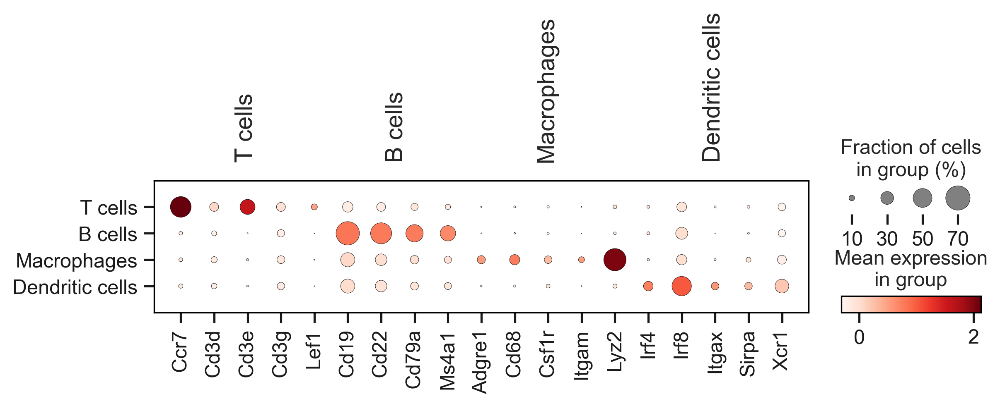

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


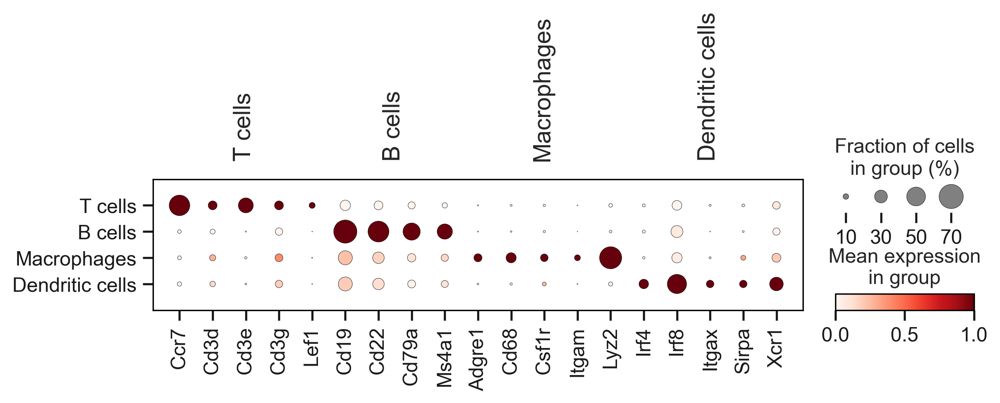

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


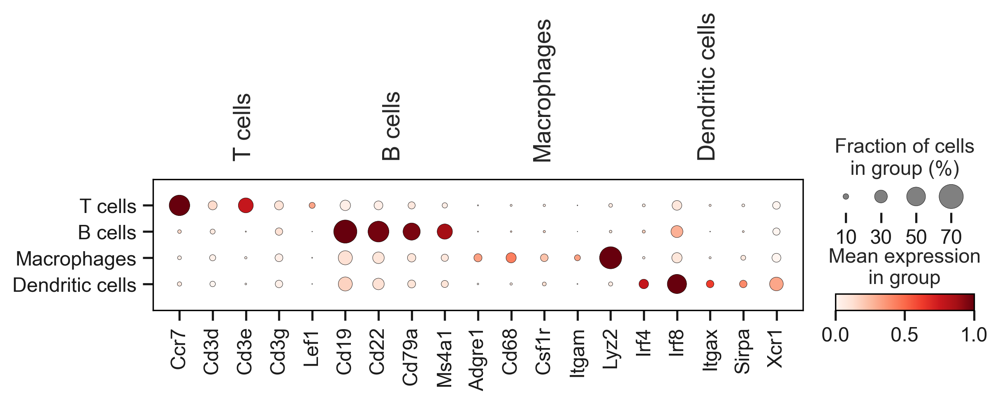

In [52]:
sc.pl.dotplot(pdata, level_1_gene_dict, groupby=f'level_1', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=False, save='level_1_h')
sc.pl.dotplot(pdata, level_1_gene_dict, groupby=f'level_1', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=False, standard_scale='var', save='level_1_var_h')
sc.pl.dotplot(pdata, level_1_gene_dict, groupby=f'level_1', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=False, standard_scale='group', save='level_1_group_h')

### level 2

In [57]:
pdata = rdata[rdata.obs['level_1'] != 'NA', ]

In [64]:
level_2_gene_dict = {
 'T cells': ['Cd3e', 'Cd3g', 'Cd3d'],
 'CD4+ T cells': ['Cd4'],
 'CD8+ T cells': ['Cd8a'],
 'Synthetic T cells': ['Ccr7'],
 'B cells': ['Cd19', 'Cd22', 'Cd79a', 'Ms4a1'],
 'Macrophages': ['Adgre1', 'Itgam'],
 'Activated Macrophages': ['Cd68'],
 'Monocytes': ['Csf1r', 'Lyz2'],
 'cDC1': ['Irf8'],
 'cDC2': ['Irf4'],
 'Other Dendritic cells': ['Itgax', 'Xcr1'],
}

In [65]:
level_2_order = list(level_2_gene_dict.keys())
pdata.obs['level_2'] = pdata.obs['level_2'].astype('category')
pdata.obs['level_2'] = pdata.obs['level_2'].cat.reorder_categories(level_2_order)

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


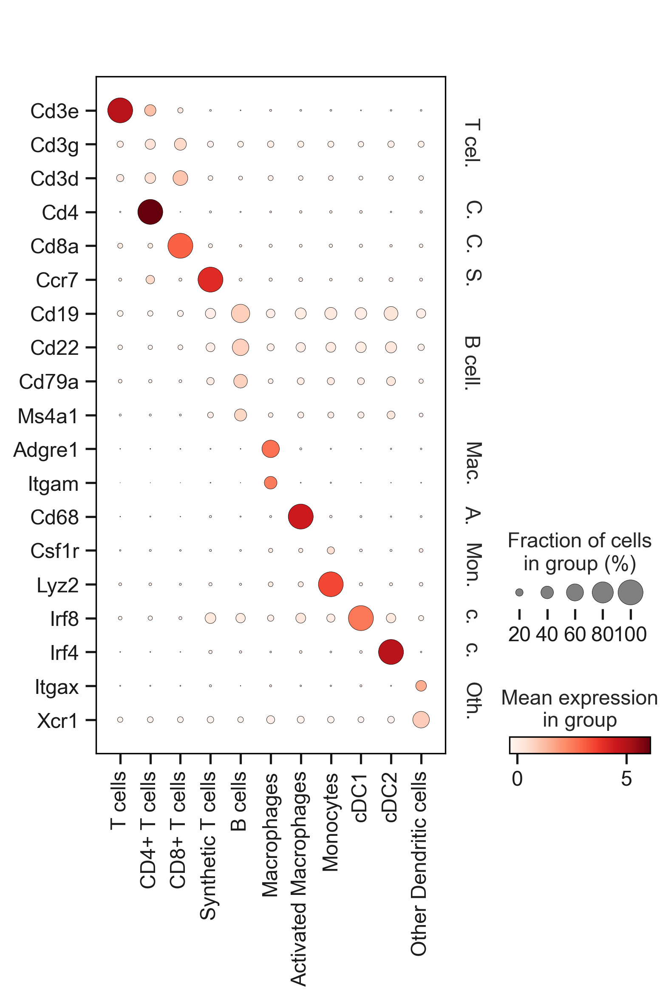

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


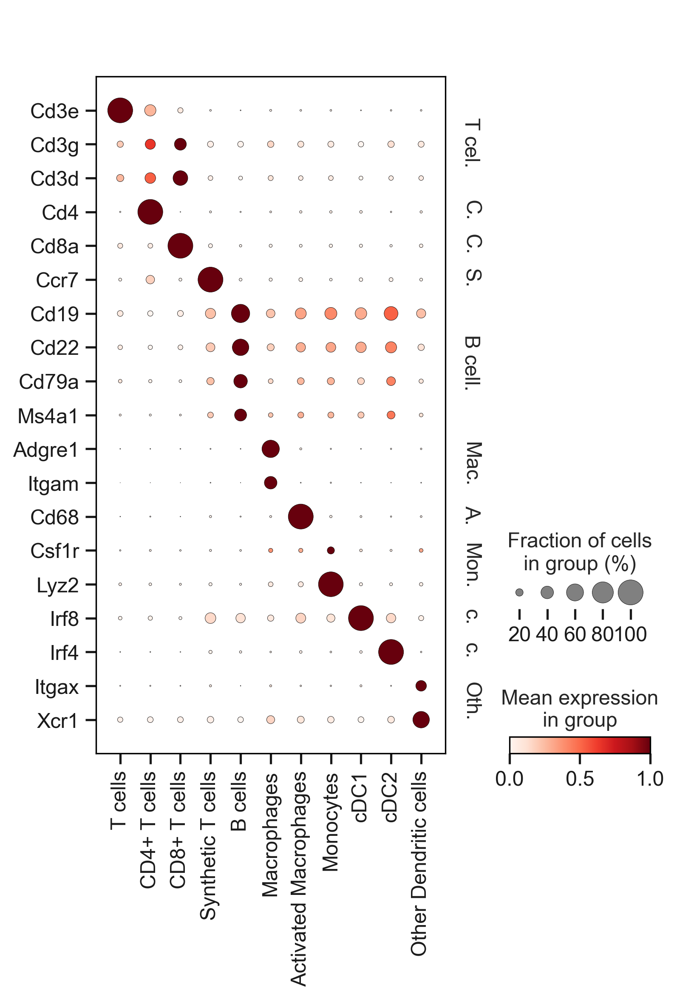

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


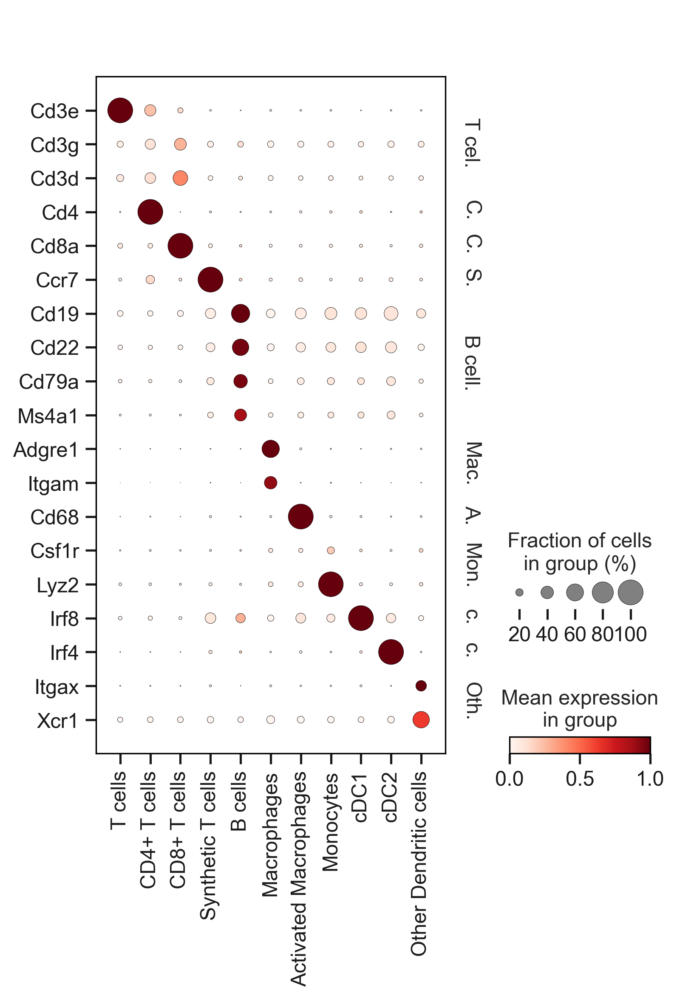

In [66]:
sc.pl.dotplot(pdata, level_2_gene_dict, groupby=f'level_2', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, save='level_2')
sc.pl.dotplot(pdata, level_2_gene_dict, groupby=f'level_2', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, standard_scale='var', save='level_2_var')
sc.pl.dotplot(pdata, level_2_gene_dict, groupby=f'level_2', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, standard_scale='group', save='level_2_group')

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


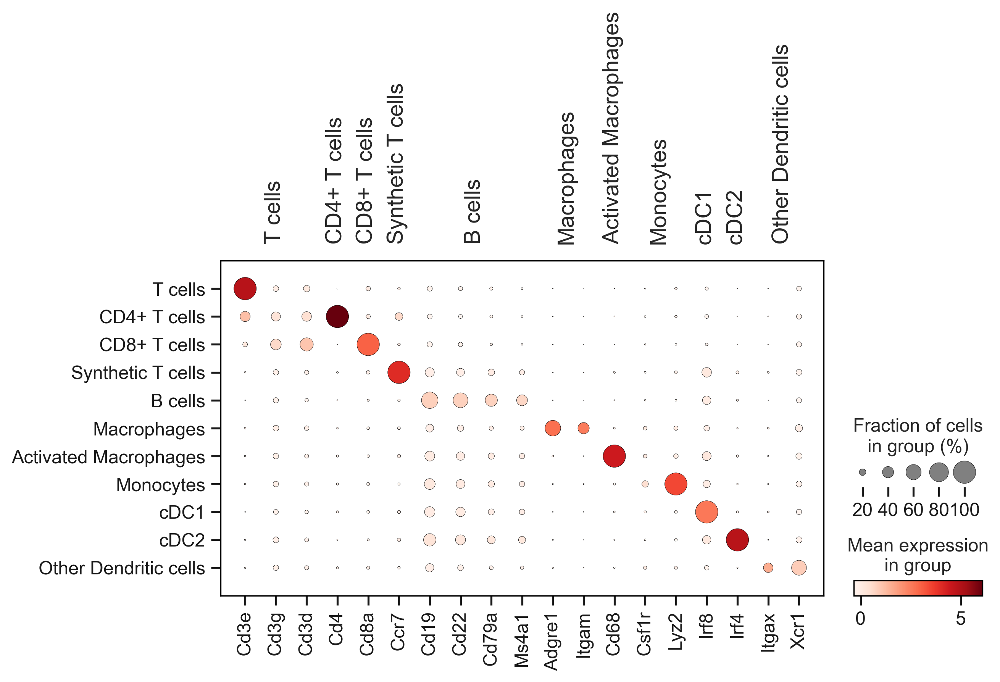

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


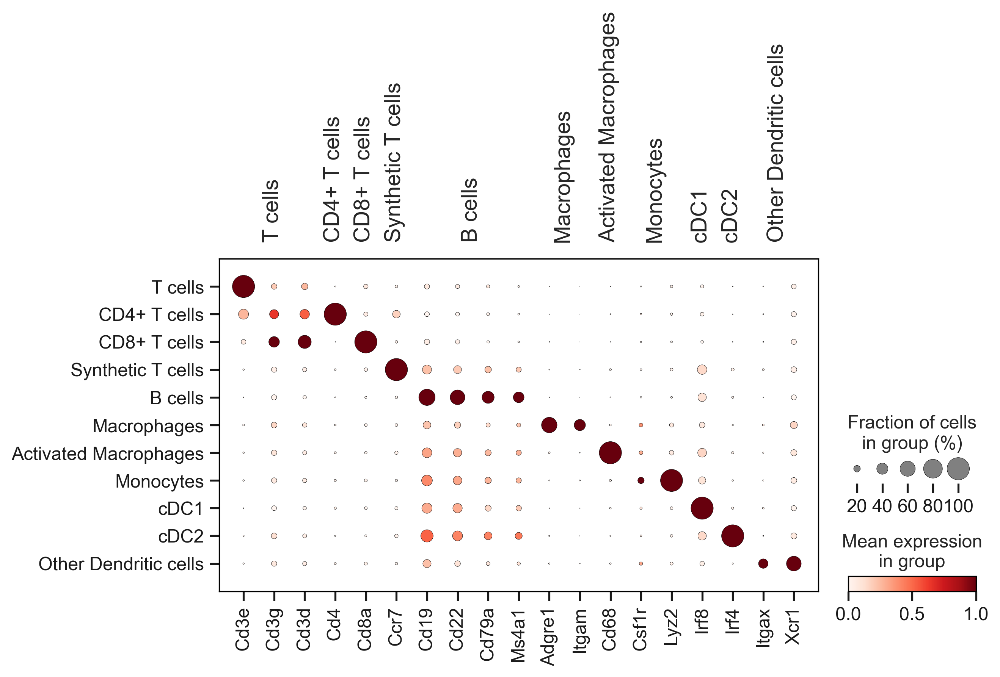

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


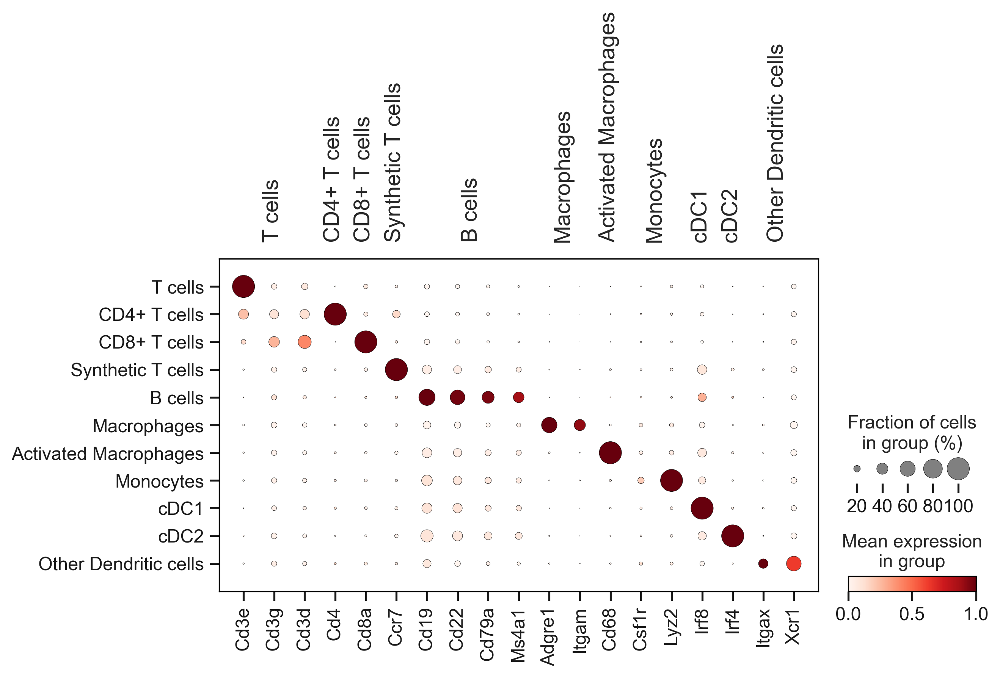

In [67]:
sc.pl.dotplot(pdata, level_2_gene_dict, groupby=f'level_2', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=False, save='level_2_h')
sc.pl.dotplot(pdata, level_2_gene_dict, groupby=f'level_2', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=False, standard_scale='var', save='level_2_var_h')
sc.pl.dotplot(pdata, level_2_gene_dict, groupby=f'level_2', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=False, standard_scale='group', save='level_2_group_h')

### level 2 T cells


In [ ]:
pdata = rdata[rdata.obs['level_2'].isin(level_2_t_cells_order), ]

In [ ]:
level_2_t_cells_gene_dict = {
 'T cells': ['Cd3e', 'Cd3d', 'Cd3g', 'Cd4', 'Cd8a', 'Ccr7'],
}

In [ ]:
sc.pl.dotplot(pdata, level_2_t_cells_gene_dict, groupby=f'level_2', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, save='level_2_t_cells')
sc.pl.dotplot(pdata, level_2_t_cells_gene_dict, groupby=f'level_2', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, standard_scale='var', save='level_2_t_cells_var')
sc.pl.dotplot(pdata, level_2_t_cells_gene_dict, groupby=f'level_2', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, standard_scale='group', save='level_2_t_cells_group')

### level 2 DC


In [95]:
pdata = rdata[rdata.obs['level_2'].isin(level_2_dc_order), ]
pdata.obs['level_2'] = pdata.obs['level_2'].cat.reorder_categories(level_2_dc_order)

C:\Users\jiahao\AppData\Local\Temp\ipykernel_55512\3865561429.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  pdata.obs['level_2'] = pdata.obs['level_2'].cat.reorder_categories(level_2_dc_order)


In [96]:
level_2_dc_gene_dict = {'cDC1': ['Irf8'], 'cDC2': ['Irf4'], 'Dendritic cells': ['Itgax', 'Xcr1'], 'DEG': ['Cd40', 'Cd83', 'Cd86', 'H2-K1']}

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


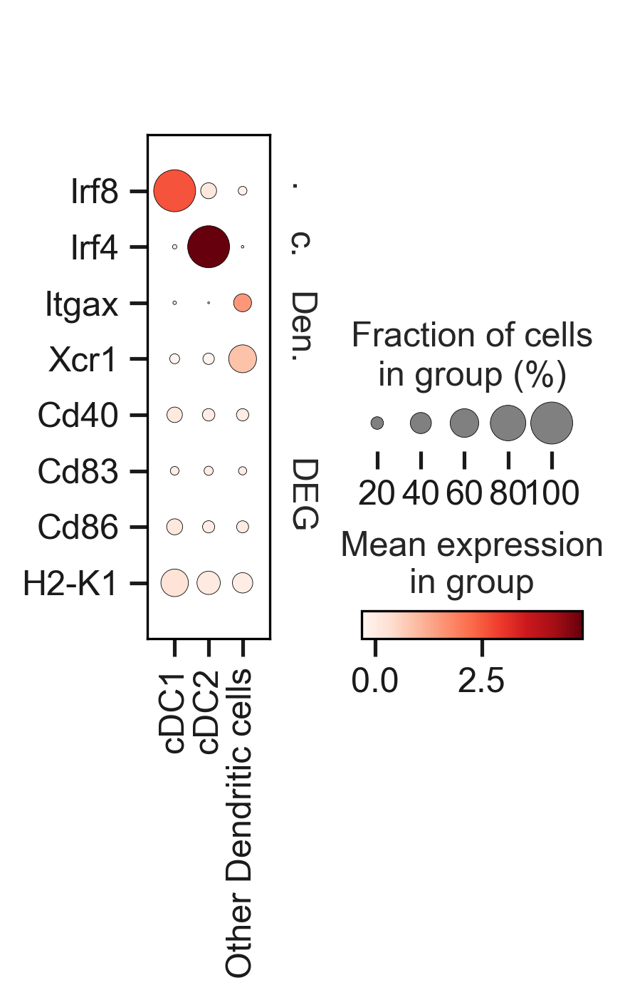

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


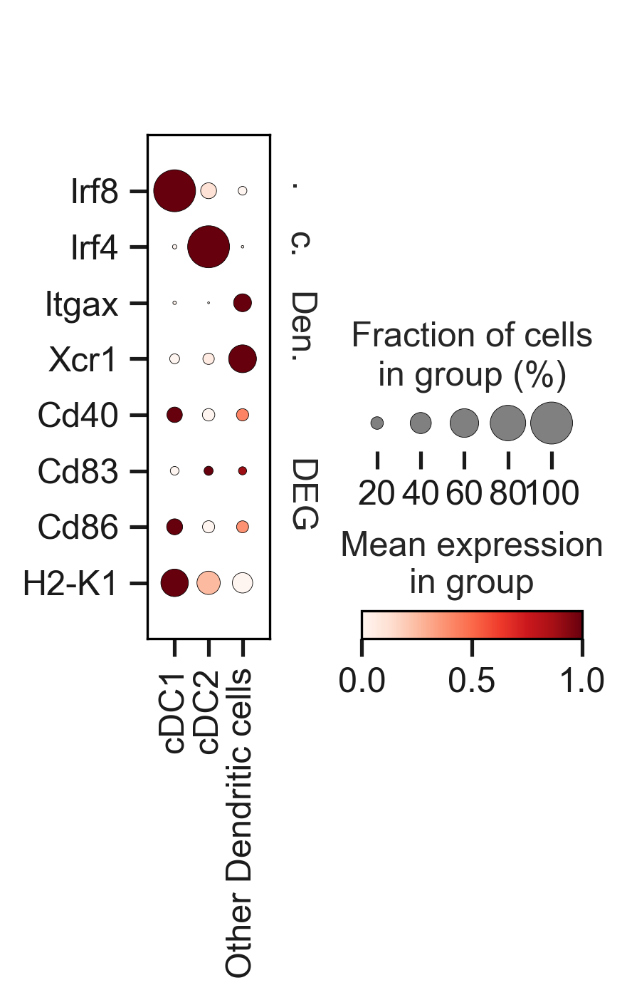

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


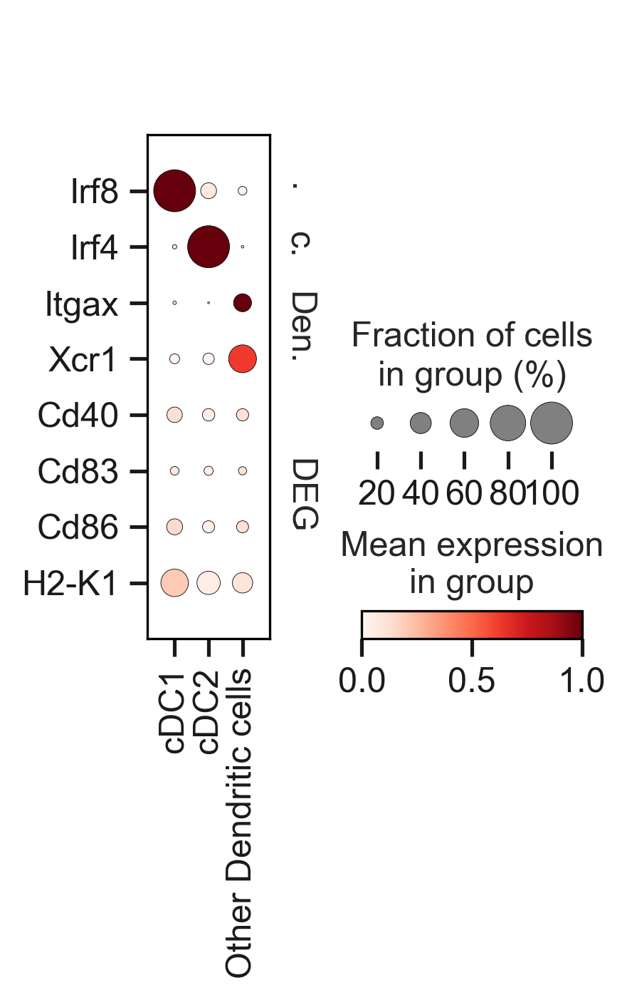

In [97]:
sc.pl.dotplot(pdata, level_2_dc_gene_dict, groupby=f'level_2', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, save='level_2_dc')
sc.pl.dotplot(pdata, level_2_dc_gene_dict, groupby=f'level_2', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, standard_scale='var', save='level_2_dc_var')
sc.pl.dotplot(pdata, level_2_dc_gene_dict, groupby=f'level_2', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, standard_scale='group', save='level_2_dc_group')

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


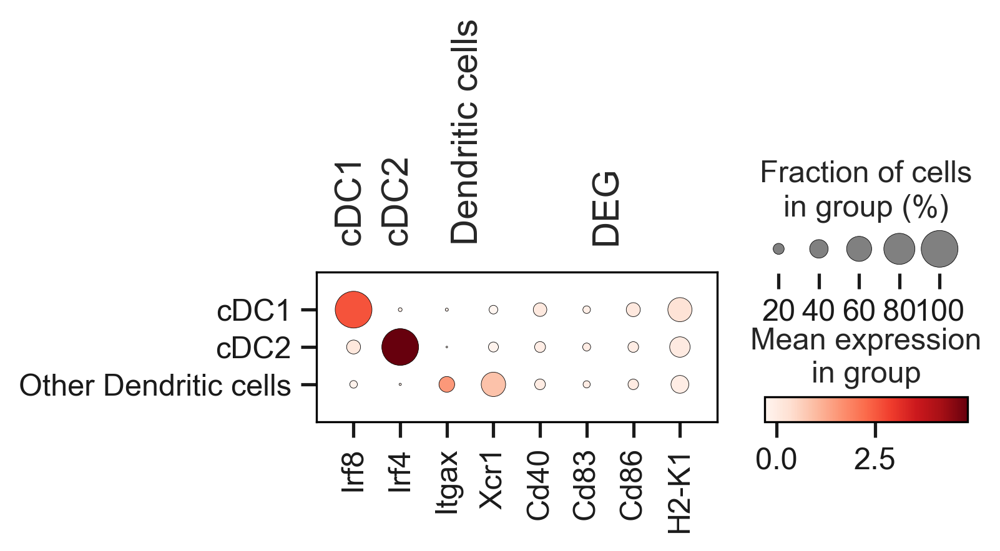

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


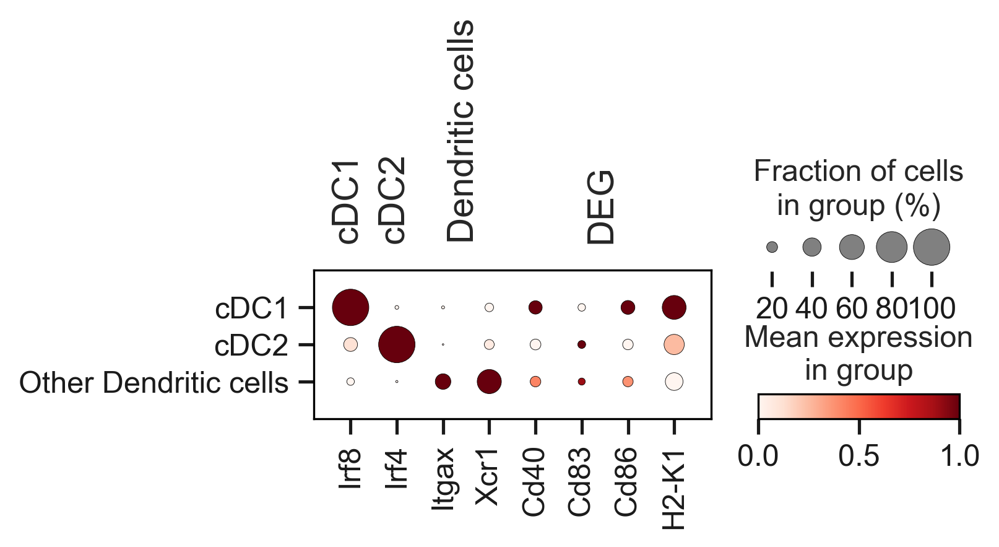

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


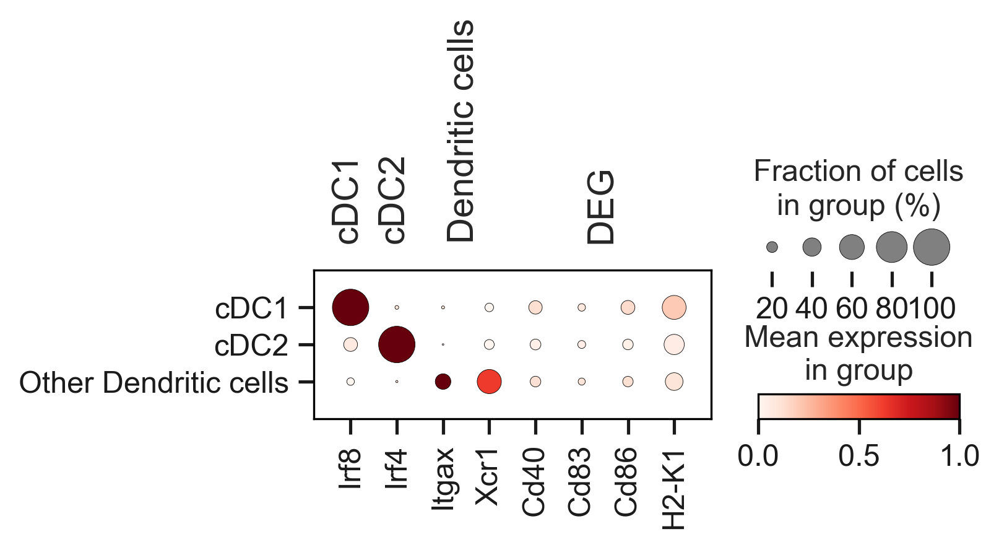

In [98]:
sc.pl.dotplot(pdata, level_2_dc_gene_dict, groupby=f'level_2', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=False, save='level_2_dc_h')
sc.pl.dotplot(pdata, level_2_dc_gene_dict, groupby=f'level_2', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=False, standard_scale='var', save='level_2_dc_var_h')
sc.pl.dotplot(pdata, level_2_dc_gene_dict, groupby=f'level_2', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=False, standard_scale='group', save='level_2_dc_group_h')

In [ ]:
sc.pl.dotplot(pdata, ['Cd40', 'Cd83', 'Cd86', 'H2-K1'], groupby=f'level_2', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, save='level_2_dc_four_genes')

### level 2 MC

In [ ]:
pdata = rdata[rdata.obs['level_2'].isin(level_2_mc_order), ]

In [ ]:
level_2_mc_gene_dict = {'Macrophages': ['Adgre1', 'Itgam'],
 'Activated Macrophages': ['Cd68'],
 'Monocytes': ['Csf1r', 'Lyz2']}

In [ ]:
sc.pl.dotplot(pdata, level_2_mc_gene_dict, groupby=f'level_2', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, save='level_2_mc')
sc.pl.dotplot(pdata, level_2_mc_gene_dict, groupby=f'level_2', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, standard_scale='var', save='level_2_mc_var')
sc.pl.dotplot(pdata, level_2_mc_gene_dict, groupby=f'level_2', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, standard_scale='group', save='level_2_mc_group')

### level 3 T cells

In [81]:
pdata = rdata[rdata.obs['level_2'].isin(['CD4+ T cells', 'CD8+ T cells']), ]
current_order = ['CD4+ T cells', 'CD8+ T cells', 'Treg', 'Th1', 'Th2', 'Th17', 'Naive CD4+ T cells', 'Naive CD8+ T cells', 'PD-1+ T cells']
pdata.obs['level_3'] = pdata.obs['level_3'].astype('category')
pdata.obs['level_3'] = pdata.obs['level_3'].cat.reorder_categories(current_order)

In [82]:
level_3_t_gene_dict = {
 'T cells': ['Cd3d', 'Cd3e', 'Cd3g'],
 'CD4 T cells': ['Cd4'],
 'CD8 T cells': ['Cd8a'],
 'Treg': ['Foxp3', 'Il2ra'],
 'Th1': ['Ifng', 'Tbx21'],
 'Th2': ['Il4'],
 'Th17': ['Il17a'],
 'Naïve T cells': ['Ccr7', 'Lef1', 'Sell'],
 'PD-1+ T cells': ['Pdcd1'],
'Other': ['Irf4', 'Cd28']}

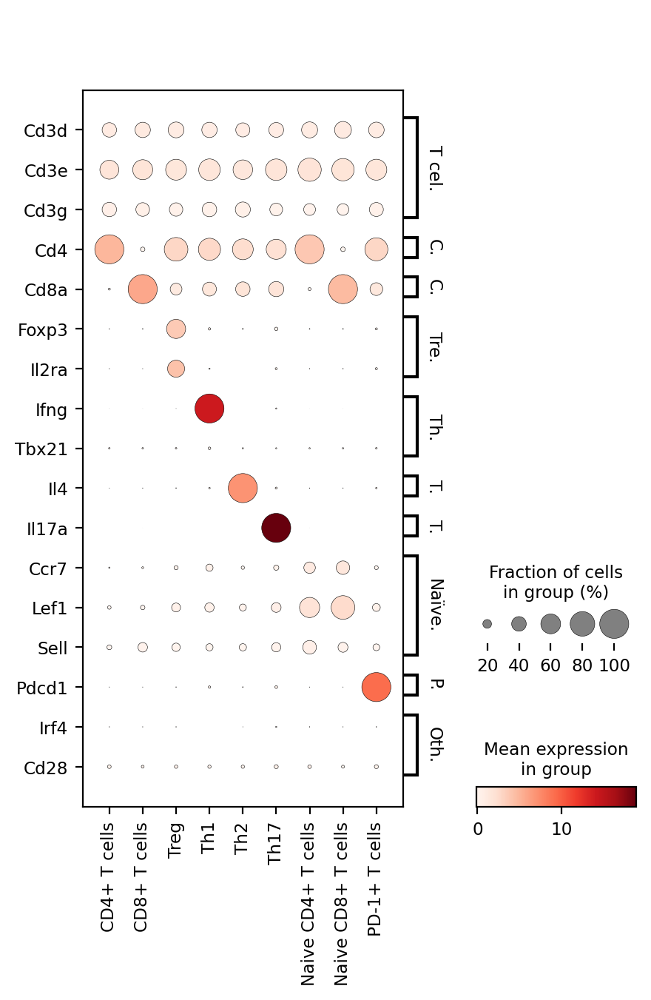

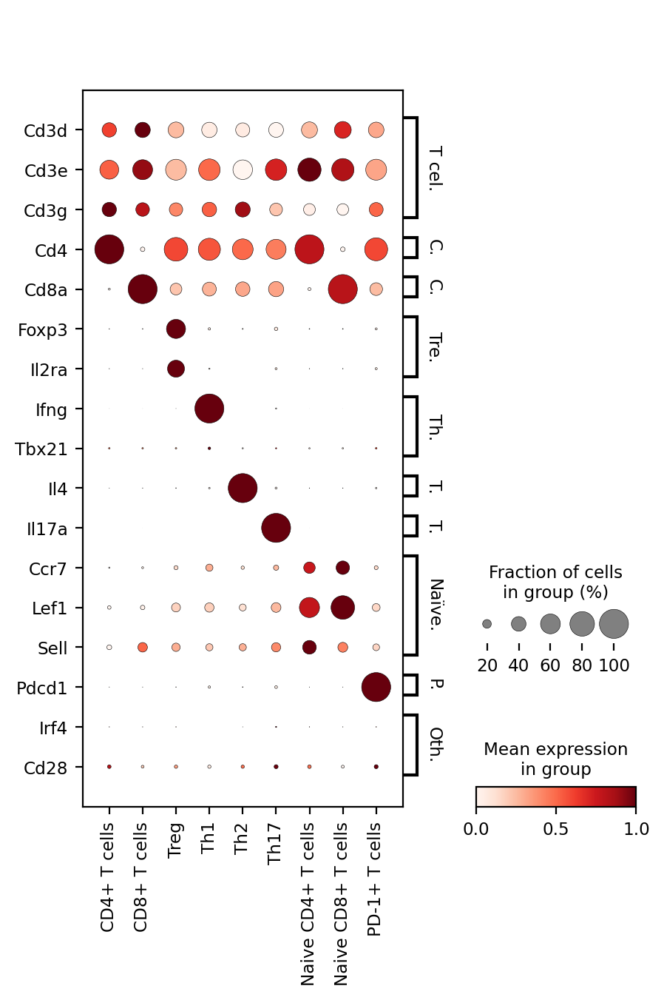

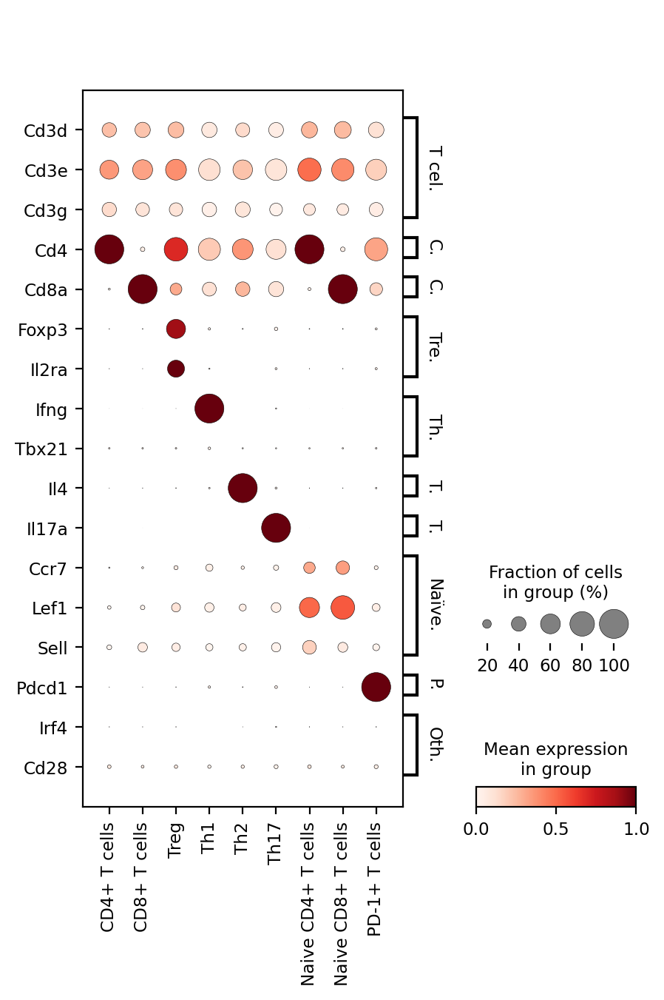

In [83]:
sc.pl.dotplot(pdata, level_3_t_gene_dict, groupby=f'level_3', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, save='level_3_t_cells')
sc.pl.dotplot(pdata, level_3_t_gene_dict, groupby=f'level_3', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, standard_scale='var', save='level_3_t_cells_var')
sc.pl.dotplot(pdata, level_3_t_gene_dict, groupby=f'level_3', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, standard_scale='group', save='level_3_t_cells_group')

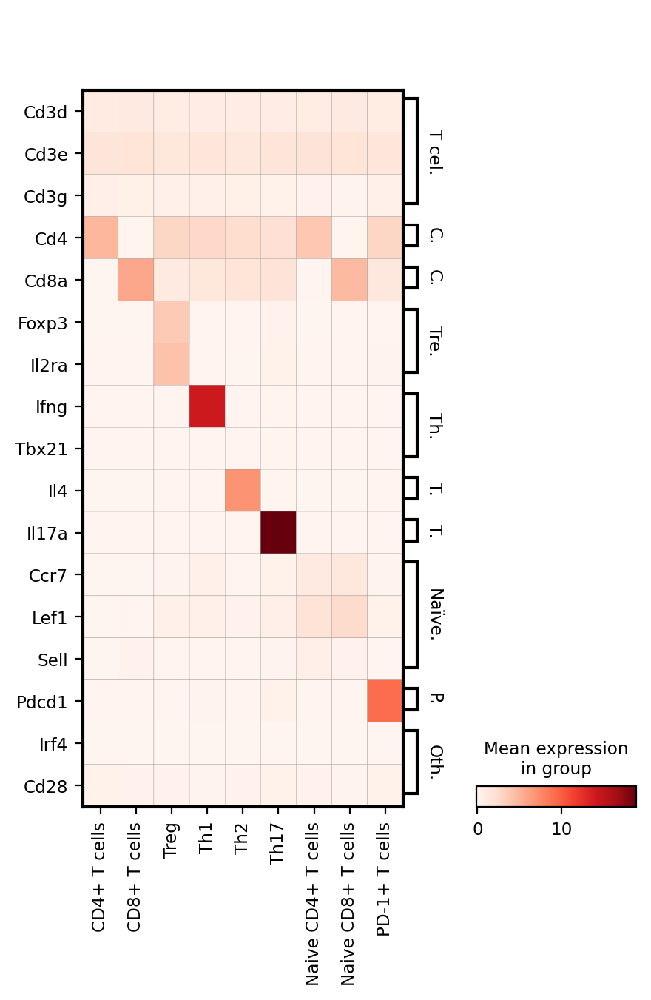

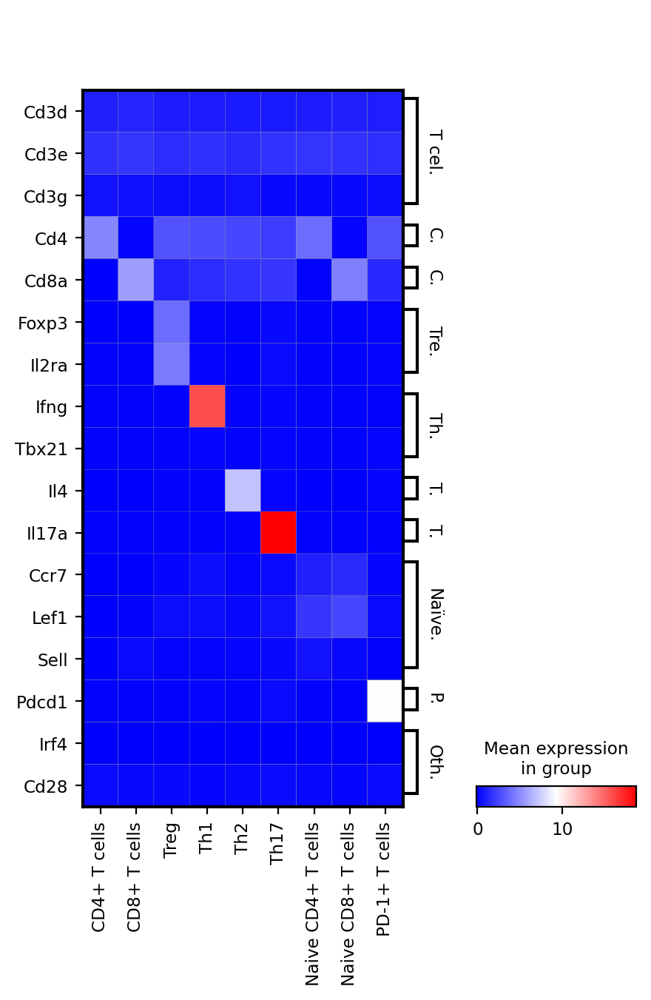

In [85]:
sc.pl.matrixplot(pdata, level_3_t_gene_dict, groupby=f'level_3', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, save='level_3_t_cells')

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


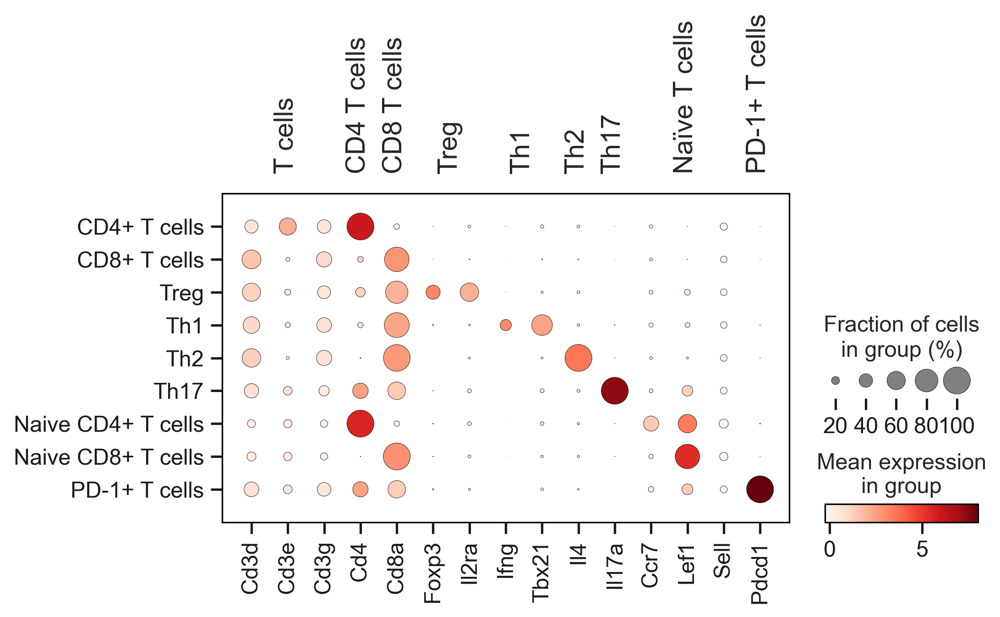

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


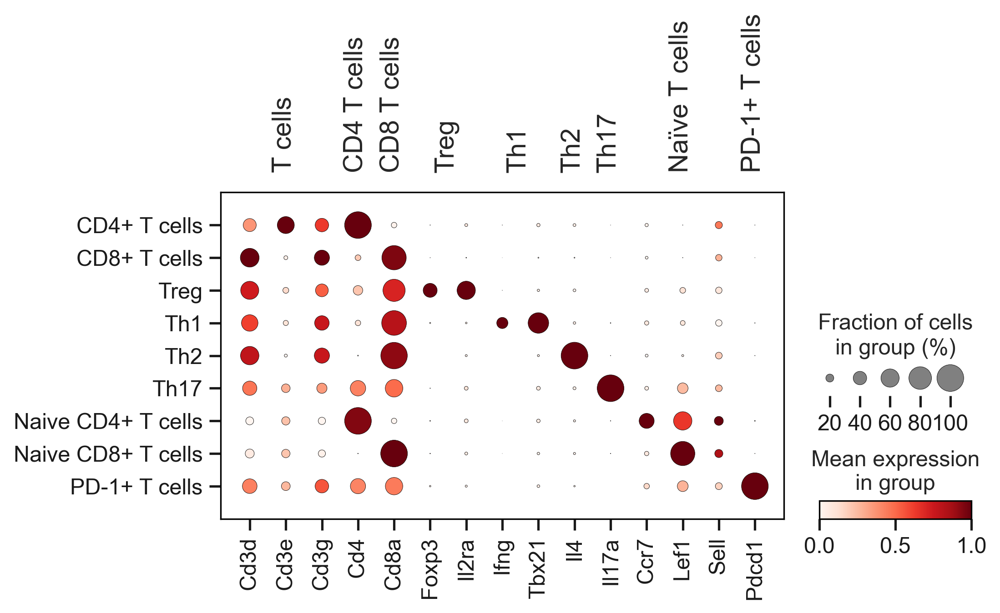

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


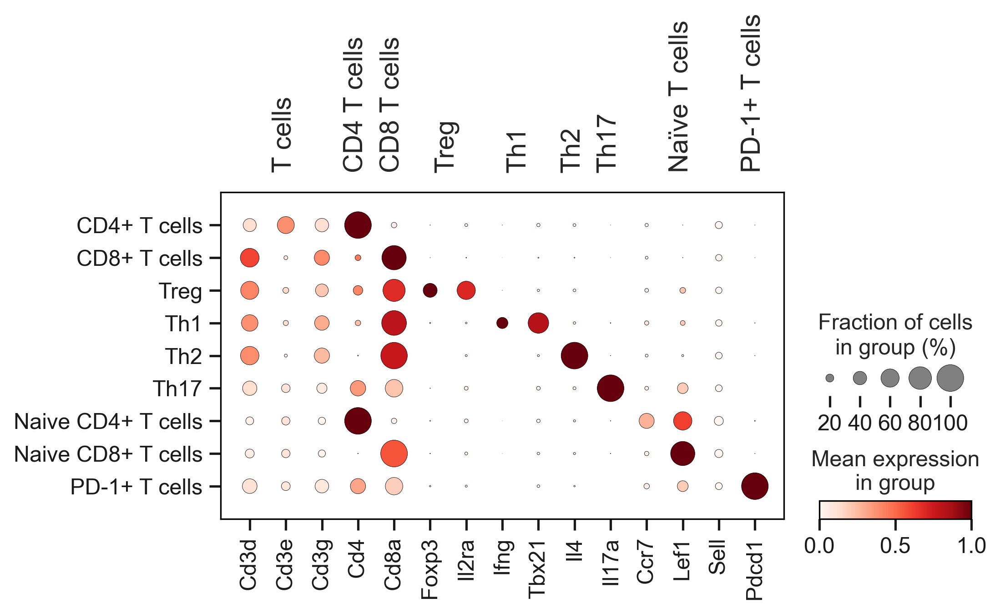

In [80]:
sc.pl.dotplot(pdata, level_3_t_gene_dict, groupby=f'level_3', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=False, save='level_3_t_cells_h')
sc.pl.dotplot(pdata, slevel_3_t_gene_dict, groupby=f'level_3', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=False, standard_scale='var', save='level_3_t_cells_var_h')
sc.pl.dotplot(pdata, level_3_t_gene_dict, groupby=f'level_3', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=False, standard_scale='group', save='level_3_t_cells_group_h')

### level 3 Synthetoc T cells (99R)

In [180]:
current_order = ['pro-T (Kit)', 'pro-T (Notch)', 'pro-T (Bcl-2+)', 'DN (TCRB+)', 'Naive CD4+ T cells', 'Naive CD8+ T cells']
pdata = rdata[(rdata.obs['level_3'].isin(current_order)) & (rdata.obs['condition'] == '99R'), ]
pdata.obs['level_3'] = pdata.obs['level_3'].astype('category')
pdata.obs['level_3'] = pdata.obs['level_3'].cat.reorder_categories(current_order)

C:\Users\jiahao\AppData\Local\Temp\ipykernel_55512\1025593182.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  pdata.obs['level_3'] = pdata.obs['level_3'].astype('category')


In [181]:
# level_3_t_gene_dict = {'Prethymic': ['Bcl11a', 'Hhex', 'Hoxa9', 'Lmo2', 'Lyl1', 'Mef2c', 'Meis1'],
#  'T cell development, DN commitment': ['Bcl11b', 'Ets1'],
#  'T cell survival, memory': ['Bcl2'],
#  'Naive and central memory': ['Ccr7'],
#  'T cell receptor': ['Cd247'],
#  'Co-stimulation': ['Cd28'],
#  'T cell activation': ['Cd44'],
#  'FLT3 receptor, dendritic cell marker': ['Flt3'],
#  'Th2 cell marker, DN commitment': ['Gata3'],
#  'T cell development': ['Gfi1',
#   'Ikzf1',
#   'Kit',
#   'Lef1',
#   'Runx1',
#   'Tcf12',
#   'Tcf3',
#   'Tcf7'],
#  'Notch signaling': ['Hes1'],
#  'Treg marker': ['Il2ra'],
#  'T cell survival, homeostasis': ['Il7r'],
#  'V(D)J recombination': ['Rag1', 'Rag2'],
#  'T cell migration / central memory': ['Sell']}

In [182]:
selected_genes = [	
'Kit', 'Flt3',
    'Cd44','Il2ra','Cd3d','Cd3e','Cd3g',
    'Lyl1','Hhex','Bcl11a','Hoxa9','Mef2c',
    'Lmo2','Meis1','Tcf3','Ikzf1','Runx1',
    'Tcf12','Gfi1','Gata3','Bcl11b','Lef1',
    'Ets1','Rag1','Rag2',]

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


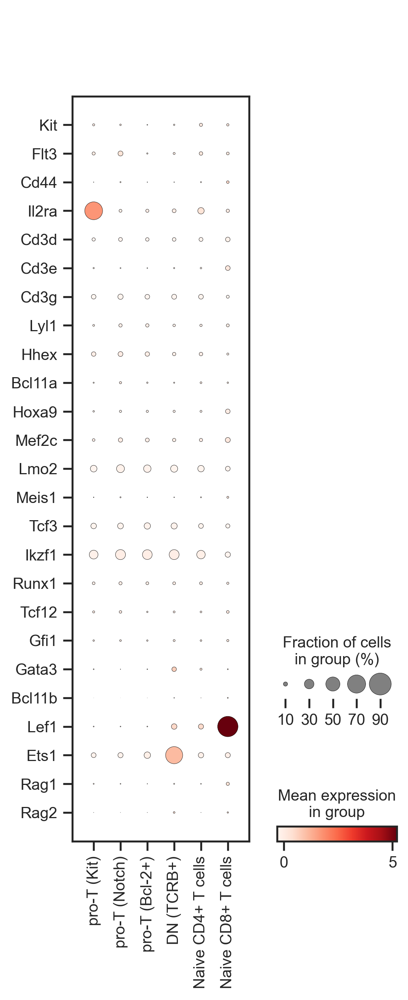

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


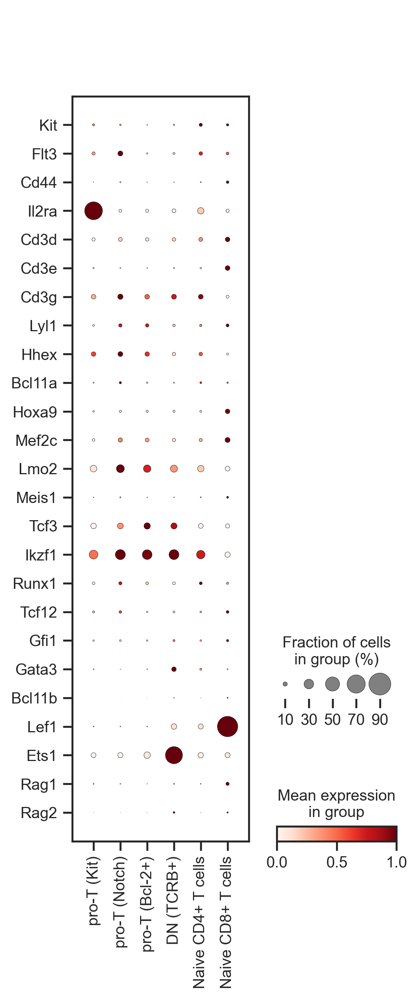

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


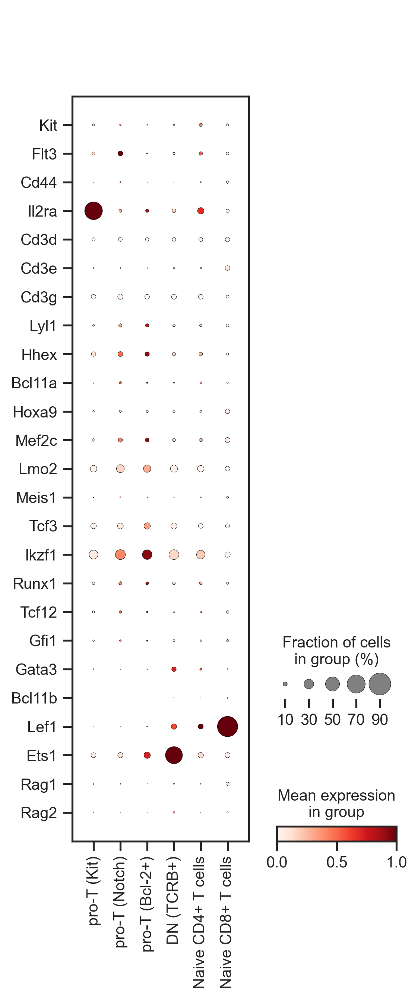

In [183]:
sc.pl.dotplot(pdata, selected_genes, groupby=f'level_3', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, save='level_3_synthetic_t_cells')
sc.pl.dotplot(pdata, selected_genes, groupby=f'level_3', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, standard_scale='var', save='level_3_synthetic_t_cells_var')
sc.pl.dotplot(pdata, selected_genes, groupby=f'level_3', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, standard_scale='group', save='level_3_synthetic_t_cells_group')

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


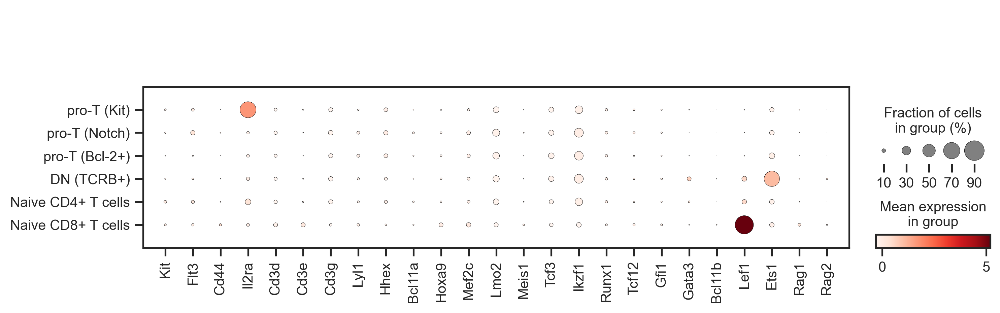

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


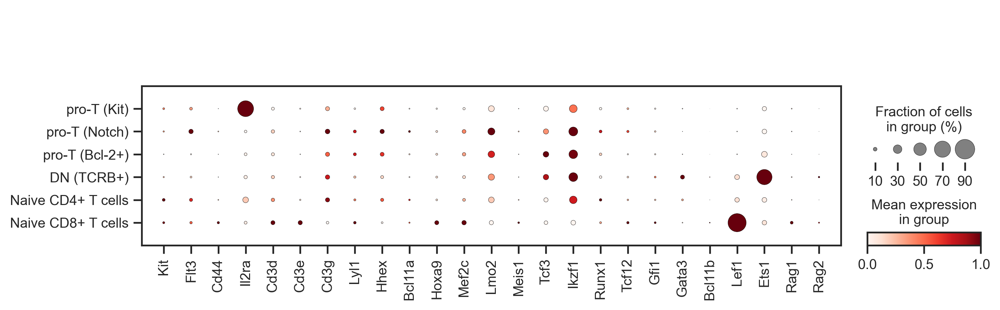

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


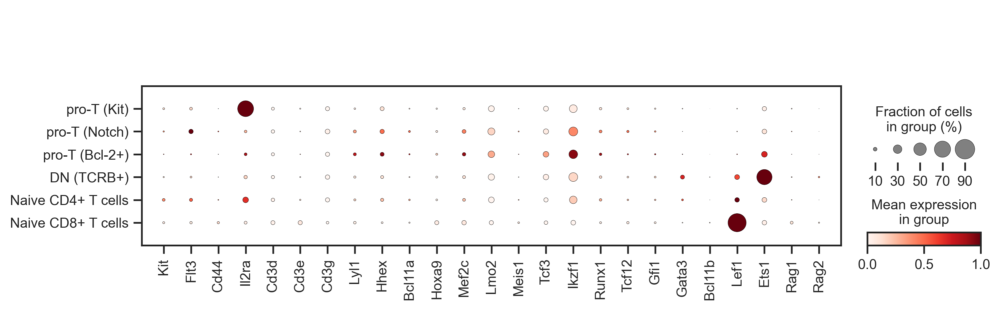

In [184]:
sc.pl.dotplot(pdata, selected_genes, groupby=f'level_3', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=False, save='level_3_synthetic_t_cells_h')
sc.pl.dotplot(pdata, selected_genes, groupby=f'level_3', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=False, standard_scale='var', save='level_3_synthetic_t_cells_var_h')
sc.pl.dotplot(pdata, selected_genes, groupby=f'level_3', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=False, standard_scale='group', save='level_3_synthetic_t_cells_group_h')

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


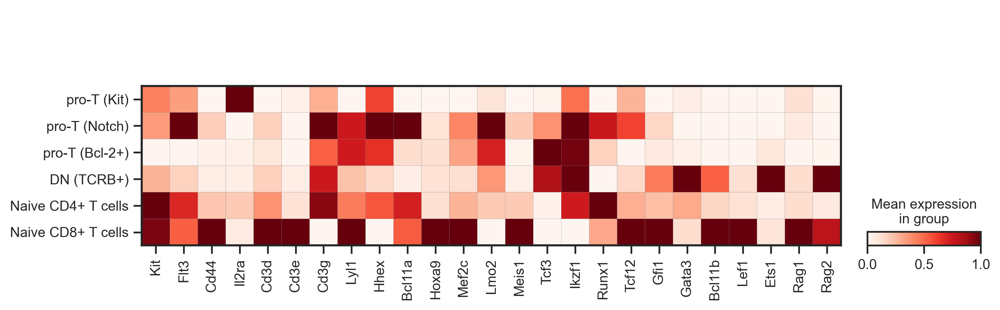

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_matrixplot.py:143: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  values_df = self.obs_tidy.groupby(level=0).mean()


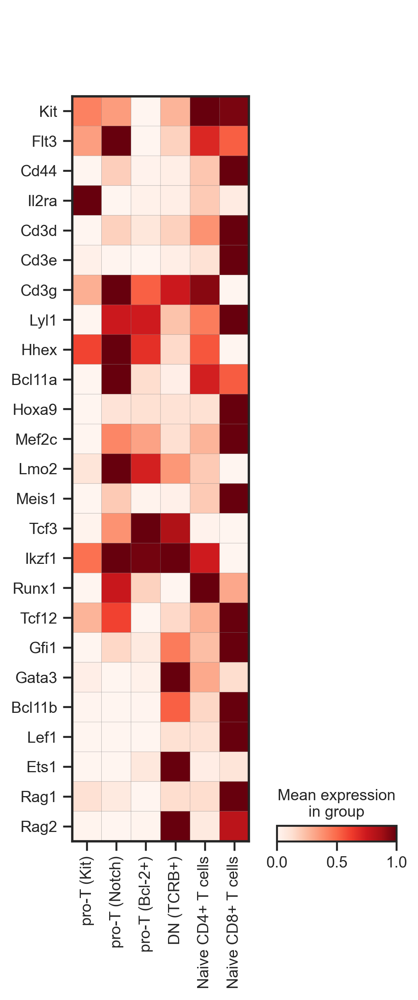

In [186]:
sc.pl.matrixplot(pdata, selected_genes, groupby=f'level_3', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=False, standard_scale='var', save='level_3_synthetic_t_cells_var_h')
sc.pl.matrixplot(pdata, selected_genes, groupby=f'level_3', dendrogram=False, use_raw=True, cmap='Reds', swap_axes=True, standard_scale='var', save='level_3_synthetic_t_cells_var')

### region

In [68]:
rdata.obs['region'] = rdata.obs['region'].astype('category')

In [69]:
level_1_gene_dict = {
 'T cells': ['Cd3d', 'Cd3e', 'Cd3g'],
 'B cells': ['Cd19', 'Cd22', 'Cd40', 'Cd79a', 'Ms4a1'],
 'Macrophages': ['Adgre1', 'Cd68', 'Csf1r', 'Itgam', 'Lyz2'],
 'Dendritic cells': ['Irf4', 'Irf8', 'Itgax', 'Sirpa', 'Xcr1'],
 'NK cells': ['Ccl5', 'Gzma', 'Nkg7', 'Ptprc'],
 'Endothelial cells': ['Cdh5', 'Lrg1', 'Ly6a', 'Pecam1'],
 'APC':['Cd40', 'Cd86', 'H2-K1', 'H2-Aa']
}

sample1


C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


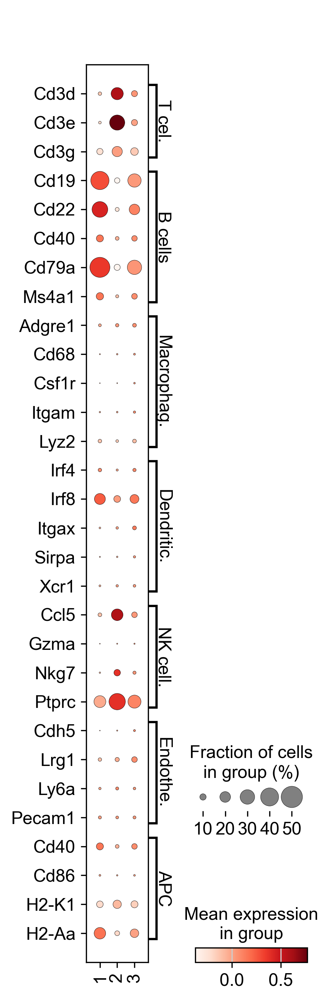

sample2


C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


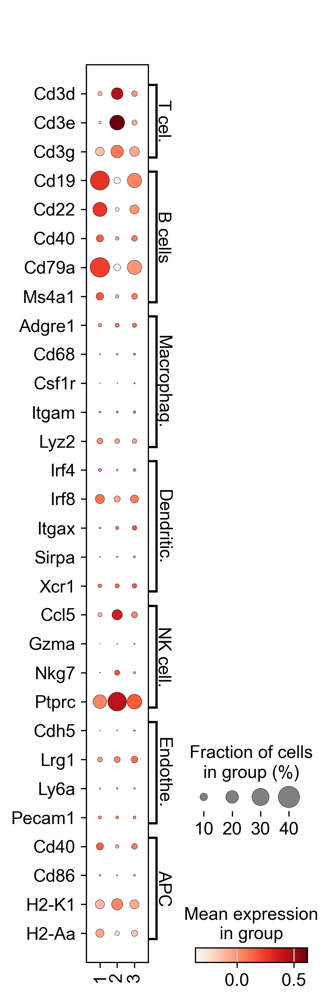

sample3


C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


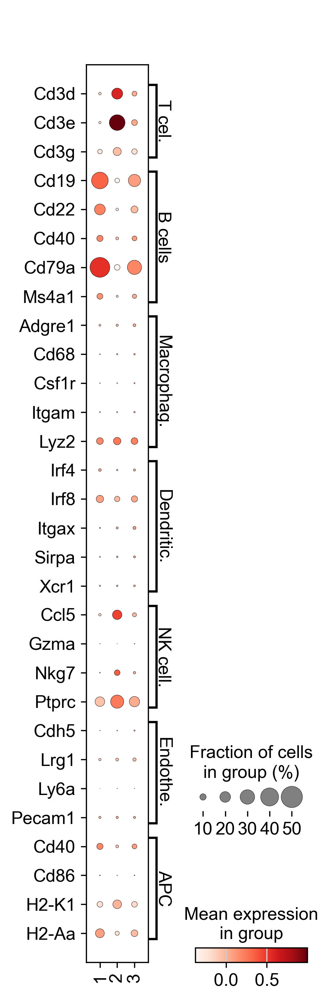

sample4


C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


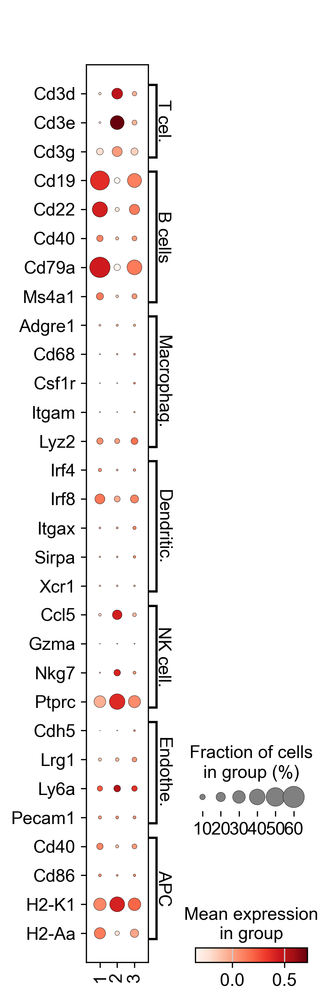

sample5


C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


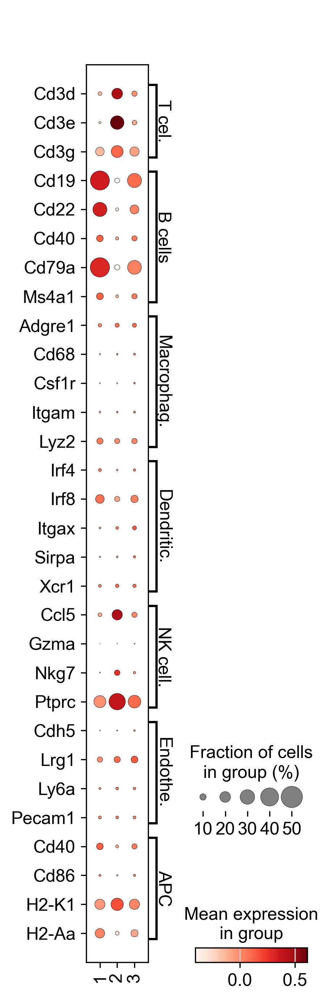

sample6


C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


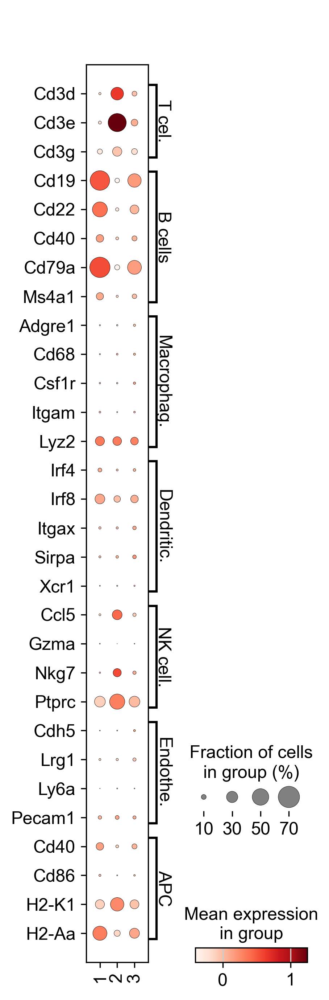

In [71]:
for current_sample in rdata.obs['sample'].unique():
    print(current_sample)
    pdata = rdata[(rdata.obs['sample'] == current_sample) & (rdata.obs['level_1'] != 'NA'), ]

    sc.pl.dotplot(pdata, level_1_gene_dict, groupby=f'region', dendrogram=False, use_raw=False, cmap='Reds', swap_axes=True)# , save='level_3_synthetic_t_cells')
    

In [72]:
pdata.obs['sample-region'] = pdata.obs['sample'].astype(str) + '_' + pdata.obs['region'].astype(str)

C:\Users\jiahao\AppData\Local\Temp\ipykernel_52212\1885209832.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  pdata.obs['sample-region'] = pdata.obs['sample'].astype(str) + '_' + pdata.obs['region'].astype(str)


In [57]:
current_order = []
for i in plot_order:
    for j in condition_order:
        dc_condition_order.append(f"{i}_{j}")
pdata.obs['type-condition'] = pdata.obs['type-condition'].astype('category')
pdata.obs['type-condition'] = pdata.obs['type-condition'].cat.reorder_categories(dc_condition_order)

In [74]:
rdata.obs

,sample,fov_id,volume,fov_x,fov_y,fov_z,seg_label,global_x,global_y,global_z,...,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,region,n_counts,n_genes,level_1,level_2,level_3
unique_index,,,,,,,,,,,,,,,,,,,,,
sample1_Position001_1,sample1,Position001,14458,1224,1263,37,1,1264,12053,66,...,5,1.791759,9.0,2.302585,1,9.0,5,Dendritic cells,cDC1,cDC1
sample1_Position001_2,sample1,Position001,12521,66,1220,37,2,106,12010,66,...,2,1.098612,5.0,1.791759,1,5.0,2,NA,NA,NA
sample1_Position001_3,sample1,Position001,15358,453,1267,37,3,493,12057,66,...,6,1.945910,8.0,2.197225,1,8.0,6,B cells,B cells,B cells
sample1_Position001_4,sample1,Position001,17420,301,916,11,4,341,11706,40,...,6,1.945910,16.0,2.833213,1,16.0,6,B cells,B cells,B cells
sample1_Position001_5,sample1,Position001,21607,360,1018,26,5,400,11808,55,...,7,2.079442,13.0,2.639057,1,13.0,7,Macrophages,Activated Macrophages,Activated Macrophages
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
sample6_Position1078_4282,sample6,Position1078,7331,685,1449,30,4282,26155,2864,59,...,3,1.386294,3.0,1.386294,3,3.0,3,Macrophages,Monocytes,Monocytes
sample6_Position1078_4326,sample6,Position1078,6376,1177,1408,17,4326,26647,2823,46,...,2,1.098612,2.0,1.098612,3,2.0,2,Macrophages,Macrophages,Macrophages
sample6_Position1078_4345,sample6,Position1078,7697,622,1483,40,4345,26092,2898,69,...,5,1.791759,9.0,2.302585,3,9.0,5,B cells,B cells,B cells


### DEG

#### APC

In [14]:
raw_cdata.obs = rdata.obs.copy()

In [15]:
pdata = raw_cdata[raw_cdata.obs['level_1'] == 'Dendritic cells', ]
pdata

View of AnnData object with n_obs × n_vars = 551636 × 61
    obs: 'sample', 'fov_id', 'volume', 'fov_x', 'fov_y', 'fov_z', 'seg_label', 'global_x', 'global_y', 'global_z', 'condition', 'replicate', 'unique_index', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'region', 'n_counts', 'n_genes', 'level_1', 'level_2', 'level_3', 'APC'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    layers: 'raw'

In [18]:
pdata.obs['level_2_APC'] = pdata.obs['level_2'].astype(str) + '_' + pdata.obs['APC'].astype(str)
pdata.obs['level_2_APC'] = pdata.obs['level_2_APC'].astype('category')

In [ ]:
# Add log layer
pdata.layers['log_raw'] = np.log1p(pdata.layers['raw'])
sc.pp.normalize_total(pdata, layer='log_raw')

# Find gene markers for each cluster
sc.tl.rank_genes_groups(pdata, 'level_2_APC', method='wilcoxon', layer='log_raw', pts=False, use_raw=False, n_genes=pdata.shape[1])

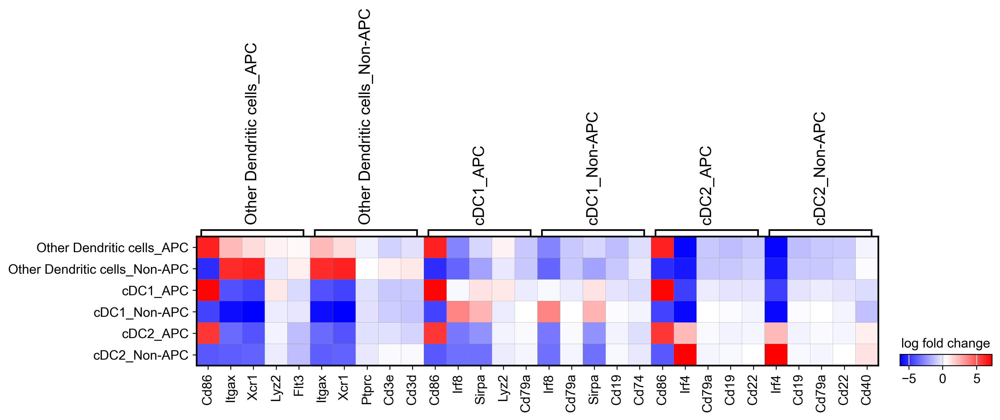

In [24]:
sc.pl.rank_genes_groups_matrixplot(pdata, key='rank_genes_groups', n_genes=5, dendrogram=False, values_to_plot='logfoldchanges', cmap='bwr')#, vmin=-1, vmax=1)

#### cDC1

In [25]:
raw_cdata.obs = rdata.obs.copy()

In [26]:
pdata = raw_cdata[raw_cdata.obs['level_2'] == 'cDC1', ]
pdata

View of AnnData object with n_obs × n_vars = 320732 × 61
    obs: 'sample', 'fov_id', 'volume', 'fov_x', 'fov_y', 'fov_z', 'seg_label', 'global_x', 'global_y', 'global_z', 'condition', 'replicate', 'unique_index', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'region', 'n_counts', 'n_genes', 'level_1', 'level_2', 'level_3', 'APC'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    layers: 'raw'

In [27]:
# Add log layer
pdata.layers['log_raw'] = np.log1p(pdata.layers['raw'])
sc.pp.normalize_total(pdata, layer='log_raw')

# Find gene markers for each cluster
sc.tl.rank_genes_groups(pdata, 'APC', method='wilcoxon', layer='log_raw', pts=False, use_raw=False, n_genes=pdata.shape[1])

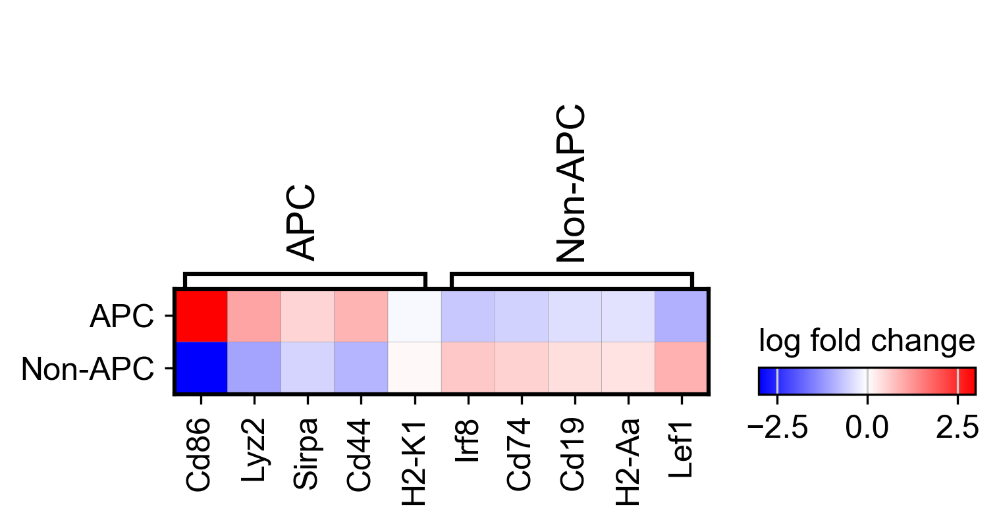

In [33]:
sc.pl.rank_genes_groups_matrixplot(pdata, key='rank_genes_groups', n_genes=5, dendrogram=False, values_to_plot='logfoldchanges', cmap='bwr', vmin=-3, vmax=3)

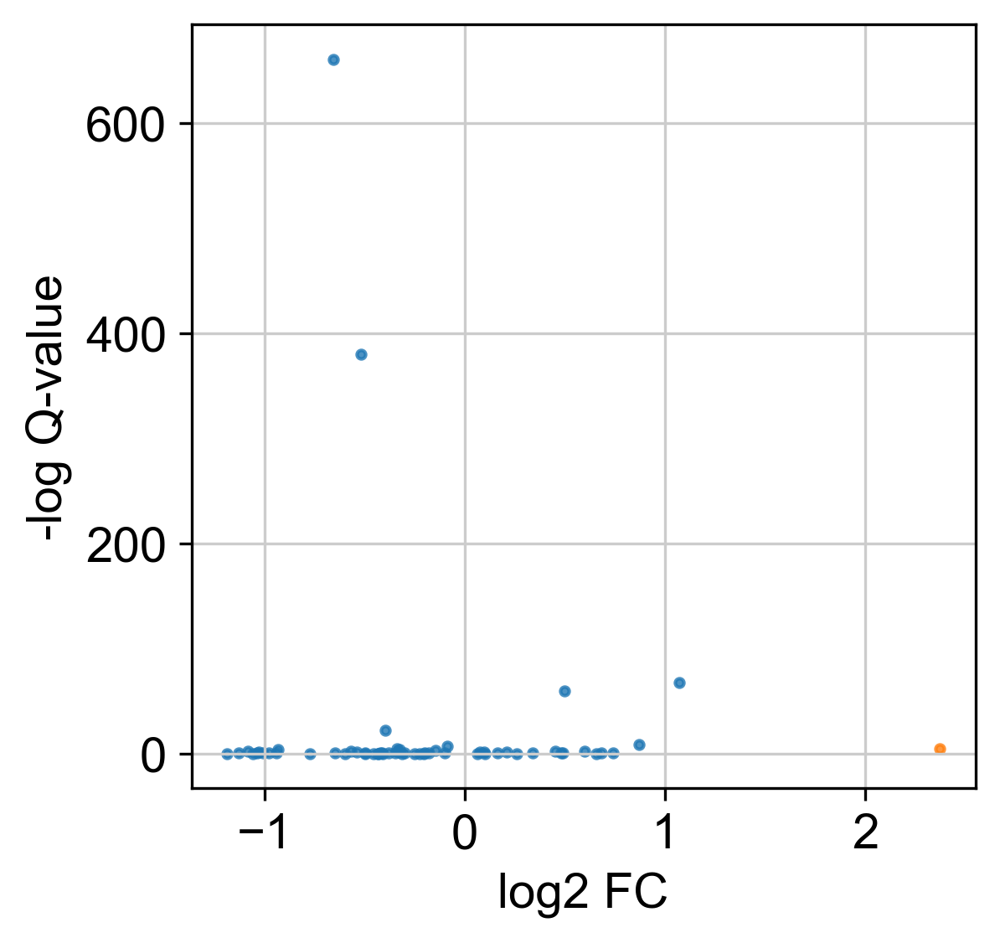

In [36]:
LOG_FOLD_CHANGE = 1.5

result = sc.get.rank_genes_groups_df(pdata, group="APC")
result["-logQ"] = -np.log(result["pvals"].astype("float"))

lowqval_de = result.loc[abs(result["logfoldchanges"]) > LOG_FOLD_CHANGE]
other_de = result.loc[abs(result["logfoldchanges"]) <= LOG_FOLD_CHANGE]

fig, ax = plt.subplots()
sns.regplot(
    x=other_de["logfoldchanges"],
    y=other_de["-logQ"],
    fit_reg=False,
    scatter_kws={"s": 6},
)
sns.regplot(
    x=lowqval_de["logfoldchanges"],
    y=lowqval_de["-logQ"],
    fit_reg=False,
    scatter_kws={"s": 6},
)
ax.set_xlabel("log2 FC")
ax.set_ylabel("-log Q-value")

# if title is None:
#     title = group_key.replace("_", " ")
# plt.title(title)
plt.show()

#### condition

B cells


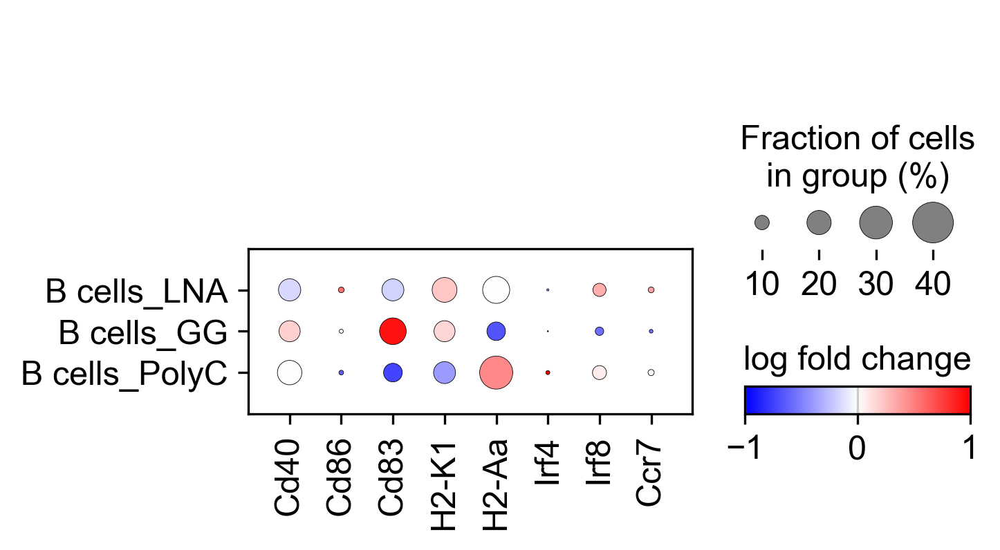

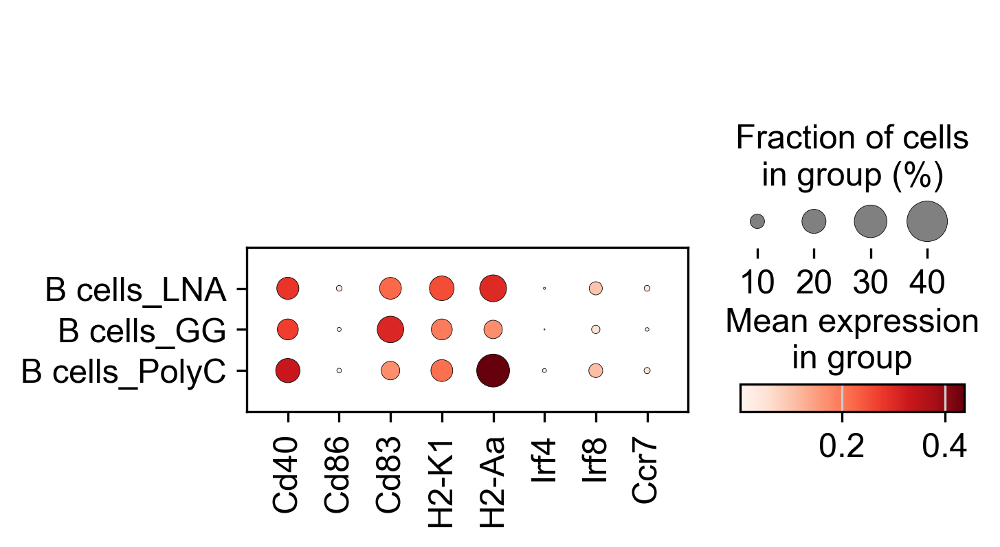

Macrophages


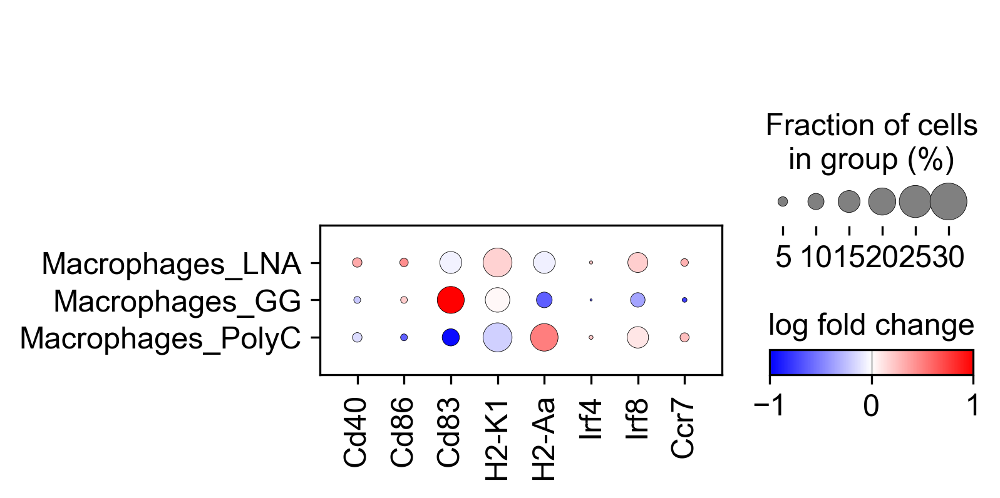

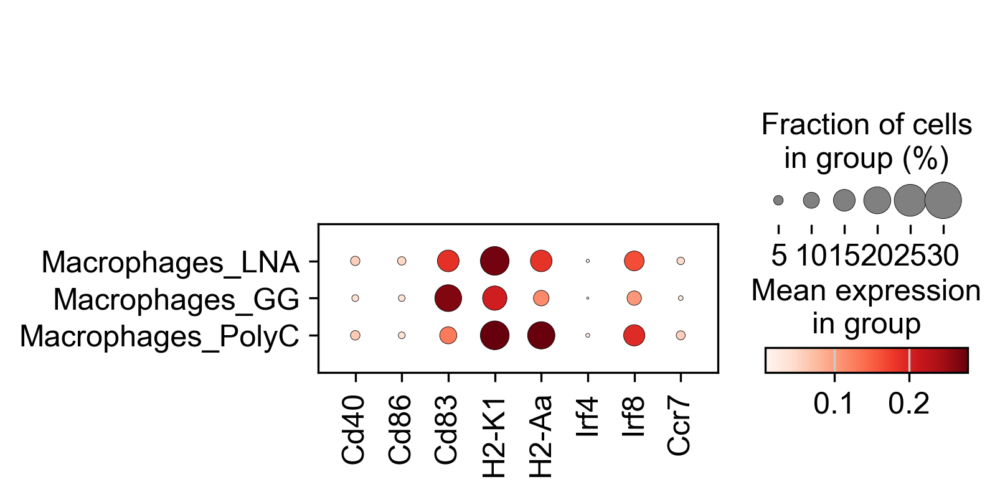

Dendritic cells


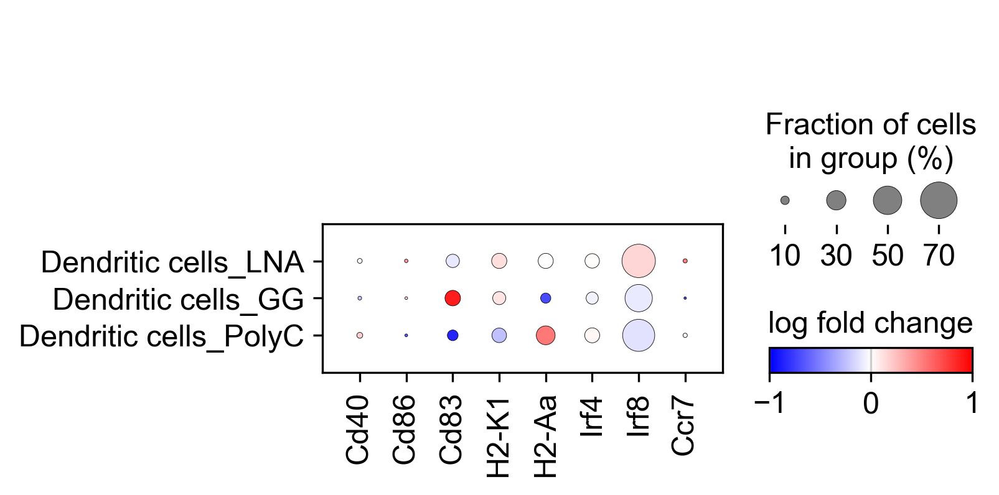

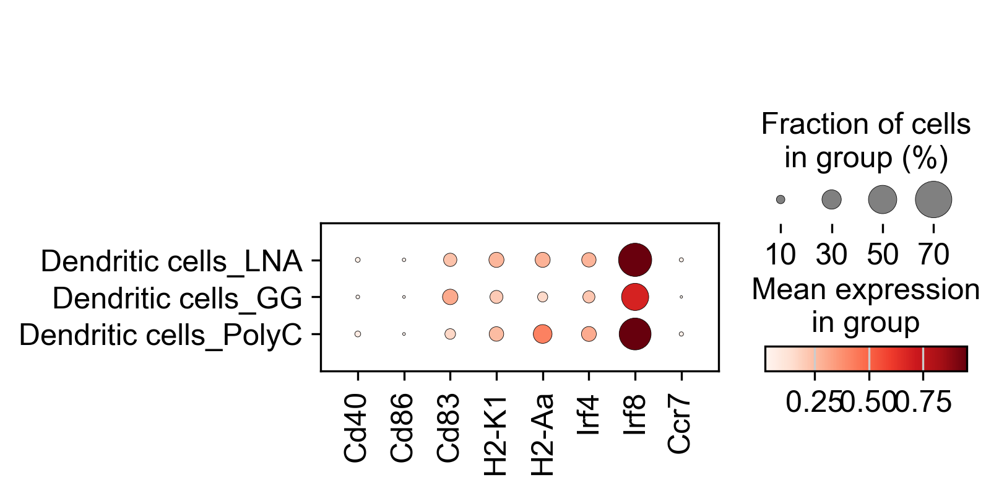

In [17]:
genes = ['Cd40', 'Cd86', 'Cd83', 'H2-K1', 'H2-Aa', 'Irf4', 'Irf8', 'Ccr7']
plot_order = ['B cells', 'Macrophages', 'Dendritic cells']

raw_cdata.obs['level_1'] = rdata.obs['level_1']
raw_cdata.obs['condition'] = rdata.obs['condition']

for current_type in plot_order:
    print(current_type)
    pdata = raw_cdata[raw_cdata.obs['level_1'] == current_type, ]
    pdata.obs['type-condition'] = pdata.obs['level_1'].astype(str) + '_' + pdata.obs['condition'].astype(str)
    
    current_order = []
    for j in ['LNA', 'GG', 'PolyC']:
        current_order.append(f"{current_type}_{j}")
    pdata.obs['type-condition'] = pdata.obs['type-condition'].astype('category')
    pdata.obs['type-condition'] = pdata.obs['type-condition'].cat.reorder_categories(current_order)

    # Add log layer
    pdata.layers['log_raw'] = np.log1p(pdata.layers['raw'])
    sc.pp.normalize_total(pdata, layer='log_raw')
    
    # Find gene markers for each cluster
    sc.tl.rank_genes_groups(pdata, 'type-condition', method='wilcoxon', layer='log_raw', pts=False, use_raw=False, n_genes=pdata.shape[1])
    
    sc.pl.rank_genes_groups_dotplot(pdata, key='rank_genes_groups', var_names=genes, dendrogram=False, values_to_plot='logfoldchanges', cmap='bwr', vmin=-1, vmax=1)
    sc.pl.dotplot(pdata, genes, groupby=f'type-condition', dendrogram=False, use_raw=False, cmap='Reds', swap_axes=False)

#### sample

B cells


C:\Users\jiahao\AppData\Local\Temp\ipykernel_50924\689890808.py:9: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  pdata.obs['type-sample'] = pdata.obs['level_1'].astype(str) + '_' + pdata.obs['sample'].astype(str)
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\numpy\core\fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\get\get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()
C:\Users\jiahao\.c

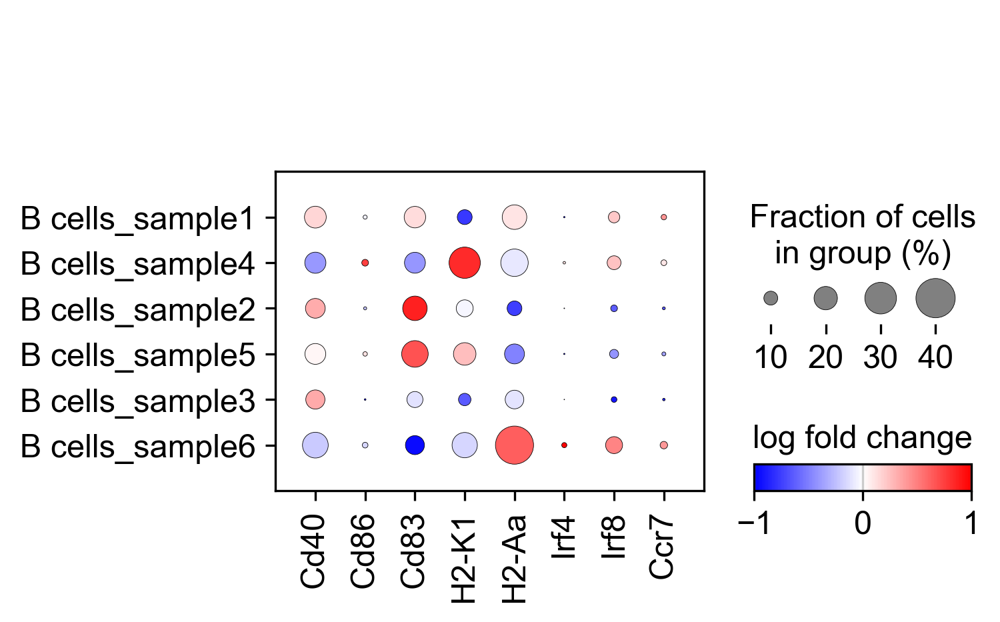

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


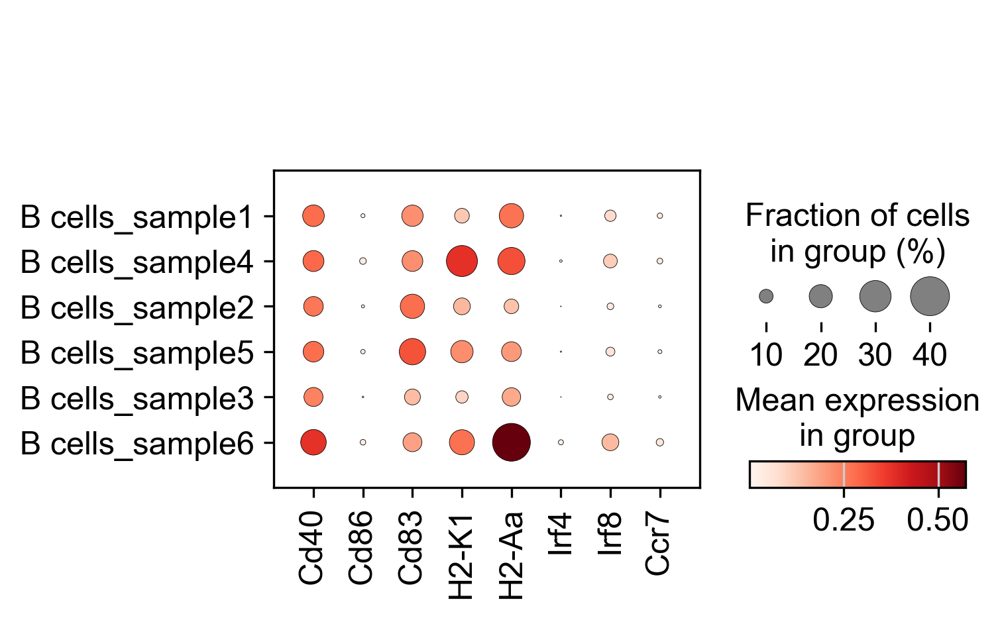

Macrophages


C:\Users\jiahao\AppData\Local\Temp\ipykernel_50924\689890808.py:9: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  pdata.obs['type-sample'] = pdata.obs['level_1'].astype(str) + '_' + pdata.obs['sample'].astype(str)
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\numpy\core\fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\get\get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()
C:\Users\jiahao\.c

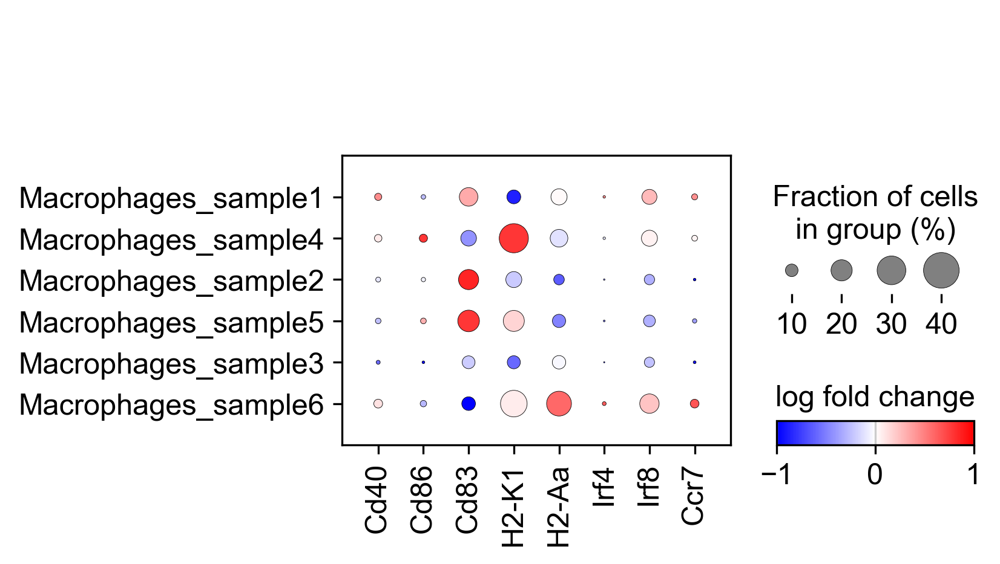

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


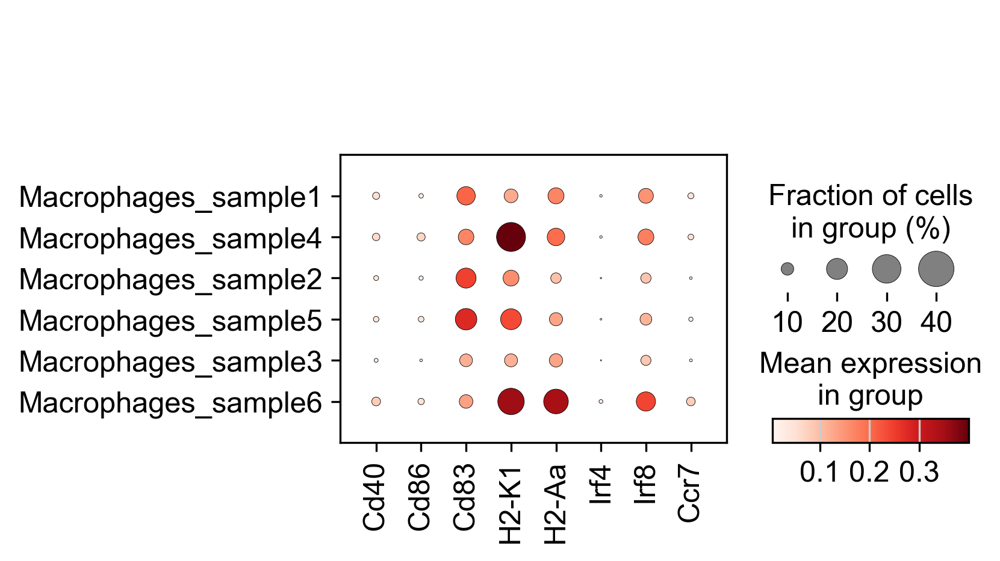

Dendritic cells


C:\Users\jiahao\AppData\Local\Temp\ipykernel_50924\689890808.py:9: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  pdata.obs['type-sample'] = pdata.obs['level_1'].astype(str) + '_' + pdata.obs['sample'].astype(str)
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\numpy\core\fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\get\get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()
C:\Users\jiahao\.c

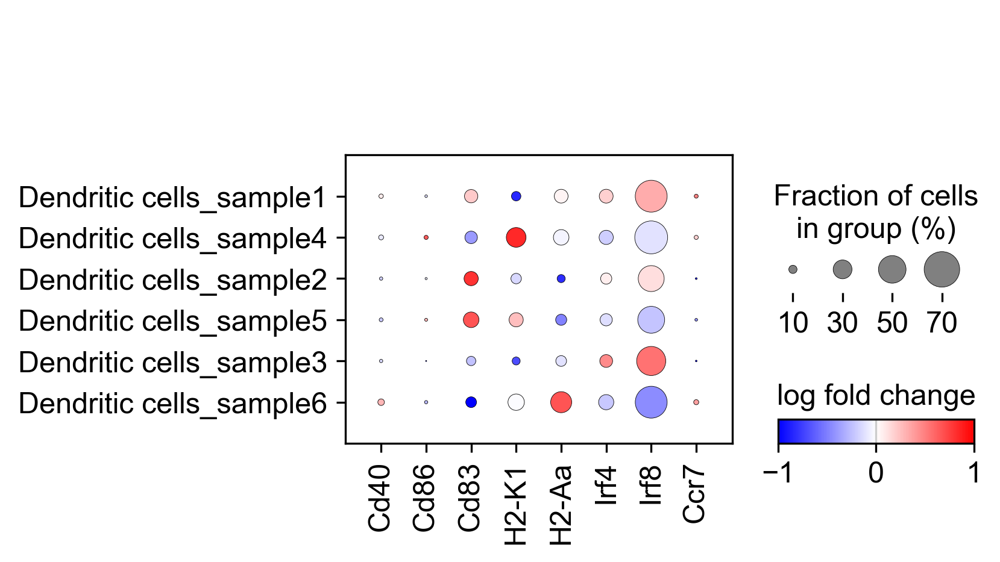

C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
C:\Users\jiahao\.conda\envs\sc_39\lib\site-packages\scanpy\plotting\_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


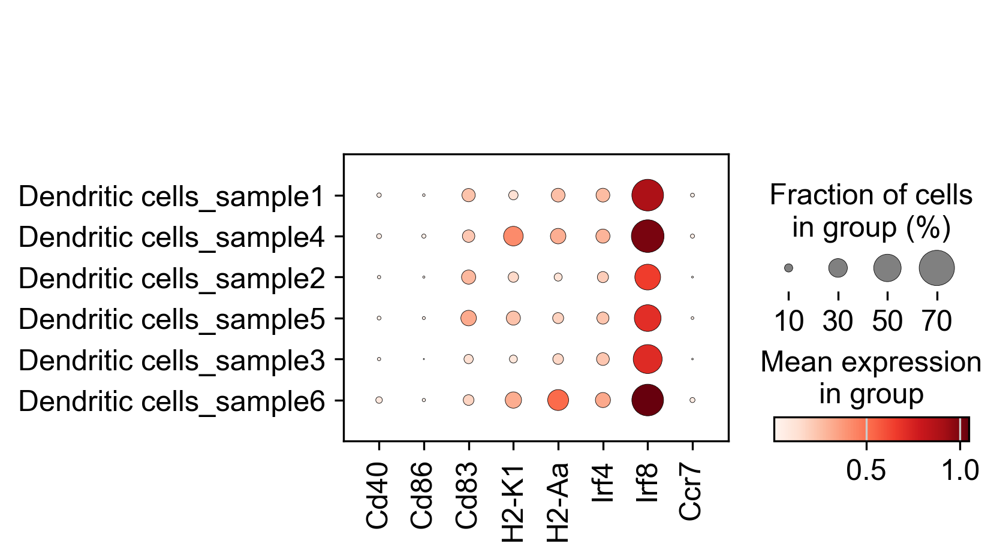

In [15]:
genes = ['Cd40', 'Cd86', 'Cd83', 'H2-K1', 'H2-Aa', 'Irf4', 'Irf8', 'Ccr7']
plot_order = ['B cells', 'Macrophages', 'Dendritic cells']

raw_cdata.obs['level_1'] = rdata.obs['level_1']

for current_type in plot_order:
    print(current_type)
    pdata = raw_cdata[raw_cdata.obs['level_1'] == current_type, ]
    pdata.obs['type-sample'] = pdata.obs['level_1'].astype(str) + '_' + pdata.obs['sample'].astype(str)
    
    current_order = []
    for j in ['sample1', 'sample4', 'sample2', 'sample5', 'sample3', 'sample6']:
        current_order.append(f"{current_type}_{j}")
    pdata.obs['type-sample'] = pdata.obs['type-sample'].astype('category')
    pdata.obs['type-sample'] = pdata.obs['type-sample'].cat.reorder_categories(current_order)

    # Add log layer
    pdata.layers['log_raw'] = np.log1p(pdata.layers['raw'])
    sc.pp.normalize_total(pdata, layer='log_raw')
    
    # Find gene markers for each cluster
    sc.tl.rank_genes_groups(pdata, 'type-sample', method='wilcoxon', layer='log_raw', pts=False, use_raw=False, n_genes=pdata.shape[1])
    
    sc.pl.rank_genes_groups_dotplot(pdata, key='rank_genes_groups', var_names=genes, dendrogram=False, values_to_plot='logfoldchanges', cmap='bwr', vmin=-1, vmax=1)
    sc.pl.dotplot(pdata, genes, groupby=f'type-sample', dendrogram=False, use_raw=False, cmap='Reds', swap_axes=False)

In [ ]:
FDR = 0.01
LOG_FOLD_CHANGE = 1.5


def volcano_plot(adata, group_key, group_name="cell_type", groupby="label", title=None):
    cell_type = "_".join(group_key.split("_")[1:])
    result = sc.get.rank_genes_groups_df(adata, group=cell_type, key=group_key).copy()
    result["-logQ"] = -np.log(result["pvals"].astype("float"))
    lowqval_de = result.loc[abs(result["logfoldchanges"]) > LOG_FOLD_CHANGE]
    other_de = result.loc[abs(result["logfoldchanges"]) <= LOG_FOLD_CHANGE]

    fig, ax = plt.subplots()
    sns.regplot(
        x=other_de["logfoldchanges"],
        y=other_de["-logQ"],
        fit_reg=False,
        scatter_kws={"s": 6},
    )
    sns.regplot(
        x=lowqval_de["logfoldchanges"],
        y=lowqval_de["-logQ"],
        fit_reg=False,
        scatter_kws={"s": 6},
    )
    ax.set_xlabel("log2 FC")
    ax.set_ylabel("-log Q-value")

    if title is None:
        title = group_key.replace("_", " ")
    plt.title(title)
    plt.show()

## Spatial analysis

### 2D

In [ ]:
spatia2d = rdata.obs.loc[:, ['global_x', 'global_y']].values
spatia2d = spatia2d * [0.194, 0.194]

rdata.obsm['spatial'] = spatia2d

In [ ]:
adata_list = [rdata[(rdata.obs['sample'] == i), ] for i in rdata.obs['sample'].cat.categories]

#### WT

In [ ]:
wt_adata = ad.concat([adata_list[0], adata_list[1]], uns_merge="same")
wt_adata

In [ ]:
sq.gr.spatial_neighbors(wt_adata, library_key='sample', coord_type="generic", delaunay=True, percentile=99)

In [ ]:
sq.gr.nhood_enrichment(wt_adata, cluster_key="level_3")
sq.pl.nhood_enrichment(wt_adata, cluster_key="level_3", method="single", cmap="inferno", vmin=-50, vmax=100)

In [ ]:
nr_df = pd.DataFrame(wt_adata.uns['level_3_nhood_enrichment']['zscore'], columns=wt_adata.obs['level_3'].cat.categories, index=wt_adata.obs['level_3'].cat.categories)
pl_type = nr_df.columns[nr_df.columns != 'NA']
sns.clustermap(nr_df.loc[pl_type, pl_type], vmin=-50, vmax=100, figsize=(10,10),  cbar_pos=(0, .2, .03, .4))
plt.savefig(os.path.join(fig_path, 'nhood_enrichment_2d_level_3_WT.pdf'), dpi=300)

In [ ]:
sq.gr.nhood_enrichment(wt_adata, cluster_key="level_2")
sq.pl.nhood_enrichment(wt_adata, cluster_key="level_2", method="single", cmap="inferno", vmin=-50, vmax=100)

In [ ]:
nr_df = pd.DataFrame(wt_adata.uns['level_2_nhood_enrichment']['zscore'], columns=wt_adata.obs['level_2'].cat.categories, index=wt_adata.obs['level_2'].cat.categories)
pl_type = nr_df.columns[nr_df.columns != 'NA']
sns.clustermap(nr_df.loc[pl_type, pl_type], vmin=-50, vmax=100, figsize=(10,10),  cbar_pos=(0, .2, .03, .4))
plt.savefig(os.path.join(fig_path, 'nhood_enrichment_2d_level_2_WT.pdf'), dpi=300)

#### 99R

In [ ]:
r99_adata = ad.concat([adata_list[2], adata_list[3]], uns_merge="same")
r99_adata

In [ ]:
sq.gr.spatial_neighbors(r99_adata, library_key='sample', coord_type="generic", delaunay=True, percentile=99)

In [ ]:
sq.gr.nhood_enrichment(r99_adata, cluster_key="level_3")
sq.pl.nhood_enrichment(r99_adata, cluster_key="level_3", method="single", cmap="inferno", vmin=-50, vmax=100)

In [ ]:
nr_df = pd.DataFrame(r99_adata.uns['level_3_nhood_enrichment']['zscore'], columns=r99_adata.obs['level_3'].cat.categories, index=r99_adata.obs['level_3'].cat.categories)
pl_type = nr_df.columns[nr_df.columns != 'NA']
sns.clustermap(nr_df.loc[pl_type, pl_type], vmin=-50, vmax=100, figsize=(10,10),  cbar_pos=(0, .2, .03, .4))
plt.savefig(os.path.join(fig_path, 'nhood_enrichment_2d_level_3_99R.pdf'), dpi=300)

In [ ]:
sq.gr.nhood_enrichment(r99_adata, cluster_key="level_2")
sq.pl.nhood_enrichment(r99_adata, cluster_key="level_2", method="single", cmap="inferno", vmin=-50, vmax=100)

In [ ]:
nr_df = pd.DataFrame(r99_adata.uns['level_2_nhood_enrichment']['zscore'], columns=r99_adata.obs['level_2'].cat.categories, index=r99_adata.obs['level_2'].cat.categories)
pl_type = nr_df.columns[nr_df.columns != 'NA']
sns.clustermap(nr_df.loc[pl_type, pl_type], vmin=-50, vmax=100, figsize=(10,10),  cbar_pos=(0, .2, .03, .4))
plt.savefig(os.path.join(fig_path, 'nhood_enrichment_2d_level_2_99R.pdf'), dpi=300)

#### 33NM

In [ ]:
n33_adata = ad.concat([adata_list[4], adata_list[5]], uns_merge="same")
n33_adata

In [ ]:
sq.gr.spatial_neighbors(n33_adata, library_key='sample', coord_type="generic", delaunay=True, percentile=99)

In [ ]:
sq.gr.nhood_enrichment(n33_adata, cluster_key="level_3")
sq.pl.nhood_enrichment(n33_adata, cluster_key="level_3", method="single", cmap="inferno", vmin=-50, vmax=100)

In [ ]:
nr_df = pd.DataFrame(n33_adata.uns['level_3_nhood_enrichment']['zscore'], columns=n33_adata.obs['level_3'].cat.categories, index=n33_adata.obs['level_3'].cat.categories)
pl_type = nr_df.columns[nr_df.columns != 'NA']
sns.clustermap(nr_df.loc[pl_type, pl_type], vmin=-50, vmax=100, figsize=(10,10),  cbar_pos=(0, .2, .03, .4))
plt.savefig(os.path.join(fig_path, 'nhood_enrichment_2d_level_3_33NM.pdf'), dpi=300)

In [ ]:
sq.gr.nhood_enrichment(n33_adata, cluster_key="level_2")
sq.pl.nhood_enrichment(
    n33_adata, cluster_key="level_2", method="single", cmap="inferno", vmin=-50, vmax=100
)

In [ ]:
nr_df = pd.DataFrame(n33_adata.uns['level_2_nhood_enrichment']['zscore'], columns=n33_adata.obs['level_2'].cat.categories, index=n33_adata.obs['level_2'].cat.categories)
pl_type = nr_df.columns[nr_df.columns != 'NA']
sns.clustermap(nr_df.loc[pl_type, pl_type], vmin=-50, vmax=100, figsize=(10,10),  cbar_pos=(0, .2, .03, .4))
plt.savefig(os.path.join(fig_path, 'nhood_enrichment_2d_level_2_33NM.pdf'), dpi=300)

### 3D

In [37]:
spatia3d = rdata.obs.loc[:, ['global_x', 'global_y', 'global_z']].values
spatia3d = spatia3d * [0.194, 0.194, 0.346]

rdata.obsm['spatial'] = spatia3d

In [38]:
rdata.obs['level_3'].cat.categories

Index(['Activated Macrophages', 'B cells', 'CD4+ T cells', 'CD8+ T cells',
       'Endothelial cells', 'Macrophages', 'Monocytes', 'NA', 'NK cells',
       'Naive CD4+ T cells', 'Naive CD8+ T cells', 'Other Dendritic cells',
       'PD-1+ T cells', 'T cells', 'Th1', 'Th2', 'Th17', 'Treg', 'cDC1',
       'cDC2'],
      dtype='object')

In [42]:
rdata.obs['level_2_eh'] = rdata.obs['level_2'].values
rdata.obs['level_2_eh'] = rdata.obs['level_2_eh'].astype(object)
apc_cells = rdata.obs['APC'] != 'NA'
rdata.obs.loc[apc_cells, 'level_2_eh'] = rdata.obs.loc[apc_cells, 'level_2'].astype(str) + '_' + rdata.obs.loc[apc_cells, 'APC'].astype(str)
rdata.obs['level_2_eh'] = rdata.obs['level_2_eh'].astype('category')

In [44]:
rdata.obs['level_3_eh'] = rdata.obs['level_3'].values
rdata.obs['level_3_eh'] = rdata.obs['level_3_eh'].astype(object)
apc_cells = rdata.obs['APC'] != 'NA'
rdata.obs.loc[apc_cells, 'level_3_eh'] = rdata.obs.loc[apc_cells, 'level_3'].astype(str) + '_' + rdata.obs.loc[apc_cells, 'APC'].astype(str)
rdata.obs['level_3_eh'] = rdata.obs['level_3_eh'].astype('category')

In [45]:
adata_list = [rdata[(rdata.obs['sample'] == i), ] for i in rdata.obs['sample'].cat.categories]

In [49]:
rdata.obs['level_3_eh'].cat.categories

Index(['Activated Macrophages', 'B cells', 'CD4+ T cells', 'CD8+ T cells',
       'Endothelial cells', 'Macrophages', 'Monocytes', 'NA', 'NK cells',
       'Naive CD4+ T cells', 'Naive CD8+ T cells', 'Other Dendritic cells_APC',
       'Other Dendritic cells_Non-APC', 'PD-1+ T cells', 'T cells', 'Th1',
       'Th17', 'Th2', 'Treg', 'cDC1_APC', 'cDC1_Non-APC', 'cDC2_APC',
       'cDC2_Non-APC'],
      dtype='object')

In [59]:
apc_order = [
'cDC1_APC',
'cDC2_APC',
'Other Dendritic cells_APC',
]

In [66]:
l2_order = [
'B cells',
'Monocytes',
'Macrophages',
'Activated Macrophages',
'T cells',
'CD4+ T cells',
'CD8+ T cells',
]

In [52]:
l3_order = [
'B cells',
'Monocytes',
'Macrophages',
'Activated Macrophages',
'T cells',
'Treg',
'Th17',
'Th1',
'Th2',
'Naive CD4+ T cells',
'CD4+ T cells',
'Naive CD8+ T cells',
'CD8+ T cells',
'PD-1+ T cells',
]

#### LNA

In [46]:
lna_adata = ad.concat([adata_list[0], adata_list[3]], uns_merge="same")
lna_adata

AnnData object with n_obs × n_vars = 1420794 × 61
    obs: 'sample', 'fov_id', 'volume', 'fov_x', 'fov_y', 'fov_z', 'seg_label', 'global_x', 'global_y', 'global_z', 'condition', 'replicate', 'unique_index', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'region', 'n_counts', 'n_genes', 'level_1', 'level_2', 'level_3', 'APC', 'level_2_eh', 'level_3_eh'
    obsm: 'spatial'
    layers: 'scaled'

In [47]:
sq.gr.spatial_neighbors(lna_adata, library_key='sample', coord_type="generic", delaunay=True, percentile=90)

  0%|          | 0/1000 [00:00<?, ?/s]

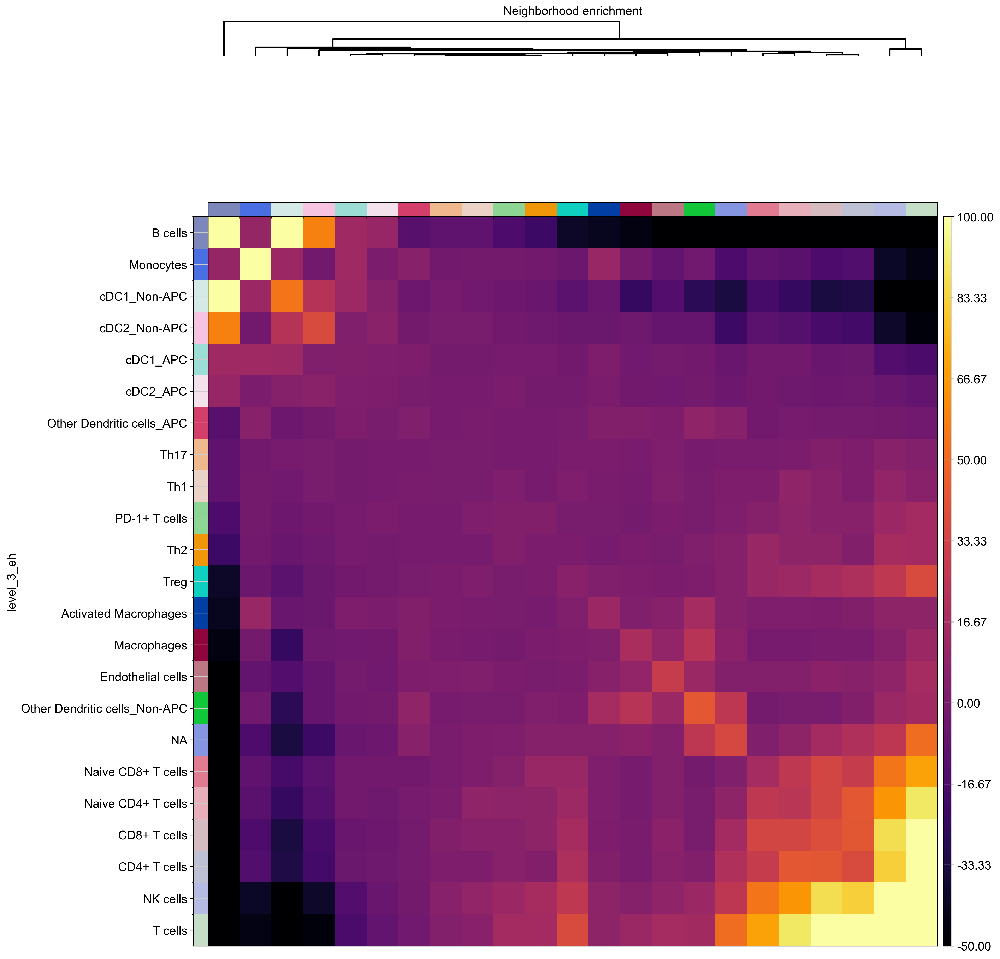

In [48]:
sq.gr.nhood_enrichment(lna_adata, cluster_key="level_3_eh")
sq.pl.nhood_enrichment(lna_adata, cluster_key="level_3_eh", method="single", cmap="inferno", vmin=-50, vmax=100)

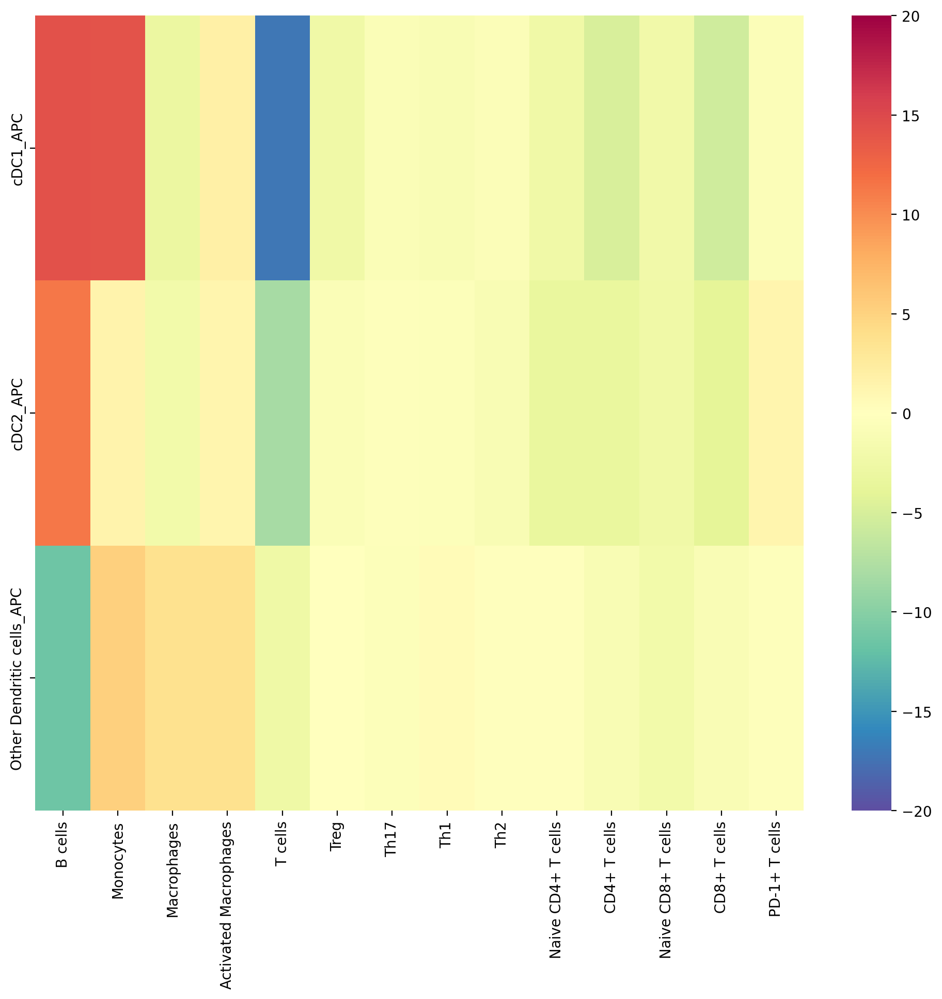

In [62]:
nr_df = pd.DataFrame(lna_adata.uns['level_3_eh_nhood_enrichment']['zscore'], columns=lna_adata.obs['level_3_eh'].cat.categories, index=lna_adata.obs['level_3_eh'].cat.categories)
fig, ax = plt.subplots(figsize=(12, 10))
sns.heatmap(nr_df.loc[apc_order, l3_order], vmin=-20, vmax=20, cmap='Spectral_r')
# plt.savefig(os.path.join(fig_path, 'nhood_enrichment_3d_level_3_WT.pdf'), dpi=300)
plt.show()

  0%|          | 0/1000 [00:00<?, ?/s]

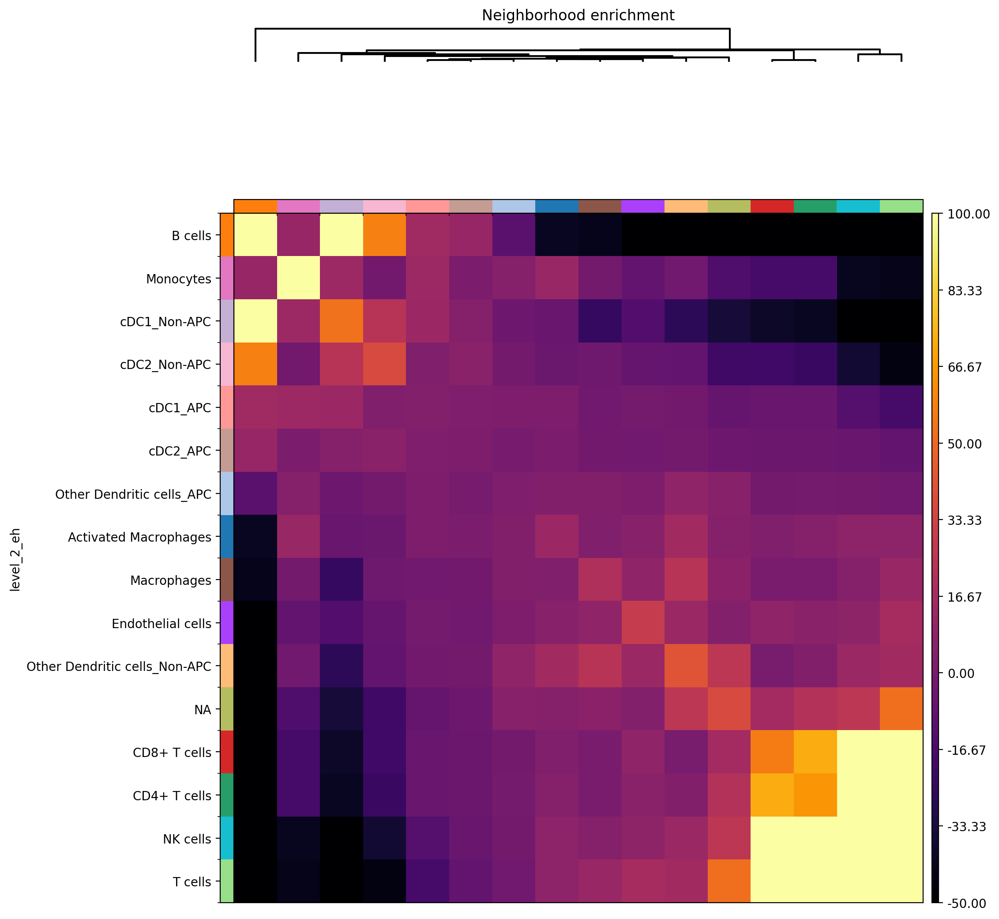

In [63]:
sq.gr.nhood_enrichment(lna_adata, cluster_key="level_2_eh")
sq.pl.nhood_enrichment(lna_adata, cluster_key="level_2_eh", method="single", cmap="inferno", vmin=-50, vmax=100)

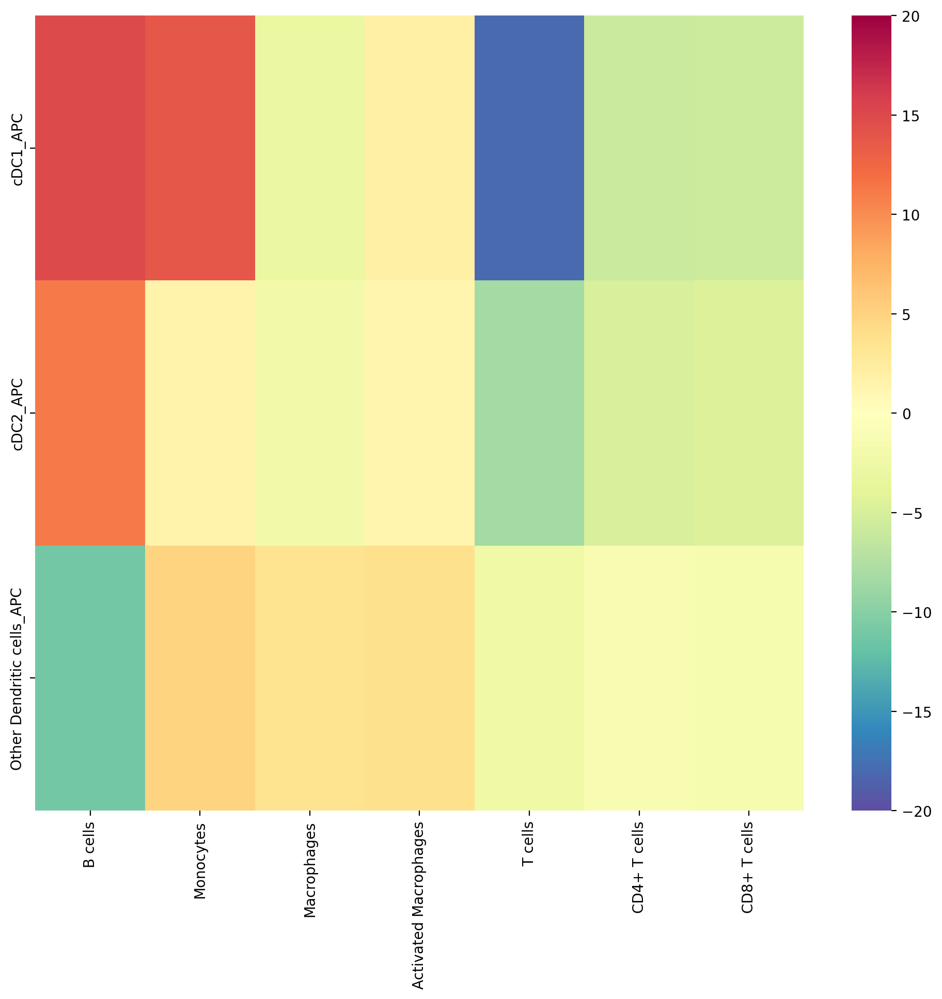

In [67]:
nr_df = pd.DataFrame(lna_adata.uns['level_2_eh_nhood_enrichment']['zscore'], columns=lna_adata.obs['level_2_eh'].cat.categories, index=lna_adata.obs['level_2_eh'].cat.categories)
fig, ax = plt.subplots(figsize=(12, 10))
sns.heatmap(nr_df.loc[apc_order, l2_order], vmin=-20, vmax=20, cmap='Spectral_r')
# plt.savefig(os.path.join(fig_path, 'nhood_enrichment_3d_level_2_WT.pdf'), dpi=300)
plt.show()

#### GG

In [68]:
gg_adata = ad.concat([adata_list[1], adata_list[4]], uns_merge="same")
gg_adata

AnnData object with n_obs × n_vars = 1288095 × 61
    obs: 'sample', 'fov_id', 'volume', 'fov_x', 'fov_y', 'fov_z', 'seg_label', 'global_x', 'global_y', 'global_z', 'condition', 'replicate', 'unique_index', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'region', 'n_counts', 'n_genes', 'level_1', 'level_2', 'level_3', 'APC', 'level_2_eh', 'level_3_eh'
    obsm: 'spatial'
    layers: 'scaled'

In [69]:
sq.gr.spatial_neighbors(gg_adata, library_key='sample', coord_type="generic", delaunay=True, percentile=99)

  0%|          | 0/1000 [00:00<?, ?/s]

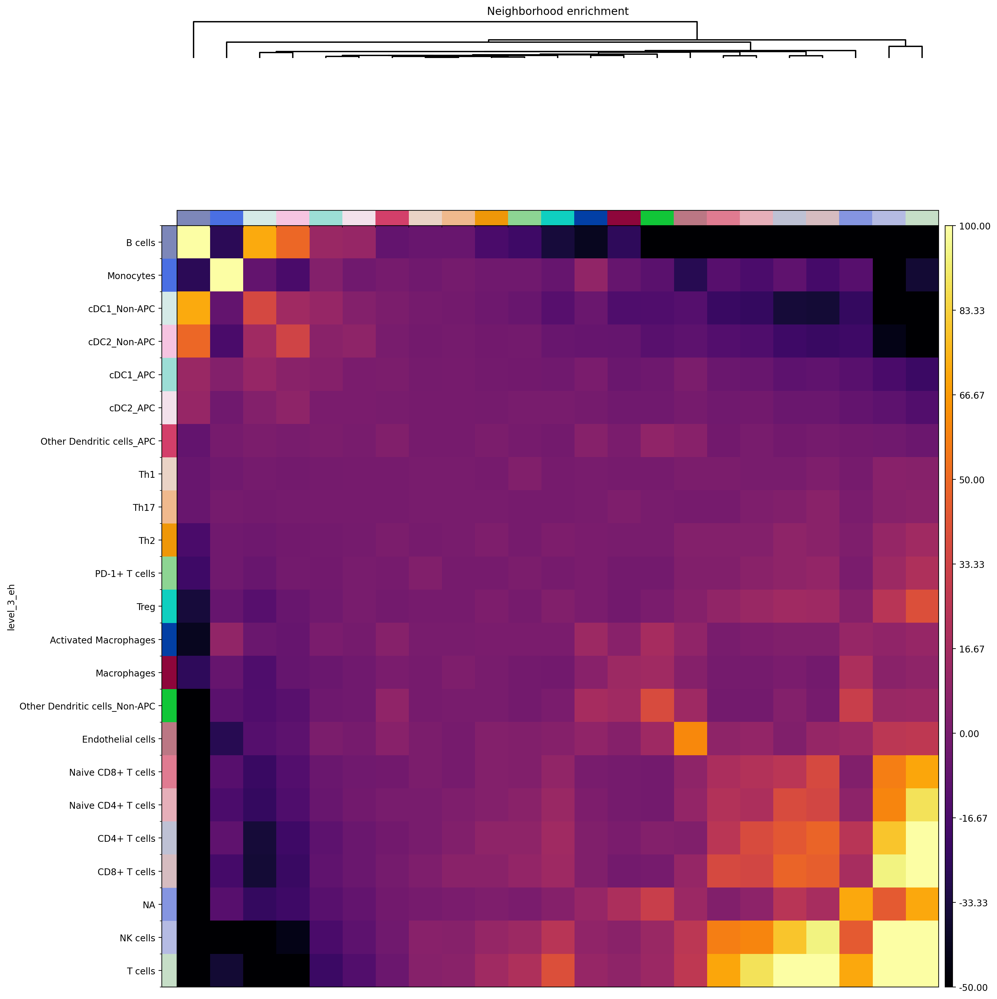

In [71]:
sq.gr.nhood_enrichment(gg_adata, cluster_key="level_3_eh")
sq.pl.nhood_enrichment(gg_adata, cluster_key="level_3_eh", method="single", cmap="inferno", vmin=-50, vmax=100)

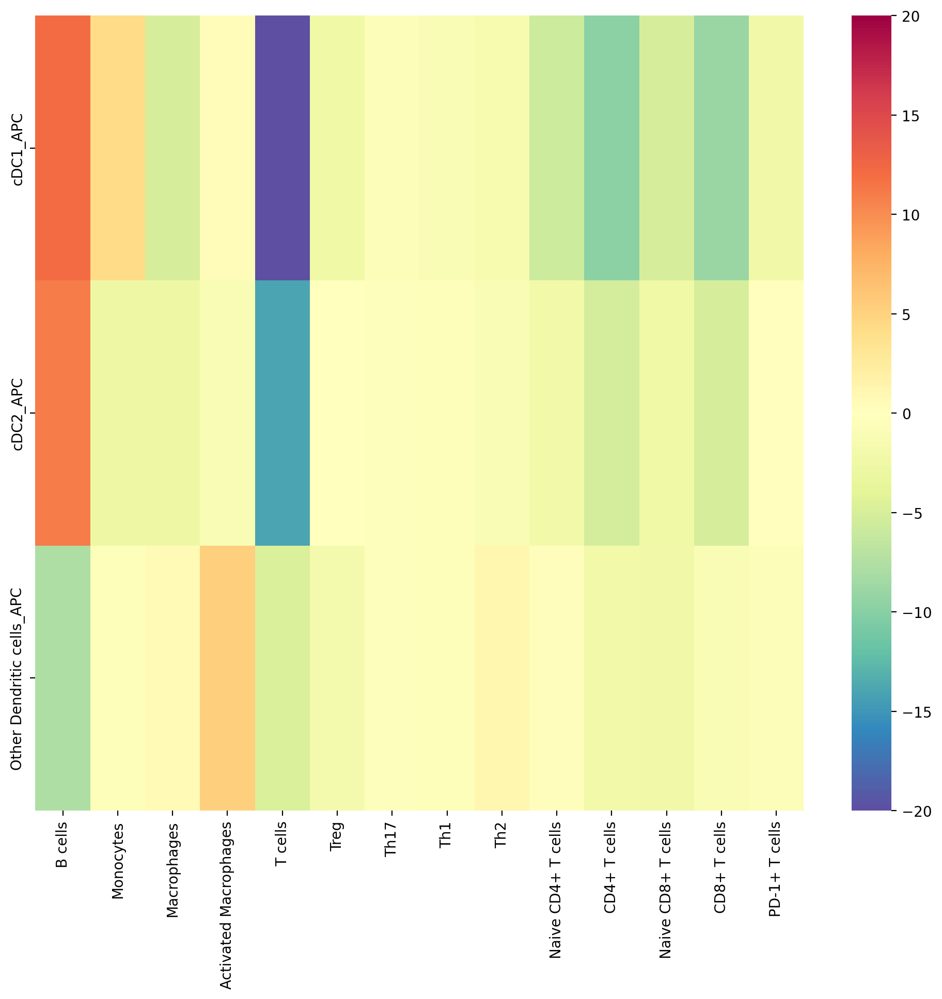

In [72]:
nr_df = pd.DataFrame(gg_adata.uns['level_3_eh_nhood_enrichment']['zscore'], columns=gg_adata.obs['level_3_eh'].cat.categories, index=gg_adata.obs['level_3_eh'].cat.categories)
fig, ax = plt.subplots(figsize=(12, 10))
sns.heatmap(nr_df.loc[apc_order, l3_order], vmin=-20, vmax=20, cmap='Spectral_r')
# plt.savefig(os.path.join(fig_path, 'nhood_enrichment_3d_level_3_WT.pdf'), dpi=300)
plt.show()

  0%|          | 0/1000 [00:00<?, ?/s]

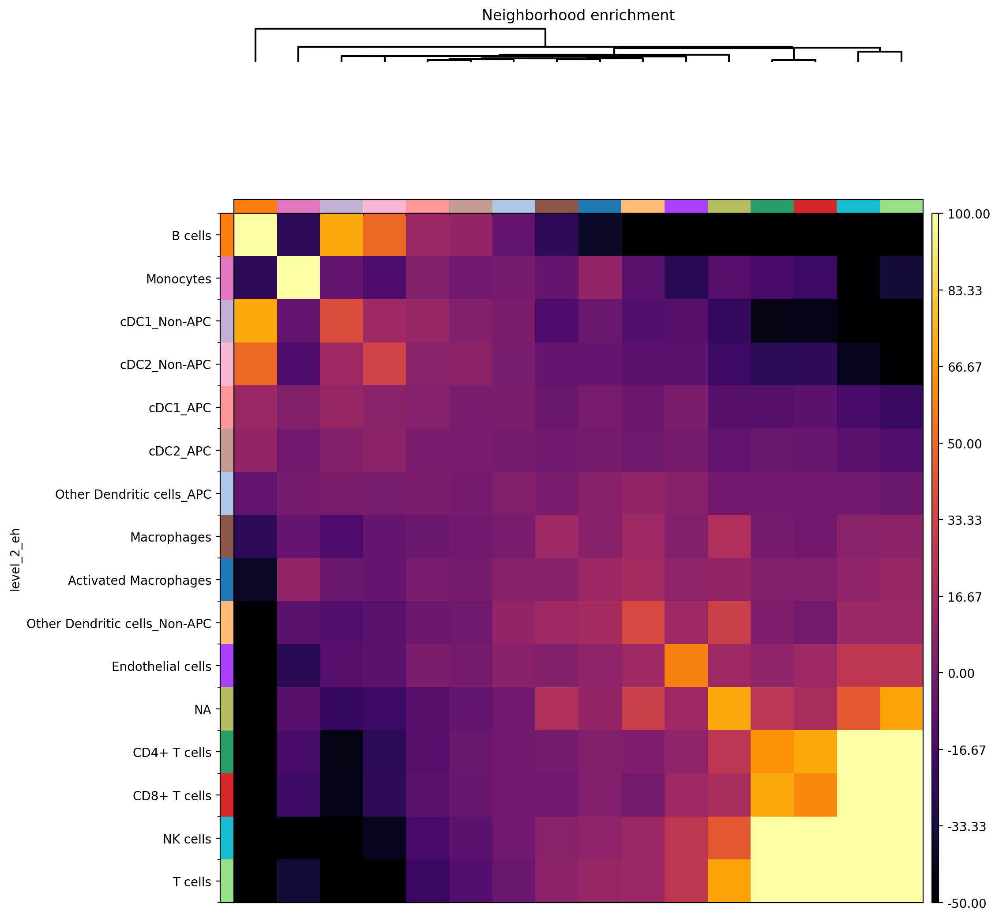

In [73]:
sq.gr.nhood_enrichment(gg_adata, cluster_key="level_2_eh")
sq.pl.nhood_enrichment(gg_adata, cluster_key="level_2_eh", method="single", cmap="inferno", vmin=-50, vmax=100)

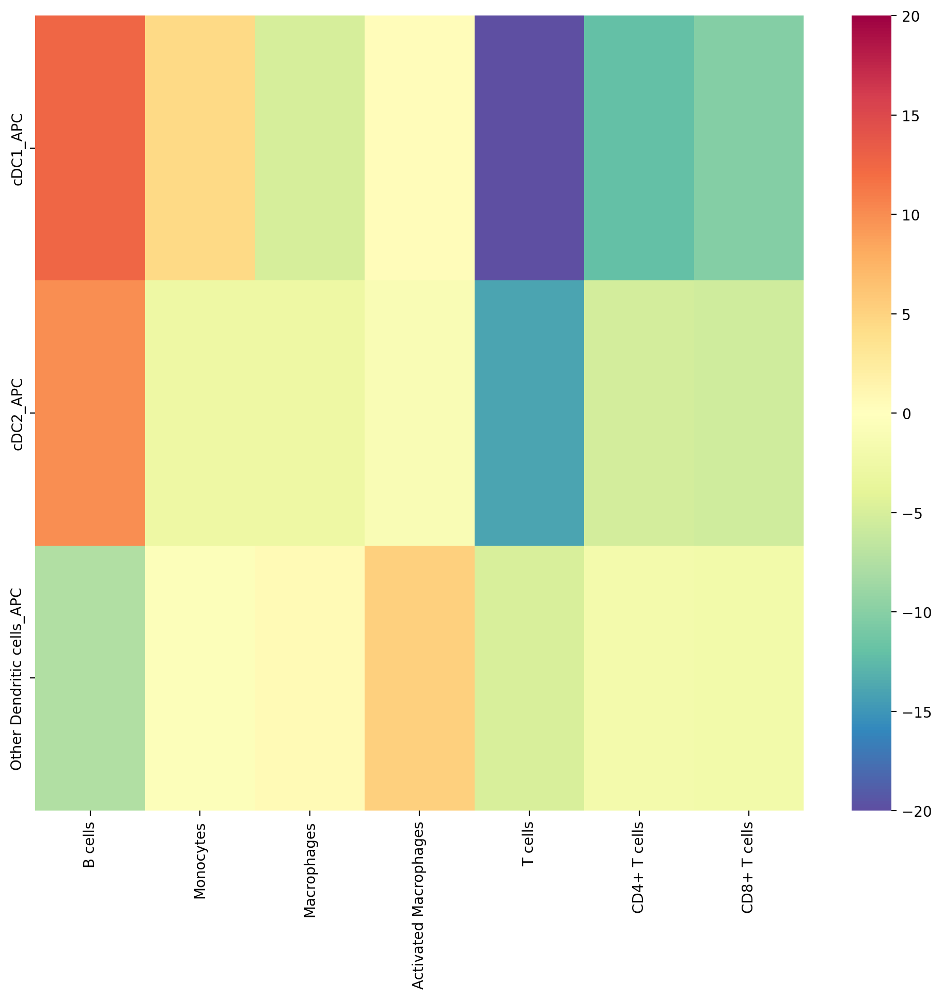

In [74]:
nr_df = pd.DataFrame(gg_adata.uns['level_2_eh_nhood_enrichment']['zscore'], columns=gg_adata.obs['level_2_eh'].cat.categories, index=gg_adata.obs['level_2_eh'].cat.categories)
fig, ax = plt.subplots(figsize=(12, 10))
sns.heatmap(nr_df.loc[apc_order, l2_order], vmin=-20, vmax=20, cmap='Spectral_r')
# plt.savefig(os.path.join(fig_path, 'nhood_enrichment_3d_level_2_WT.pdf'), dpi=300)
plt.show()

#### PolyC

In [75]:
pc_adata = ad.concat([adata_list[2], adata_list[5]], uns_merge="same")
pc_adata

AnnData object with n_obs × n_vars = 1345213 × 61
    obs: 'sample', 'fov_id', 'volume', 'fov_x', 'fov_y', 'fov_z', 'seg_label', 'global_x', 'global_y', 'global_z', 'condition', 'replicate', 'unique_index', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'region', 'n_counts', 'n_genes', 'level_1', 'level_2', 'level_3', 'APC', 'level_2_eh', 'level_3_eh'
    obsm: 'spatial'
    layers: 'scaled'

In [76]:
sq.gr.spatial_neighbors(pc_adata, library_key='sample', coord_type="generic", delaunay=True, percentile=99)

  0%|          | 0/1000 [00:00<?, ?/s]

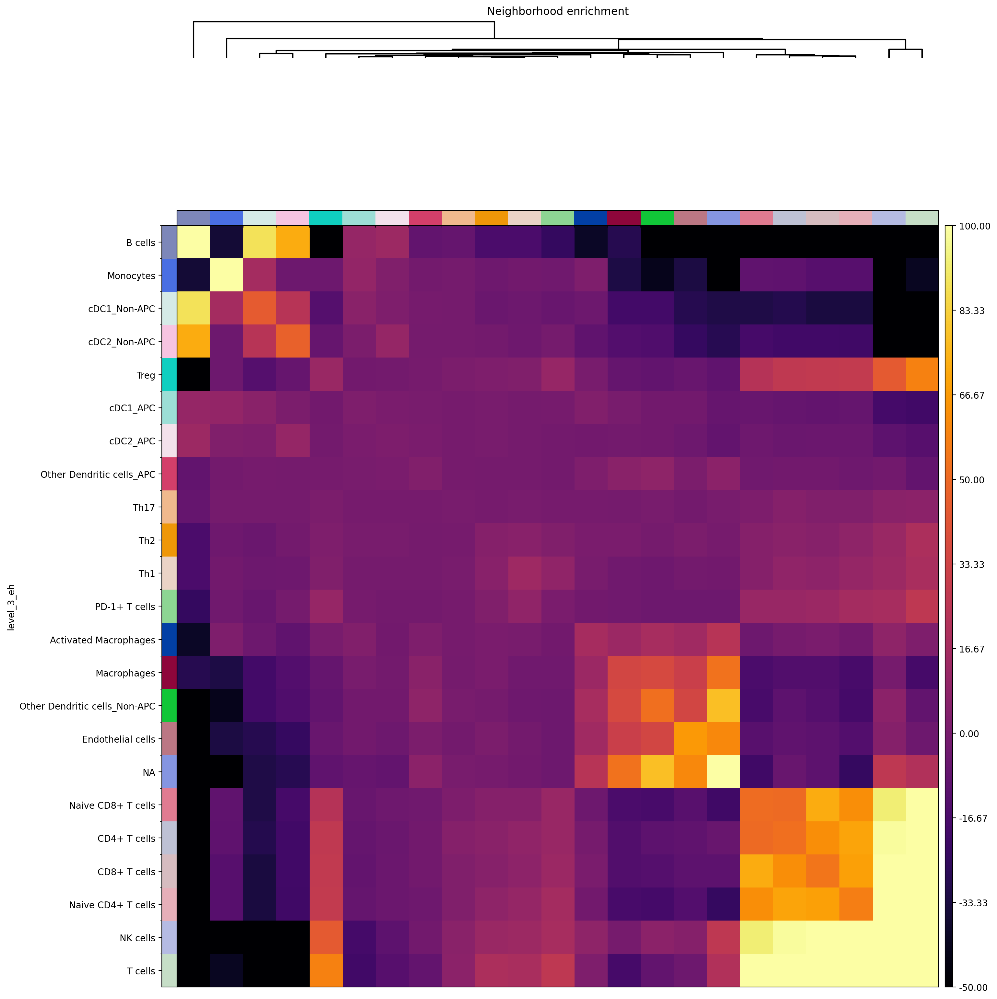

In [77]:
sq.gr.nhood_enrichment(pc_adata, cluster_key="level_3_eh")
sq.pl.nhood_enrichment(pc_adata, cluster_key="level_3_eh", method="single", cmap="inferno", vmin=-50, vmax=100)

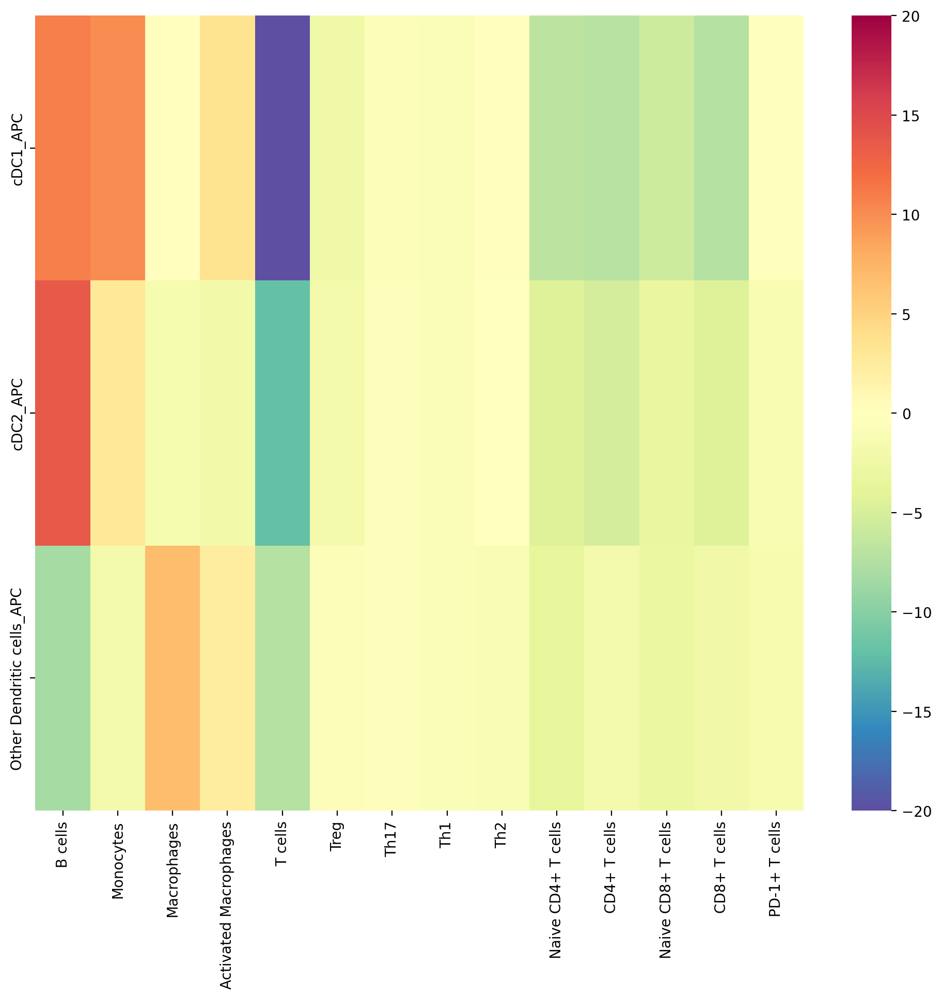

In [78]:
nr_df = pd.DataFrame(pc_adata.uns['level_3_eh_nhood_enrichment']['zscore'], columns=pc_adata.obs['level_3_eh'].cat.categories, index=pc_adata.obs['level_3_eh'].cat.categories)
fig, ax = plt.subplots(figsize=(12, 10))
sns.heatmap(nr_df.loc[apc_order, l3_order], vmin=-20, vmax=20, cmap='Spectral_r')
# plt.savefig(os.path.join(fig_path, 'nhood_enrichment_3d_level_3_WT.pdf'), dpi=300)
plt.show()

  0%|          | 0/1000 [00:00<?, ?/s]

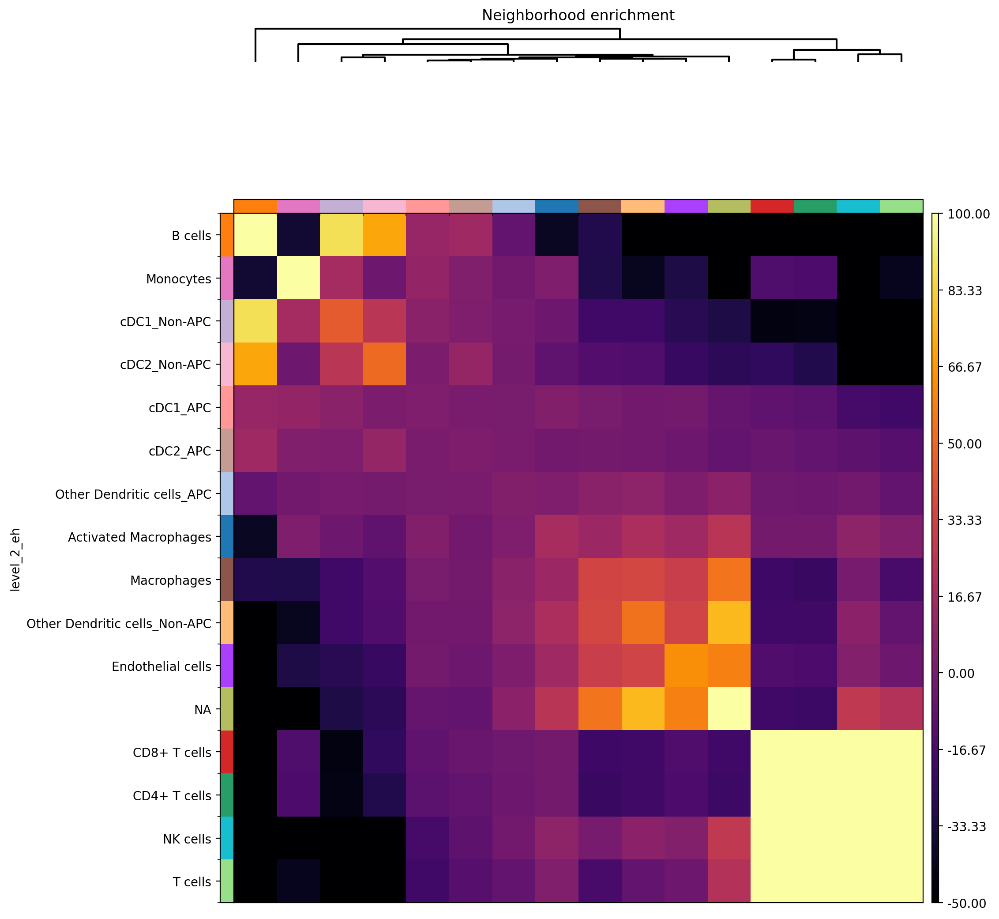

In [79]:
sq.gr.nhood_enrichment(pc_adata, cluster_key="level_2_eh")
sq.pl.nhood_enrichment(pc_adata, cluster_key="level_2_eh", method="single", cmap="inferno", vmin=-50, vmax=100)

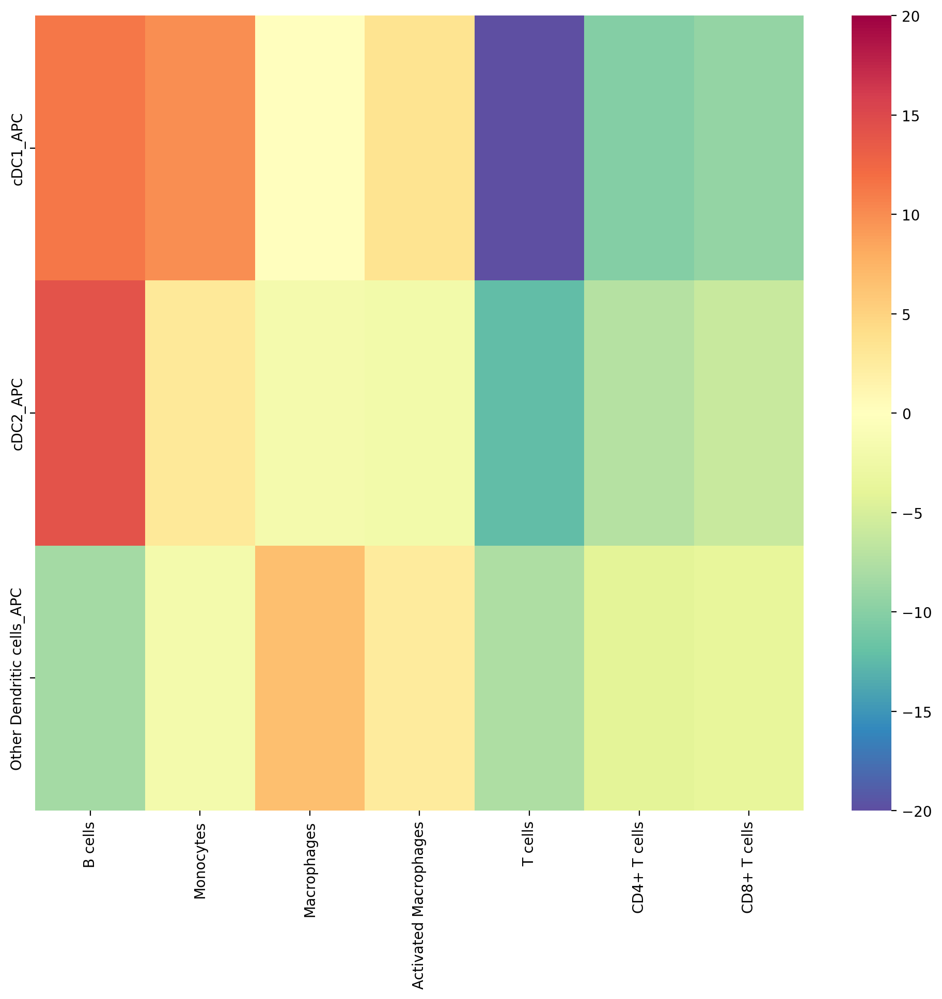

In [80]:
nr_df = pd.DataFrame(pc_adata.uns['level_2_eh_nhood_enrichment']['zscore'], columns=pc_adata.obs['level_2_eh'].cat.categories, index=pc_adata.obs['level_2_eh'].cat.categories)
fig, ax = plt.subplots(figsize=(12, 10))
sns.heatmap(nr_df.loc[apc_order, l2_order], vmin=-20, vmax=20, cmap='Spectral_r')
# plt.savefig(os.path.join(fig_path, 'nhood_enrichment_3d_level_2_WT.pdf'), dpi=300)
plt.show()

## RBD

In [35]:
positions = natsorted([d for d in os.listdir(expr_path) if "Position" in d])

total_counts_df = pd.DataFrame()
for current_position in tqdm(positions):

    reads_df = pd.read_csv(os.path.join(expr_path, current_position, 'RBD_signal.csv'))
    reads_df = reads_df.loc[reads_df['seg_label'] != 0, ]
    counts_df = pd.DataFrame(reads_df['unique_index'].value_counts())
    total_counts_df = pd.concat([total_counts_df, counts_df])

  0%|          | 0/1078 [00:00<?, ?it/s]

In [92]:
rdata.obs['RBD'] = 0
overlap_index = total_counts_df.index.intersection(rdata.obs.index)
rdata.obs.loc[overlap_index, 'RBD'] = total_counts_df.loc[overlap_index, 'count'].values
rdata.obs['RBD_log'] = np.log1p(rdata.obs['RBD'])

In [93]:
plot_order = ['B cells', 'Macrophages', 'Dendritic cells']
pdata = rdata[rdata.obs['level_1'].isin(plot_order), ]
pdata.obs['type-condition'] = pdata.obs['level_1'].astype(str) + '_' + pdata.obs['condition'].astype(str)

current_order = []
for i in plot_order:
    for j in ['LNA', 'GG', 'PolyC']:
        current_order.append(f"{i}_{j}")
pdata.obs['type-condition'] = pdata.obs['type-condition'].astype('category')
pdata.obs['type-condition'] = pdata.obs['type-condition'].cat.reorder_categories(current_order)


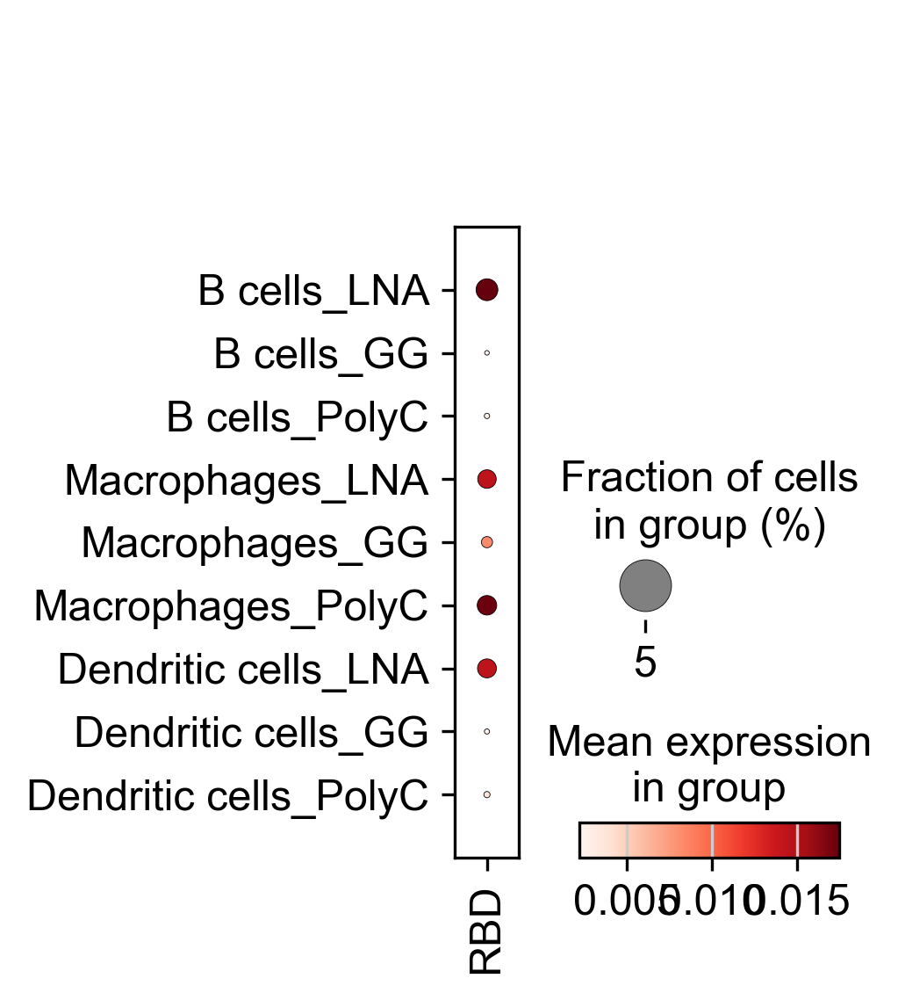

In [94]:
sc.pl.dotplot(pdata, 'RBD', groupby='type-condition', dot_max=.05)

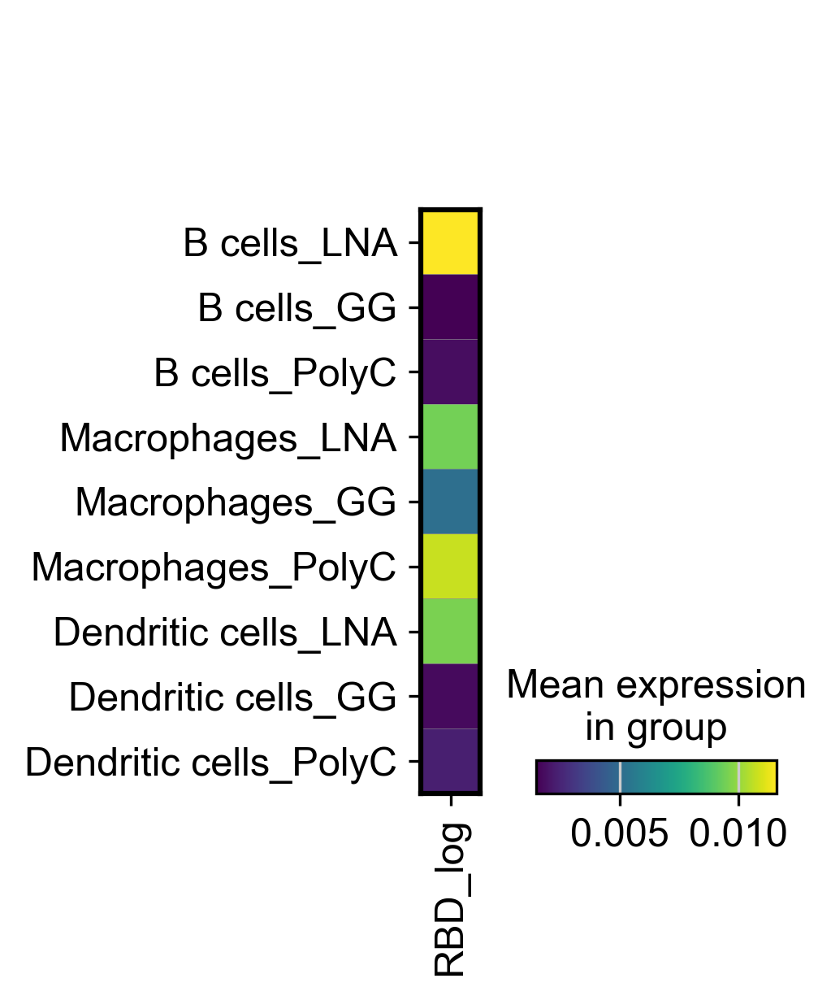

In [96]:
sc.pl.matrixplot(pdata, 'RBD_log', groupby='type-condition')

In [104]:
plot_order = ['B cells', 'Macrophages', 'Dendritic cells']
pdata = rdata[rdata.obs['level_1'].isin(plot_order), ]
pdata.obs['type-condition'] = pdata.obs['level_2'].astype(str) + '_' + pdata.obs['condition'].astype(str)

current_order = []
for i in pdata.obs['level_2'].cat.categories:
    for j in ['LNA', 'GG', 'PolyC']:
        current_order.append(f"{i}_{j}")
pdata.obs['type-condition'] = pdata.obs['type-condition'].astype('category')
pdata.obs['type-condition'] = pdata.obs['type-condition'].cat.reorder_categories(current_order)


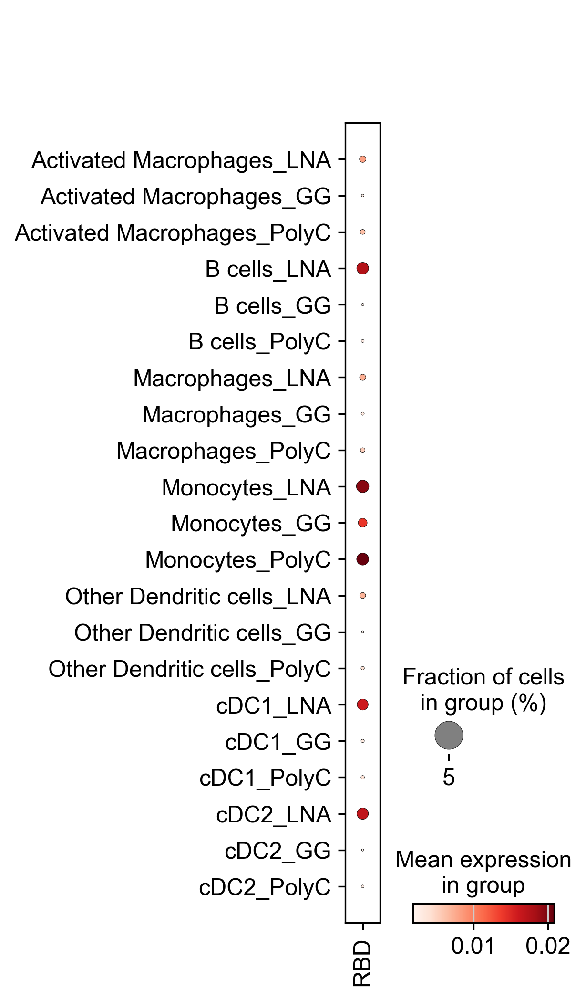

In [105]:
sc.pl.dotplot(pdata, 'RBD', groupby='type-condition', dot_max=.05)

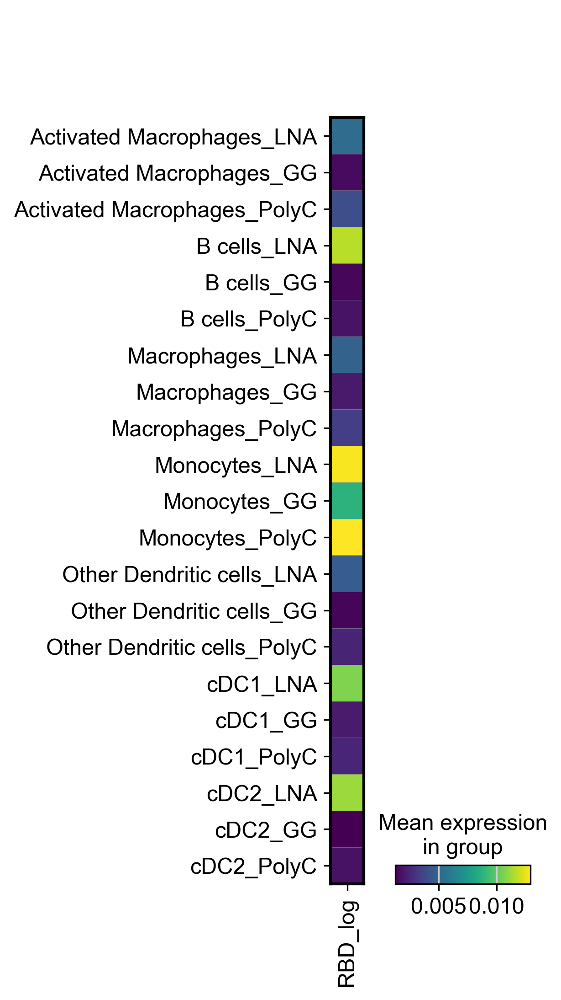

In [106]:
sc.pl.matrixplot(pdata, 'RBD_log', groupby='type-condition')

#### non-zero

In [97]:
rbd_df = rdata.obs.loc[rdata.obs['RBD'] != 0, :].copy()

In [98]:
rbd_df['level_1'].value_counts()

level_1
B cells              10688
Macrophages           4305
Dendritic cells       3877
NA                    2531
Endothelial cells     2040
NK cells              1493
T cells                350
Name: count, dtype: int64

In [107]:
rbd_df.groupby('condition')['level_2'].value_counts()

condition  level_2              
GG         B cells                   657
           Monocytes                 504
           Endothelial cells         299
           NA                        246
           cDC1                      197
           NK cells                  126
           Macrophages               113
           Other Dendritic cells      92
           T cells                    45
           cDC2                       39
           Activated Macrophages      22
           CD4+ T cells                6
           CD8+ T cells                2
LNA        B cells                  8922
           cDC1                     2072
           NA                       1927
           Endothelial cells        1213
           Monocytes                1179
           NK cells                 1139
           cDC2                      670
           Other Dendritic cells     279
           Macrophages               256
           T cells                   169
           Activated Mac

In [99]:
rbd_df['level_2'].value_counts()

level_2
B cells                  10688
Monocytes                 3656
cDC1                      2612
NA                        2531
Endothelial cells         2040
NK cells                  1493
cDC2                       793
Macrophages                479
Other Dendritic cells      472
T cells                    303
Activated Macrophages      170
CD4+ T cells                32
CD8+ T cells                15
Name: count, dtype: int64

In [100]:
rbd_df['APC'].value_counts()

APC
NA         21407
Non-APC     3731
APC          146
Name: count, dtype: int64

In [101]:
rbd_data = ad.AnnData(X=rbd_df['RBD'].values.reshape((rbd_df.shape[0], 1)), obs=rbd_df, var=pd.DataFrame(index=['RBD']))
rbd_data

AnnData object with n_obs × n_vars = 25284 × 1
    obs: 'sample', 'fov_id', 'volume', 'fov_x', 'fov_y', 'fov_z', 'seg_label', 'global_x', 'global_y', 'global_z', 'condition', 'replicate', 'unique_index', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'region', 'n_counts', 'n_genes', 'level_1', 'level_2', 'level_3', 'APC', 'RBD', 'RBD_log'

In [102]:
rbd_data.obs = rbd_data.obs.drop(columns='RBD')
sc.pp.log1p(rbd_data)

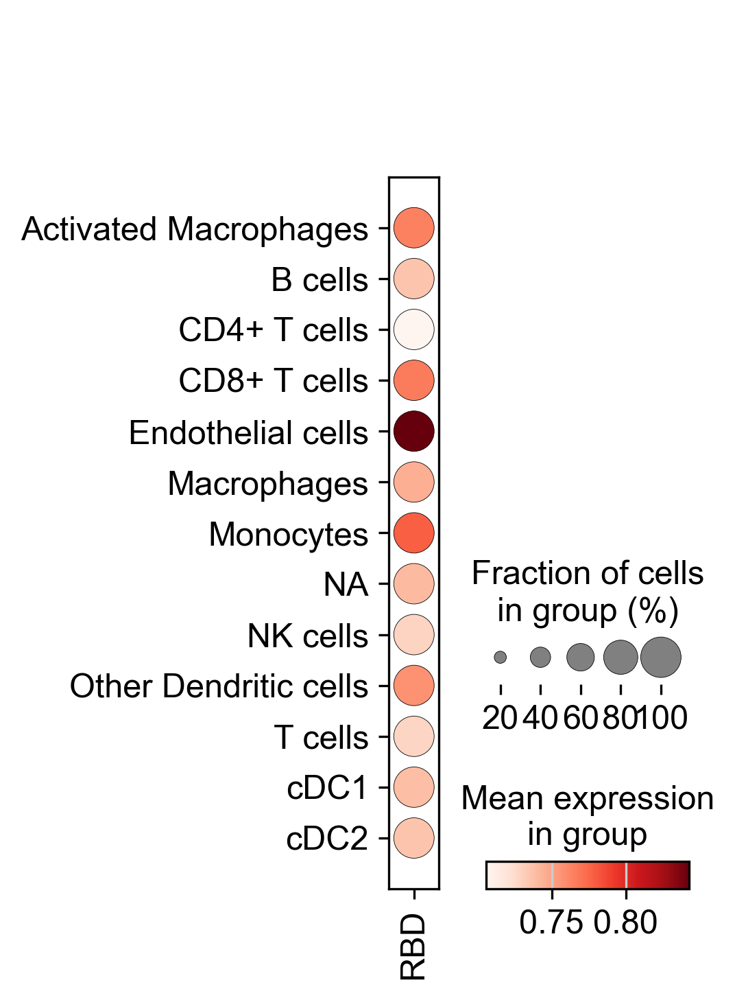

In [103]:
sc.pl.dotplot(rbd_data, var_names=rbd_data.var.index, groupby='level_2')

## Label modification

In [109]:
cdata = sc.read_h5ad(os.path.join(expr_path, f'2024-03-06-combined-level3-bk.h5ad'))
rdata = sc.read_h5ad(os.path.join(expr_path, f'2024-03-06-combined-level3-region23-bk.h5ad'))

In [110]:
rdata.obs['level_3'].cat.categories

Index(['Activated Macrophages', 'B cells', 'Bcl-2+ DN', 'CD4+ T cells',
       'CD8+ T cells', 'DN2', 'DN3', 'ETP', 'Exhausted T cells', 'Macrophages',
       'Monocytes', 'NA', 'Naive CD4+ T cells', 'Naive CD8+ T cells',
       'Other Dendritic cells', 'Th1', 'Th2', 'Th17', 'Treg',
       'Undefined T cells', 'cDC1', 'cDC2'],
      dtype='object')

In [112]:
l2_dict = {'Undefined T cells': 'T cells'}
l3_dict = {
    'Exhausted T cells': 'PD-1+ T cells',
    'Undefined T cells': 'T cells',
    'ETP': 'pro-T (Notch)',
    'DN2': 'pro-T (Kit)',
    'DN3': 'DN (TCRB+)',
    'Bcl-2+ DN': 'pro-T (Bcl-2+)'
}

In [113]:
cdata.obs['level_2'] = cdata.obs['level_2'].cat.rename_categories(l2_dict)
rdata.obs['level_2'] = rdata.obs['level_2'].cat.rename_categories(l2_dict)

cdata.obs['level_3'] = cdata.obs['level_3'].cat.rename_categories(l3_dict)
rdata.obs['level_3'] = rdata.obs['level_3'].cat.rename_categories(l3_dict)

In [114]:
rdata.obs['level_2'].cat.categories

Index(['Activated Macrophages', 'B cells', 'CD4+ T cells', 'CD8+ T cells',
       'Macrophages', 'Monocytes', 'NA', 'Other Dendritic cells',
       'Synthetic T cells', 'T cells', 'cDC1', 'cDC2'],
      dtype='object')

In [115]:
rdata.obs['level_3'].cat.categories

Index(['Activated Macrophages', 'B cells', 'pro-T (Bcl-2+)', 'CD4+ T cells',
       'CD8+ T cells', 'pro-T (Kit)', 'DN (TCRB+)', 'pro-T (Notch)',
       'PD-1+ T cells', 'Macrophages', 'Monocytes', 'NA', 'Naive CD4+ T cells',
       'Naive CD8+ T cells', 'Other Dendritic cells', 'Th1', 'Th2', 'Th17',
       'Treg', 'T cells', 'cDC1', 'cDC2'],
      dtype='object')

In [116]:
# backup
from datetime import datetime
date = datetime.today().strftime('%Y-%m-%d')
rdata.write_h5ad(f"{expr_path}/{date}-combined-level3-region23-bk.h5ad")
cdata.write_h5ad(f"{expr_path}/{date}-combined-level3-bk.h5ad")

## Test

In [ ]:
for i in range(len(adata_list)):
    print(adata_list[i].obs['sample'].unique())

    sq.gr.spatial_neighbors(adata_list[i], coord_type="generic", delaunay=True, percentile=99)
    sq.gr.nhood_enrichment(adata_list[i], cluster_key="level_2")
    sq.pl.nhood_enrichment(
        adata_list[i], cluster_key="level_2", method="single", cmap="inferno", vmin=-50, vmax=100
    )

In [ ]:
dist = adata_list[5].obsp['spatial_distances'].data
nf_log = ~np.isfinite(dist)
dist[nf_log]

In [ ]:
~np.isfinite(adata_list[5].obsp['spatial_distances'].data)

In [ ]:
for i in range(len(adata_list)):
    print(np.percentile(adata_list[i].obsp['spatial_distances'].data, 99))

In [ ]:
for i in range(len(adata_list_3d)):
    print(np.percentile(adata_list_3d[i].obsp['spatial_distances'].data, 90))

In [ ]:
sns.histplot(viz_adata.obsp['spatial_distances'].data)

In [ ]:
viz_adata = adata_list[5].copy()
viz_adata = viz_adata[(viz_adata.obs['global_x'].isin(range(5000, 10000))) & (viz_adata.obs['global_y'].isin(range(5000, 10000))), :]

# sq.gr.spatial_neighbors(viz_adata, coord_type="generic", delaunay=True)
sq.pl.spatial_scatter(
    viz_adata,
    color="level_2",
    # groups=[
    #     "Dendritic cells",
    #     "T cells",
    # ],
    shape=None,
    size=2,
    palette='tab10',
    figsize=(24, 12),
    connectivity_key='spatial_connectivities',
)